In [20]:
from sharpness.transforms import GaussianNoise
from sharpness.exp_utilities import apply_transforms, compare_images
from sharpness.dataloader import load_data
from typing import Optional
import matplotlib as mpl
import matplotlib.pyplot as plt

In [21]:
##### EXPERIMENTS #####

### Choose which experiment(s) to perform

# This experiment uses a single image, and applies one type of transformation with a
# range of parameters
EXP_TRANSFORMATIONS = False

#
EXP_CALIBRATION = False

# EXPERIMENTS FOR PAPER

# Case study - GREMLIN
# Use this for Figures 4,5,6,10 of paper 
EXP_GREMLIN_with_CALIBRATION = True

# Case study:  GraphCast
# Use this for Figures 7,8,9 of paper
EXP_GraphCast_GFS_with_CALIBRATION = True

# Use this for Figures 11, 12 of paper
EXP_change_location_intensity_transition = True

In [22]:
# Define global parameters for plotting - these are mostly hacks to finetune figures
# specifically for the paper

### Choose where to put results
my_outdir = "../media/paper_figures/"

# Paramter for whether to plot values of min, mean, max at the bottom of each heatmap
# Default is to NOT print them, as it makes figures too busy for publications.
WANT_min_max_caption = False

# The following applies to heatmaps and stats plots.
# Determines whether to include plot for "intensity" in heatmaps and stats_plots.
PLOTS_WITH_INTENSITY = True

# This is a hack to format the descriptors of experiments in different ways.
# Choose False to get longer titles on heatmaps.
# Choose True to get short tick marks in stats_plots.
USE_LABELS_SHORTENED_FOR_STATS_PLOTS = True

# For stats plots:  To get GBE plots, choose True.  To get RMV plots, choose False.
WANT_COMPARISON_IN_STATS_PLOTS = True

In [23]:
# Pre-define common choices of metrics

# Large set of metrics
# Note:  this is the set of keys for "metrics_f"
metric_set_large = [
    "rmse",  # Root mean square error
    "ssim",  #: ssim,
    "tv",  #: total_variation,
    "grad-mag",  #: mean_gradient_magnitude,
    "grad-tv",  #: grad_total_variation,
    "grad-rmse",  #: gradient_rmse,
    "laplace-rmse",  #: laplacian_rmse,
    "fourier-rmse",  #: fourier_rmse,
    "fourier-tv",  #: fourier_total_variation,
    "spec-slope",  #: spec_slope,
    "s1",  #: spec-slope with cut-off
    "wavelet-tv",  #: wavelet_total_variation
]

# Medium set of metrics
metric_set_medium = [
    "grad-mag",
    "spec-slope",
    "tv",
    "grad-tv",
    "fourier-tv",
    "wavelet-tv",
]

# Very small set of metrics, if we just want a few results.  Often used for testing, or
# illustration.
metric_set_small = [
    "grad-mag",  #: mean_gradient_magnitude,
    "grad-rmse",  #: gradient_rmse,
]

# If we want more detailed results, look at individual groups.
# Metrics by group: 1) accuracy/similarity,  2) gradient-based,  3) spectral
# There are loops in the code that use Groups 1, 2, 3 sequentially and save results
# separately for each group.

# Group 1:  accuracy / similarity
metrics_group_1 = [
    "rmse",  # Root mean square error
    "ssim",  #: ssim,
]

# Group 2:  gradient-based
metrics_group_2 = [
    "tv",  #: total_variation,
    "grad-mag",  #: mean_gradient_magnitude,
    "grad-tv",  #: grad_total_variation,
    "grad-rmse",  #: gradient_rmse,
    "laplace-rmse",  #: laplacian_rmse,
]

# Group 3: spectral based (in Fourier or wavelet space)
metrics_group_3 = [
    "fourier-rmse",  #: fourier_rmse,
    "fourier-tv",  #: fourier_total_variation,
    "spec-slope",  #: spec_slope,
    "s1",  #: spec-slope with cut-off
    "wavelet-tv",  #: wavelet_total_variation
]


################################################################
### Define colors and color maps for heatmaps of all metrics ###
################################################################
# Gray: intensity
# Blue: uni-variate
# Red:  bi-variate

# ssim is reverse because higher values imply more similarity (better), in contrast to
# all other bi-variate metrics.
# Choose colors for heatmaps of different metrics
metric_color = {
    "intensity": "gray",
    "rmse": "Reds",
    "ssim": "Reds_r",
    "tv": "Blues",
    "grad-mag": "Blues",
    "grad-tv": "Blues",
    "grad-rmse": "Reds",
    "laplace-rmse": "Reds",
    "fourier-rmse": "Reds",
    "fourier-tv": "Blues",
    "spec-slope": "Blues",
    "s1": "Blues",
    "wavelet-tv": "Blues",
}

# Define corresponding color maps
color_map_code = {
    "gray": "gray",
    "red": "Reds",
    "reverse_red": "Reds_r",
    "blue": "Blues",
    "green": "Greens",
}

# Use for given metric:
# my_color = metric_color(metric)
# my_cmap = color_map_code[my_color]

In [24]:
def compare_images_full_protocol(
    img_dict,
    outdir,
    filename_prefix,
    format="IMAGES_NO_RELATION_SPECIFIED",
    bigger_plots=False,
    include_intensity_plot=True,
    parameter_description="",
    plot_heatmaps=True,
    comparison_results=None,
):

    combined_dict = {}

    # Use the three sets of metrics groups instead of selected_metrics
    # Note: THIS IGNORES the variable selected_metrics provided in the function call.
    for count, my_selected_metrics in enumerate(
        [metrics_group_1, metrics_group_2, metrics_group_3]
    ):

        filename_prefix_appended = f"{filename_prefix}_group_{count+1}"
        results = compare_images(
            img_dict,
            my_selected_metrics,
            outdir,
            filename_prefix_appended,
            format=format,
            bigger_summary_plots=bigger_plots,
            include_intensity_summary_plot=include_intensity_plot,
            parameter_description=parameter_description,
            plot_heatmaps=plot_heatmaps,
            heatmap_metric_cmap_codes=metric_color,
            comparison_results=comparison_results,
        )

        combined_dict = {**combined_dict, **results}

    return combined_dict

In [25]:
########################################################
# Prepare collection of images to use
########################################################

# Import low level functions:
from sharpness.dataloader import *
from sharpness.transforms import *

# A few global parameters
color_map_input_image = "gray"


def prepare_set_of_base_images():

    ############ A) LOAD OBSERVED IMAGES ############
    # Sample satellite image
    file_name_satellite = "../data/kh_ABI_C13.nc"
    # Corresponding radar image
    file_name_radar = "../data/kh_MRMS_REFC.nc"
    # Corresponding CNN estimate of radar (using satellite image as input)
    file_name_radar_CNN = "../data/kh_GREMLIN_REFC.nc"

    i_sample = 0  # Choose any sample
    img_satellite = load_data(file_name_satellite, i_sample)
    img_RADAR = load_data(file_name_radar, i_sample)
    img_RADAR_CNN = load_data(file_name_radar_CNN, i_sample)

    ############ B) CREATE SYNTHETIC IMAGES ###########

    ############ Blank image
    n_pixels = 256
    img_blank = np.zeros([n_pixels, n_pixels])

    ############ Pure noise image
    n_pixels = 256
    img_noise = np.random.rand(n_pixels, n_pixels)

    ############ Gaussian blobs
    # Create six Gaussian blobs with exponentially increasing sigma values - to test the
    # effect of varying sigma
    # n_pixels=256
    center_x = 210
    center_y = 50
    sigma = 1
    img1 = gaussian_blob(n_pixels, center_x, center_y, sigma)
    center_x = 210
    center_y = 80
    sigma = 2
    img2 = gaussian_blob(n_pixels, center_x, center_y, sigma)
    center_x = 210
    center_y = 120
    sigma = 4
    img3 = gaussian_blob(n_pixels, center_x, center_y, sigma)
    center_x = 210
    center_y = 180
    sigma = 8
    img4 = gaussian_blob(n_pixels, center_x, center_y, sigma)
    center_x = 100
    center_y = 50
    sigma = 16
    img5 = gaussian_blob(n_pixels, center_x, center_y, sigma)
    center_x = 100
    center_y = 170
    sigma = 32
    img6 = gaussian_blob(n_pixels, center_x, center_y, sigma)
    # final image
    img_synthetic_Gaussian = img1 + img2 + img3 + img4 + img5 + img6

    ############ Sinusoidal grating - to test the effect of gentle transitions
    # n_pixels=256
    wave_length_in_pixels = 50
    alpha_in_degrees = 20
    # final image
    img_synthetic_sinusoidal = sinusoidal_grating(
        n_pixels, wave_length_in_pixels, alpha_in_degrees
    )

    ############ Single, narrow ridge - to test effect of sharp edges
    # n_pixels = 256
    fraction = fraction = 0.52
    img_1 = black_white(n_pixels, fraction)
    fraction = fraction = 0.48
    img_2 = black_white(n_pixels, fraction)
    # final image
    img_synthetic_ridge = img_2 - img_1

    ############ XOR fractal - contains lots of areas with different "texture"
    # n_pixels=256
    img_synthetic_fractal = xor_fractal(n_pixels)

    # store all images and corresponding text in dictionary to be returned
    image_collection_dict = {
        "satellite": (img_satellite, "Satellite"),
        "radar_OBS": (img_RADAR, "Radar OBS"),
        "radar_NN": (img_RADAR_CNN, "Radar NN"),
        "gaussian": (img_synthetic_Gaussian, "Gaussian blobs"),
        "sinusoidal": (img_synthetic_sinusoidal, "Sinusoidal"),
        "ridge": (img_synthetic_ridge, "Single line"),
        "fractal": (img_synthetic_fractal, "Fractal"),
        "blank": (img_blank, "Blank"),
        "noise": (img_noise, "Pure noise"),
    }

    # print all images in collection we created
    for img_counter, (key, (img, img_text)) in enumerate(image_collection_dict.items()):
        plt.figure(img_counter)
        plt.imshow(img, cmap=color_map_input_image, origin="lower")
        plt.title(img_text)
        plt.xlabel(
            f"Min: {img.min():.3f}     Mean: {img.mean():.3f}     Max: {img.max():.3f} "
        )
        # plt.invert_yaxis()
        plt.show()

    return image_collection_dict

In [26]:
def synthetic_cylinder_with_ramp_down(n_pixels, center_x, center_y, height, R1, alpha):
    """Cylinder of height height, radius R1, and ramp down at slope (-alpha)"""

    R2 = R1 + height / alpha

    data = np.zeros((n_pixels, n_pixels))
    # alpha = height / ( R2 - R1 )
    for i in range(n_pixels):
        for j in range(n_pixels):
            r = np.sqrt(
                (i - center_x) * (i - center_x) + (j - center_y) * (j - center_y)
            )  # distance from center
            if r <= R1:
                data[j, i] = height
            elif r <= R2:
                data[j, i] = height - alpha * (r - R1)
            else:
                data[j, i] = 0
    return data

In [27]:
def fetch_base_image(
    image_collection_dict: Optional[dict] = None,
    ORIGINAL_IMAGE: str = "noise",
    i_sample: int = 0,
):
    """Helper routine to fetch initial image from transformed dataset"""

    if ORIGINAL_IMAGE in [
        "satellite",
        "radar_OBS",
        "radar_NN",
        "gaussian",
        "sinusoidal",
        "ridge",
        "fractal",
        "blank",
        "noise",
    ]:
        (img1, img1_string) = image_collection_dict[ORIGINAL_IMAGE]

    elif ORIGINAL_IMAGE == "GREMLIN":
        img1 = load_data("../data/kh_ABI_C13.nc", i_sample)
        img1_string = f"ABI_Sample_{i_sample}"

    else:
        print("image_transformation called with invalid string for ORIGINAL_IMAGE")

    return img1, img1_string

In [28]:
def image_transformation_experiment(
    img1,
    img1_string,
    TRANSFORMATION_TYPE="Blur_Image_gradually",
    parameter_max=1.0,
    comparison_results=None,
):

    ############ Prepare series of transformations to apply ############
    parameter_step = parameter_max / 5.0  # Divide overall range into 20 steps
    parameter_start = (
        parameter_step  # skip zero for transformations, since that's the original
    )
    parameter_end = (
        parameter_max + parameter_step
    )  # go up to and including parameter_max
    my_parameter_values = np.arange(parameter_start, parameter_end, parameter_step)

    if TRANSFORMATION_TYPE == "Add_Noise_gradually":
        experiment_name = "EXP_adding_noise_gradually_starting_with"
        my_transform = GaussianNoise
        parameter_description = "noise"
        transform_name_for_plotting = "Noise"  # Name for image labels
        # transform_name_for_label = 'Noise (sigma)'

    elif TRANSFORMATION_TYPE == "Blur_Image_gradually":
        experiment_name = "EXP_blurring_gradually_starting_with"
        my_transform = GaussianBlur
        parameter_description = "sigma"
        transform_name_for_plotting = "Blur"  # Name for image labels
        # transform_name_for_label = 'Blur (sigma)'

    else:
        print("image_transformation called with invalid string for TRANSFORMATION")

    ### Parameters for transformations now defined ###

    ############ Create the transformations based on above parameters ############
    transform_list = []
    parameter_list = []
    label_list = []

    # label_list_for_heatmaps = []
    # label_list_for_stats_plots = []

    for my_parameter in my_parameter_values:
        transform_list.append(my_transform)
        parameter_list.append({"rate": 1.0, parameter_description: my_parameter})

        # Default:      Create label of form "Noise: 0.2" - which is typically used for
        # heatmaps.
        my_string = f"{transform_name_for_plotting}: {my_parameter:.2f}"

        # Alternative:  Create shorter label of form "0.2" - which is typically used for
        # stats_plots.
        if USE_LABELS_SHORTENED_FOR_STATS_PLOTS:
            my_string = f"{my_parameter:.1f}"
        label_list.append(my_string)

    img_dict = apply_transforms(
        img1, transform_list, parameter_list, label_list, img1_string
    )

    ############ Compare images ############
    format = "IMAGES_NO_RELATION_SPECIFIED"
    filename_start = f"{experiment_name}_{img1_string}"

    results = compare_images_full_protocol(
        img_dict,
        my_outdir,
        filename_start,
        format=format,
        parameter_description=parameter_description,
        comparison_results=comparison_results,
    )

    return results, img_dict

In [29]:
def image_transformation_experiment_w_fetch_base_image(
    image_collection_dict,
    ORIGINAL_IMAGE="noise",
    i_sample=0,
    TRANSFORMATION_TYPE="Blur_Image_gradually",
    parameter_max=1.0,
    comparison_results=None,
):

    # get predefined image
    img1, img1_string = fetch_base_image(
        image_collection_dict, ORIGINAL_IMAGE, i_sample
    )

    # start transformations
    results, img_dict = image_transformation_experiment(
        img1,
        img1_string,
        TRANSFORMATION_TYPE=TRANSFORMATION_TYPE,
        parameter_max=parameter_max,
        comparison_results=comparison_results,
    )
    return results, img_dict

In [30]:
### Compare two images, including blurring and noise experiments.


def compare_two_images_with_blur_and_noise_experiment(
    image1,
    image1_string,
    image2,
    image2_string,
    experiment_name=None,
):

    comparison_dict = {
        image1_string: image1,
        image2_string: image2,
    }

    format = "IMAGES_NO_RELATION_SPECIFIED"
    filename_start = f"{experiment_name}_{image1_string}_vs_{image2_string}"
    img1_img2_results = compare_images_full_protocol(
        comparison_dict,
        my_outdir,
        filename_start,
        format=format,
    )

    img2_results = {}
    for key, value in img1_img2_results.items():
        img2_results[key] = value[:, 1:]

    results = image_transformation_experiment(
        img1=image1,
        img1_string=image1_string,
        TRANSFORMATION_TYPE="Blur_Image_gradually",
        parameter_max=10.0,
        comparison_results=img2_results,
    )
    results = image_transformation_experiment(
        img1=image1,
        img1_string=image1_string,
        TRANSFORMATION_TYPE="Add_Noise_gradually",
        parameter_max=1.0,
    )

    # return comparison_metric_results, comparison_dict

In [31]:

##########################
##########################

### Start of experiments ###

##########################
##########################


Loading data from ../data/kh_ABI_C13.nc (sample 0)
Loading data from ../data/kh_MRMS_REFC.nc (sample 0)
Loading data from ../data/kh_GREMLIN_REFC.nc (sample 0)


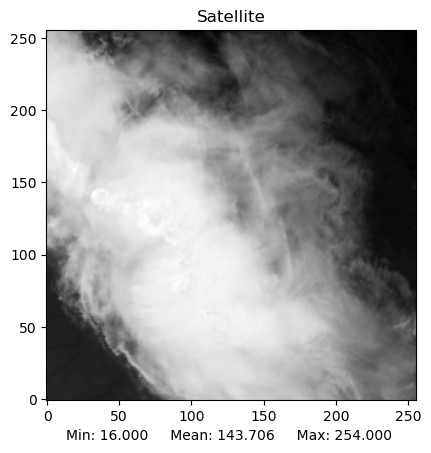

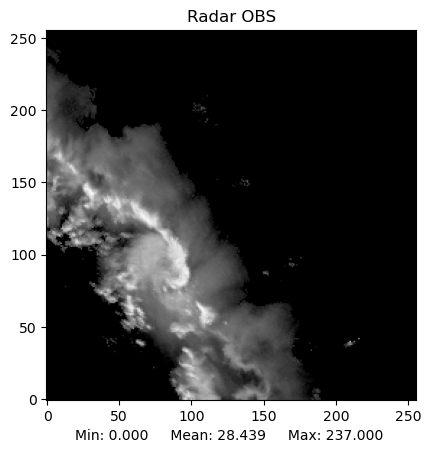

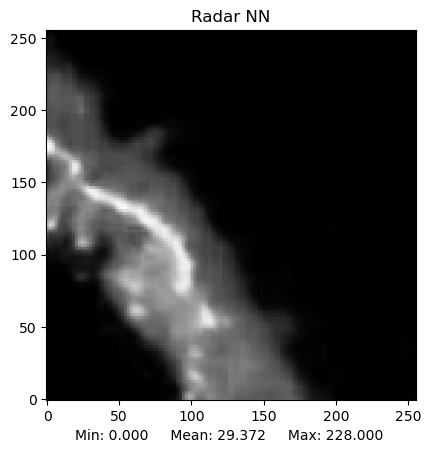

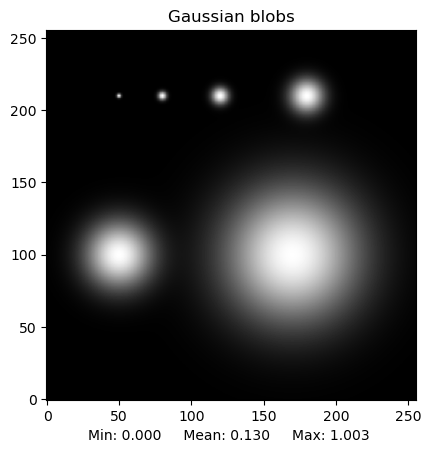

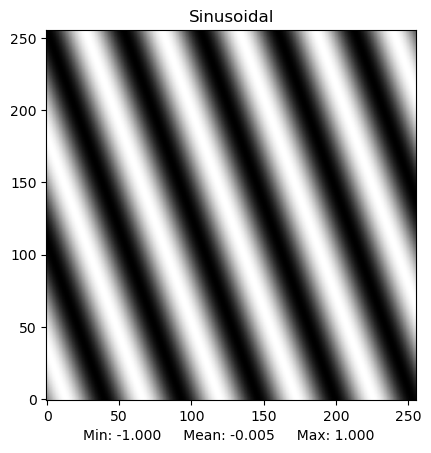

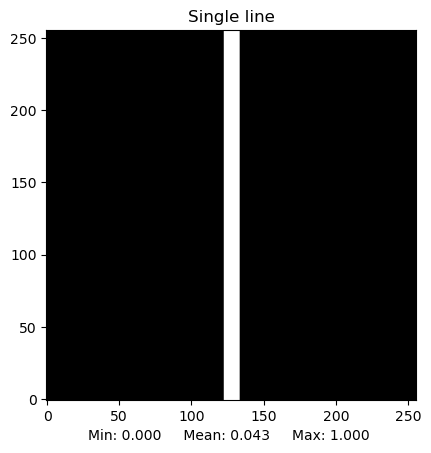

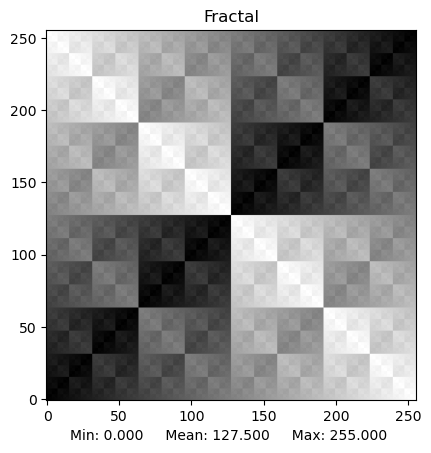

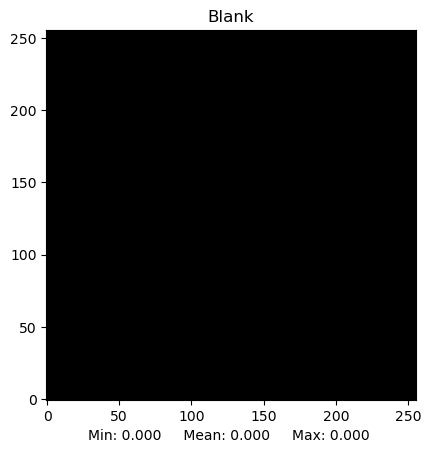

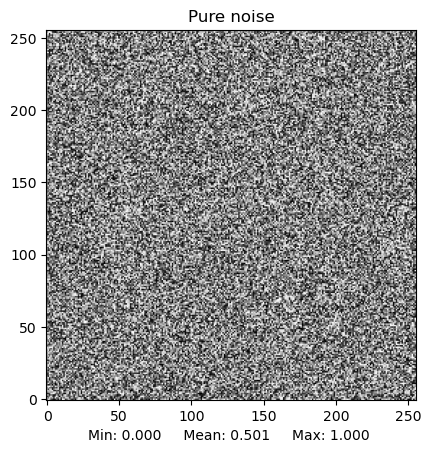

In [32]:
# Initialization

# Generate/read sample images to use
image_collection_dict = prepare_set_of_base_images( )

Loading data from ../data/kh_MRMS_REFC.nc (sample 0)
Loading data from ../data/kh_GREMLIN_REFC.nc (sample 0)
Computing heatmaps for rmse, ssim
on Observation, Estimate

##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.02760055847465992 seconds

Computing ssim
Done! 2 inputs took 0.40201202034950256 seconds

##############################

Plotting figure...



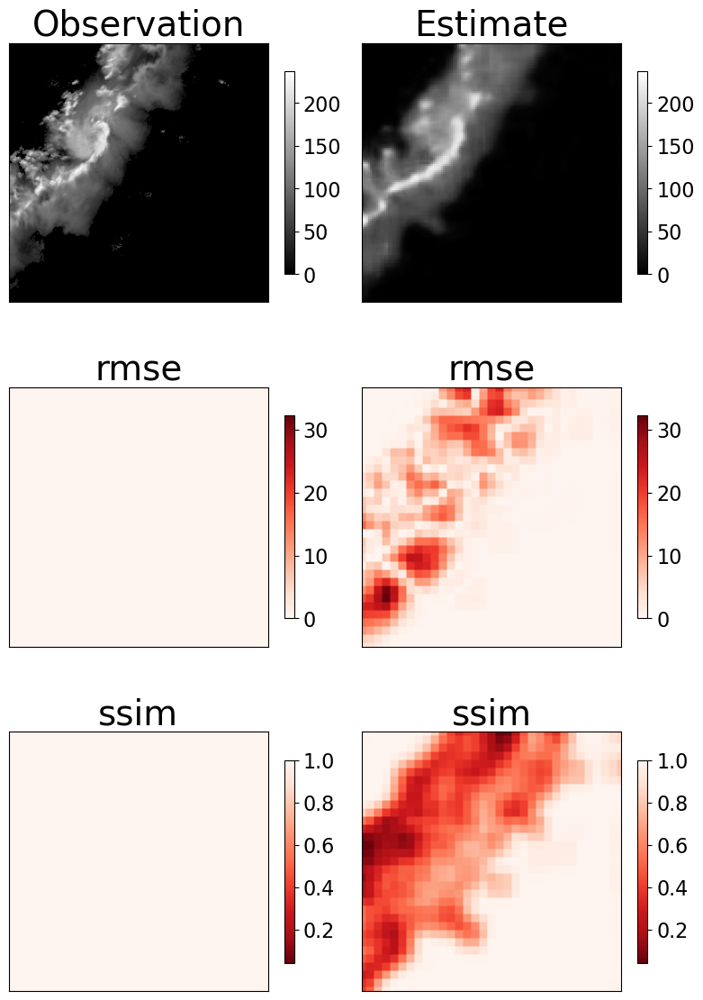


Saving results to ../media/paper_figures/Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_1_heatmaps.pdf
Writing summary statistics to file Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_1_stats_summary.txt
This file is:  Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	Estimate    : 0.00

intensity - mean:
	Observation : 28.44
	Estimate    : 29.37

intensity - max:
	Observation : 237.00
	Estimate    : 228.00

##### rmse #####

rmse - min:
	Observation : 0.00
	Estimate    : 0.00

rmse - mean:
	Observation : 0.00
	Estimate    : 3.64

rmse - max:
	Observation : 0.00
	Estimate    : 32.18

##### ssim #####

ssim - min:
	Observation : 1.00
	Estimate    : 0.04

ssim - mean:
	Observation : 1.00
	Estimate    : 0.74

ssim - max:
	Observation : 1.00
	Estimate    : 1.00



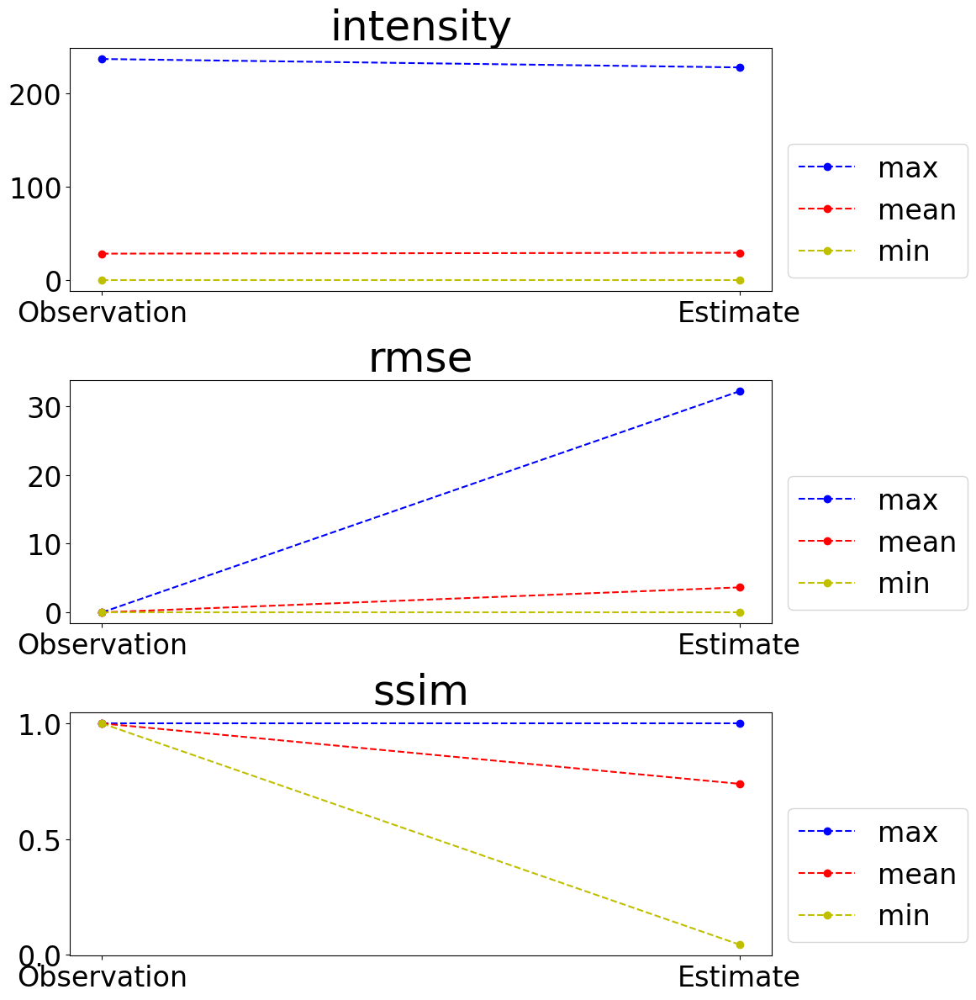

Saving results to Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on Observation, Estimate

##############################

Computing tv
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.07548206485807896 seconds

Computing grad-mag
Done! 2 inputs took 0.12993528507649899 seconds

Computing grad-tv
Done! 2 inputs took 0.12252766266465187 seconds

Computing grad-rmse
Done! 2 inputs took 0.1408660002052784 seconds

Computing laplace-rmse
Done! 2 inputs took 0.06790157034993172 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

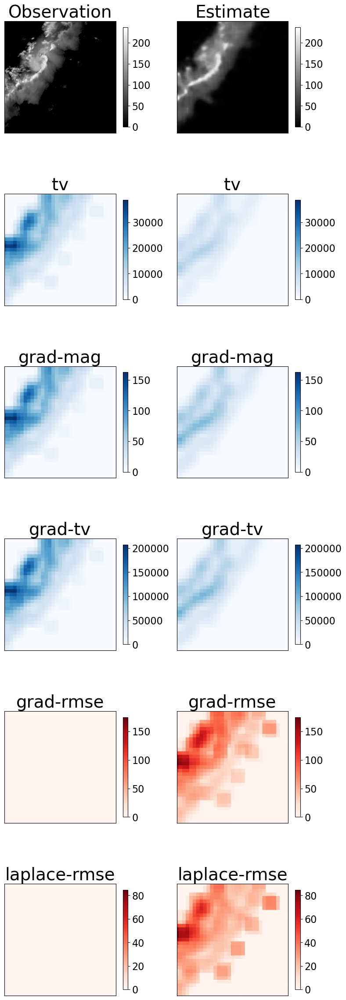


Saving results to ../media/paper_figures/Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_2_heatmaps.pdf
Writing summary statistics to file Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_2_stats_summary.txt
This file is:  Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	Estimate    : 0.00

intensity - mean:
	Observation : 28.44
	Estimate    : 29.37

intensity - max:
	Observation : 237.00
	Estimate    : 228.00

##### tv #####

tv - min:
	Observation : 0.00
	Estimate    : 0.00

tv - mean:
	Observation : 5566.31
	Estimate    : 2287.69

tv - max:
	Observation : 38733.00
	Estimate    : 12695.00

##### grad-mag #####

grad-mag - min:
	Observation : 0.00
	Estimate    : 0.00

grad-mag - mean:
	Observation : 24.75
	Estimate    : 14.12

grad-mag - max:
	Observation : 162.35
	Estimate    : 77.55

##### grad-tv #####

grad-tv - min:
	Observation : 0.00
	Estimate    : 0.00

grad-tv - 

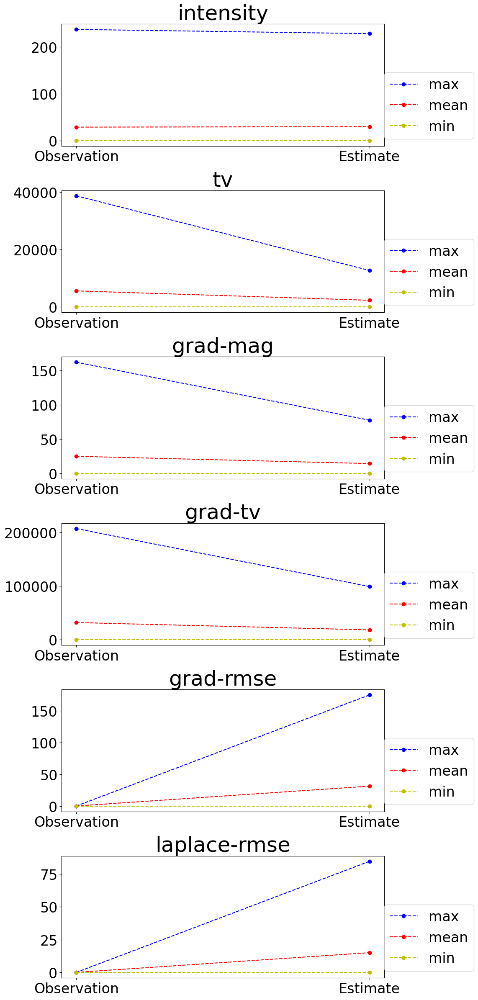

Saving results to Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on Observation, Estimate

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.26256711408495903 seconds

Computing fourier-tv
Done! 2 inputs took 0.24427139200270176 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
28464 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
12608 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 3.35248713940382 seconds

Computing s1
NaNs encountered in s1:
28464 NaNs out of 65536 total blocks in image 0
28464 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
28464 NaNs out of 65536 total blocks in image 0
35056 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 1.9021332822740078 seconds

Computing wavelet-tv
Done! 2 inputs took 0.41174027137458324 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

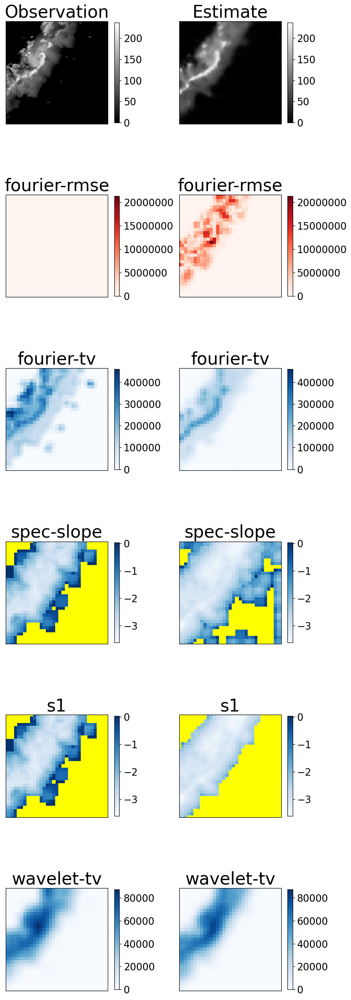


Saving results to ../media/paper_figures/Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_3_heatmaps.pdf
Writing summary statistics to file Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_3_stats_summary.txt
This file is:  Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	Estimate    : 0.00

intensity - mean:
	Observation : 28.44
	Estimate    : 29.37

intensity - max:
	Observation : 237.00
	Estimate    : 228.00

##### fourier-rmse #####

fourier-rmse - min:
	Observation : 0.00
	Estimate    : 0.00

fourier-rmse - mean:
	Observation : 0.00
	Estimate    : 1690763.72

fourier-rmse - max:
	Observation : 0.00
	Estimate    : 21329062.56

##### fourier-tv #####

fourier-tv - min:
	Observation : 0.00
	Estimate    : 0.00

fourier-tv - mean:
	Observation : 76638.12
	Estimate    : 45441.50

fourier-tv - max:
	Observation : 459219.67
	Estimate    : 305096.28

##### spec-slope #####

spe

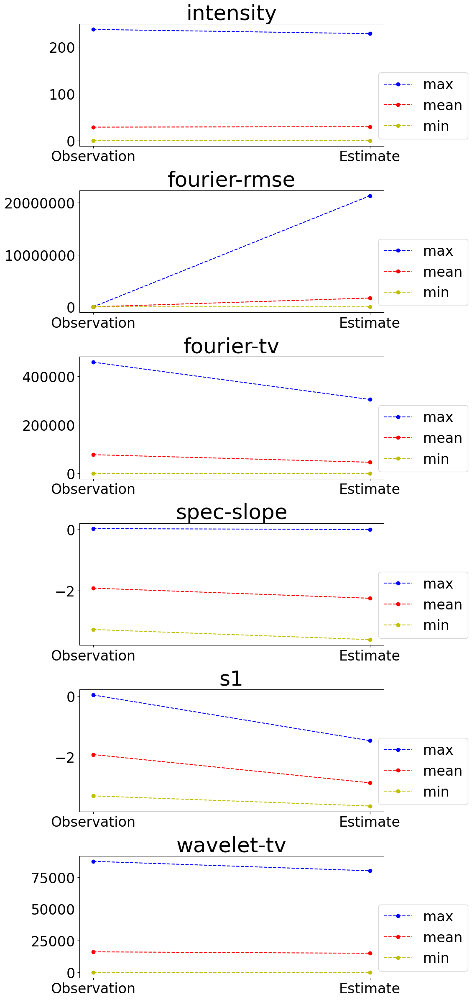

Saving results to Exp_GREMLIN_with_CALIBRATION_Observation_vs_Estimate_group_3_stats_plots.pdf
Computing transforms...


100%|██████████| 5/5 [00:00<00:00, 272.66it/s]

Computing heatmaps for rmse, ssim
on Observation, 2.0, 4.0, 6.0, 8.0, 10.0



##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.0811392143368721 seconds

Computing ssim
Done! 6 inputs took 1.223944403231144 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

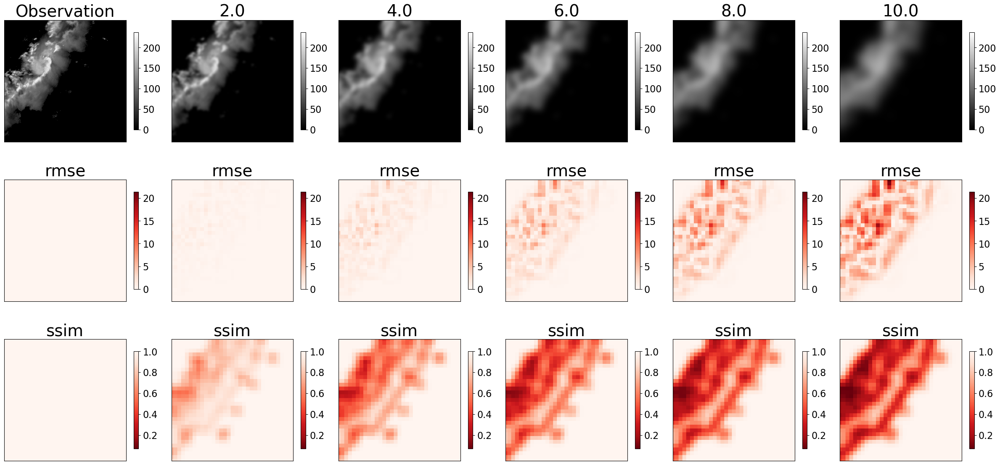


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_Observation_group_1_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_Observation_group_1_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_Observation_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	Observation : 28.44
	2.0         : 28.44
	4.0         : 28.44
	6.0         : 28.44
	8.0         : 28.44
	10.0        : 28.44

intensity - max:
	Observation : 237.00
	2.0         : 203.59
	4.0         : 185.90
	6.0         : 170.71
	8.0         : 162.41
	10.0        : 156.68

##### rmse #####

rmse - min:
	Observation : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

rmse - mean:
	Observation : 0.00
	2.0         : 0.15
	4.0         : 0.52
	6.0  

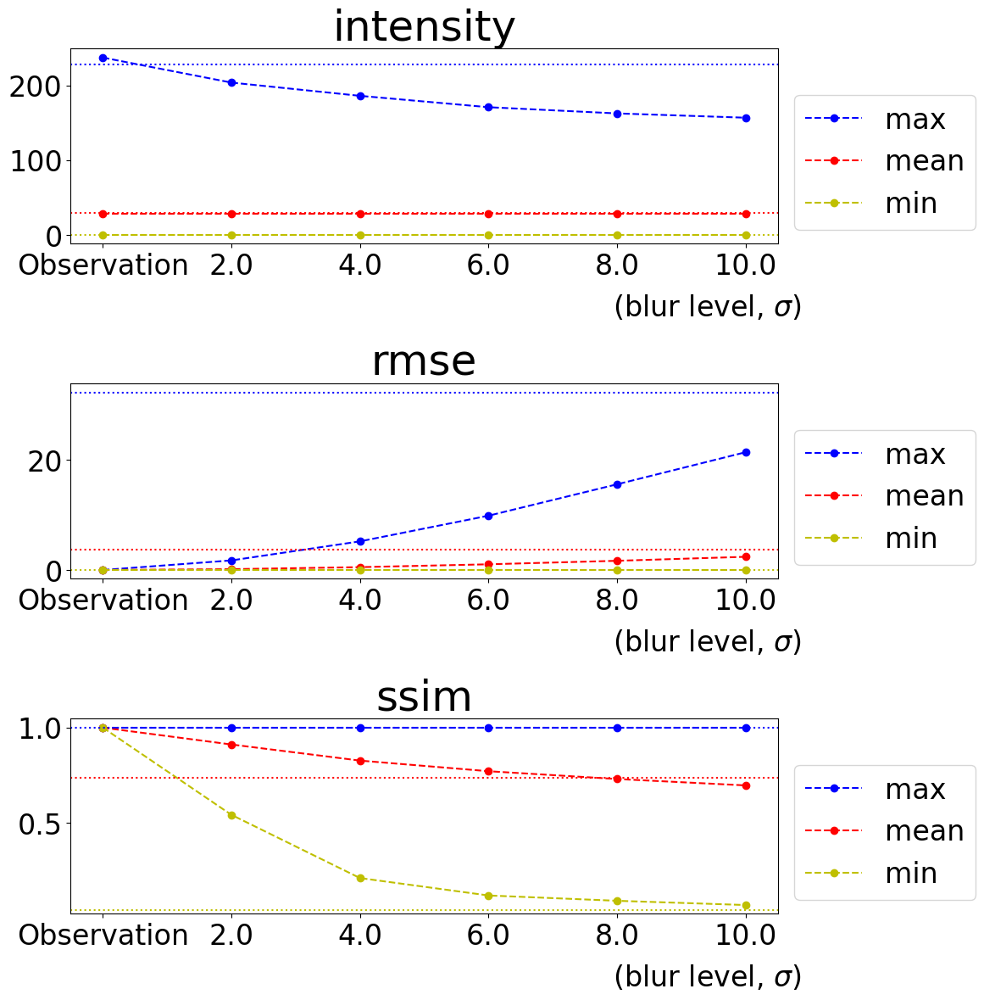

Saving results to EXP_blurring_gradually_starting_with_Observation_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on Observation, 2.0, 4.0, 6.0, 8.0, 10.0

##############################

Computing tv
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.22502305172383785 seconds

Computing grad-mag
Done! 6 inputs took 0.38939443603157997 seconds

Computing grad-tv
Done! 6 inputs took 0.35712118446826935 seconds

Computing grad-rmse
Done! 6 inputs took 0.35226315073668957 seco

<Figure size 640x480 with 0 Axes>

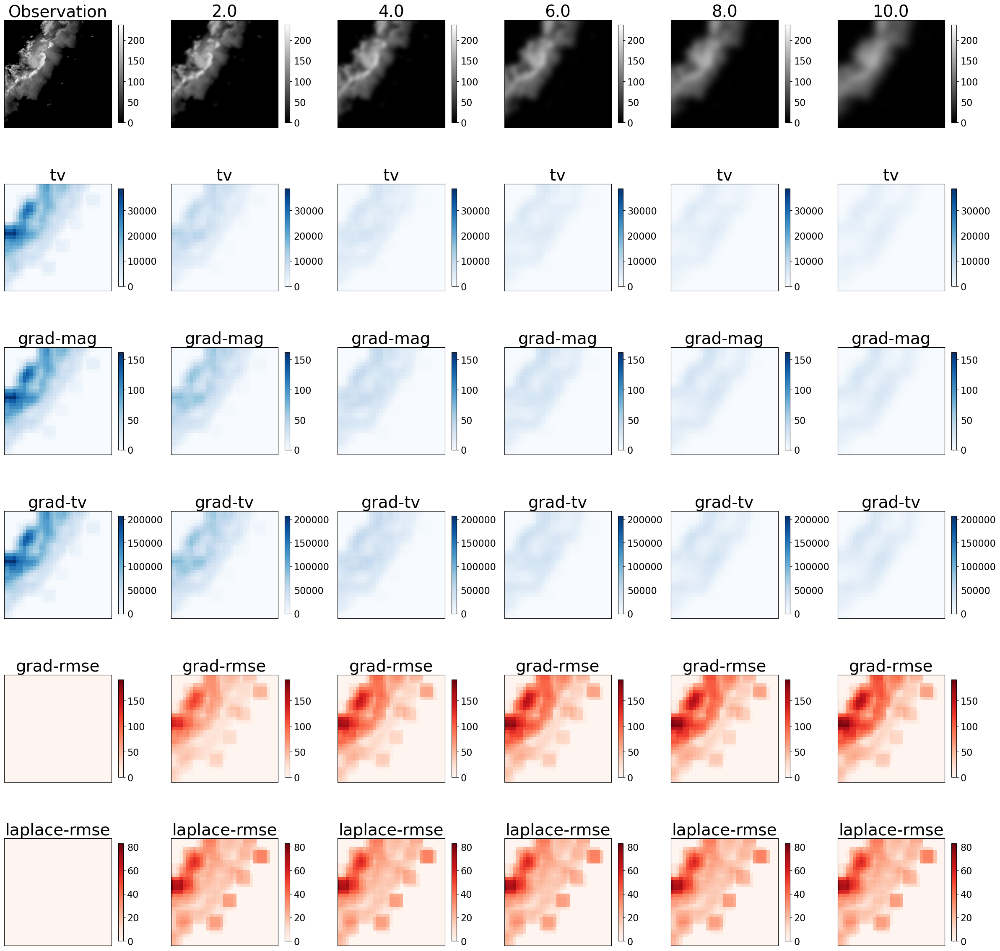


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_Observation_group_2_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_Observation_group_2_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_Observation_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	Observation : 28.44
	2.0         : 28.44
	4.0         : 28.44
	6.0         : 28.44
	8.0         : 28.44
	10.0        : 28.44

intensity - max:
	Observation : 237.00
	2.0         : 203.59
	4.0         : 185.90
	6.0         : 170.71
	8.0         : 162.41
	10.0        : 156.68

##### tv #####

tv - min:
	Observation : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

tv - mean:
	Observation : 5566.31
	2.0         : 2512.36
	4.0         : 1762.83
	6.

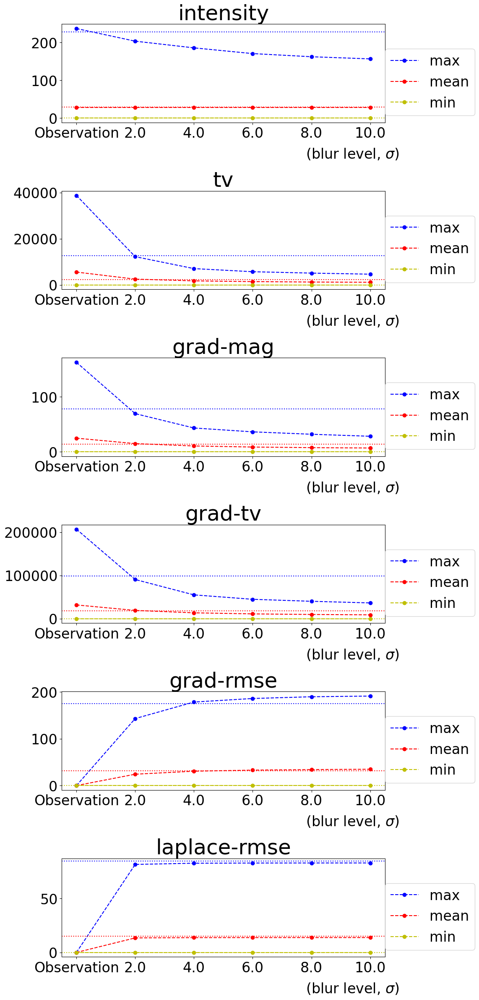

Saving results to EXP_blurring_gradually_starting_with_Observation_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on Observation, 2.0, 4.0, 6.0, 8.0, 10.0

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.7830858640372753 seconds

Computing fourier-tv
Done! 6 inputs took 0.7384129166603088 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
28464 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
22864 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
17872 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
13360 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
10832 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
8784 NaNs out of 65536 total blocks in image 1
Done! 6 inputs took 9.954241670668125 seconds

Computing s1
NaNs encountered in s1:
28464 NaNs out of 65536 total blocks in image 0
28464 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
28464 NaNs out of 65536 total

<Figure size 640x480 with 0 Axes>

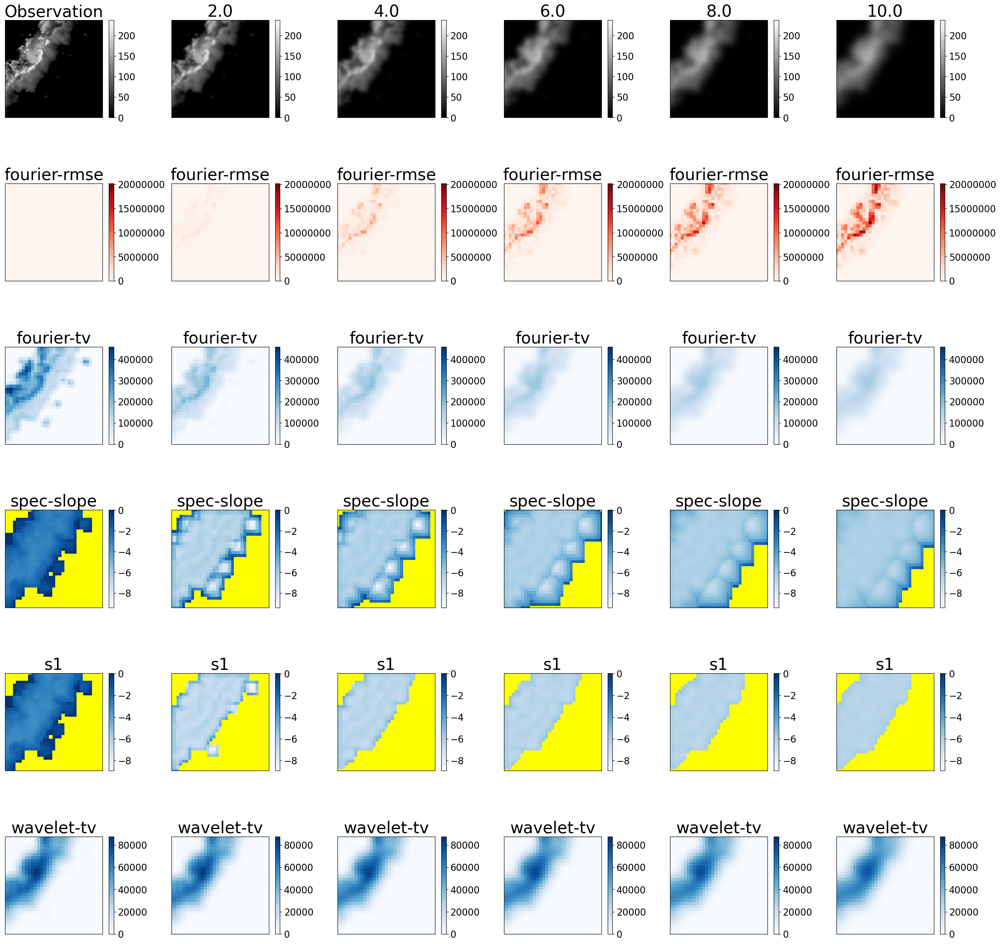


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_Observation_group_3_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_Observation_group_3_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_Observation_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	Observation : 28.44
	2.0         : 28.44
	4.0         : 28.44
	6.0         : 28.44
	8.0         : 28.44
	10.0        : 28.44

intensity - max:
	Observation : 237.00
	2.0         : 203.59
	4.0         : 185.90
	6.0         : 170.71
	8.0         : 162.41
	10.0        : 156.68

##### fourier-rmse #####

fourier-rmse - min:
	Observation : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

fourier-rmse - mean:
	Observation : 0.00
	2.0         : 154112.

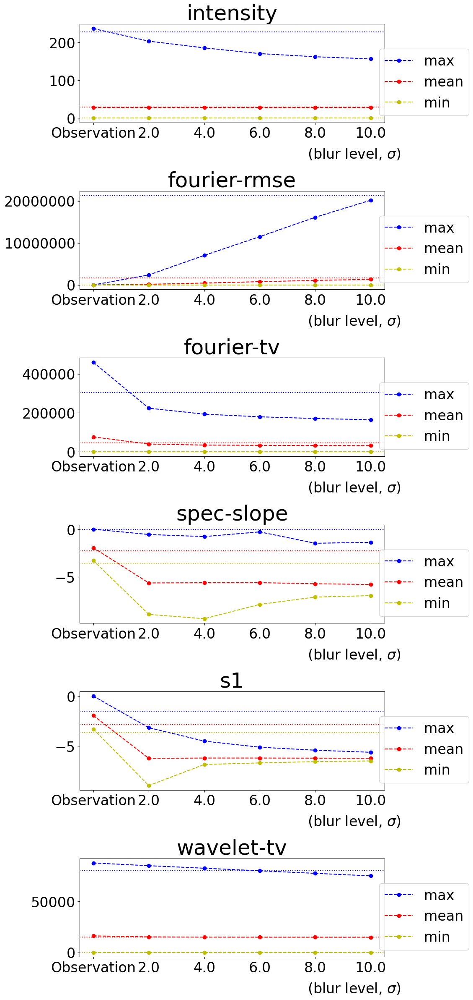

Saving results to EXP_blurring_gradually_starting_with_Observation_group_3_stats_plots.pdf
Computing transforms...


100%|██████████| 5/5 [00:00<00:00, 393.20it/s]

Computing heatmaps for rmse, ssim
on Observation, 0.2, 0.4, 0.6, 0.8, 1.0



##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.08737994357943535 seconds

Computing ssim
Done! 6 inputs took 1.1864861566573381 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

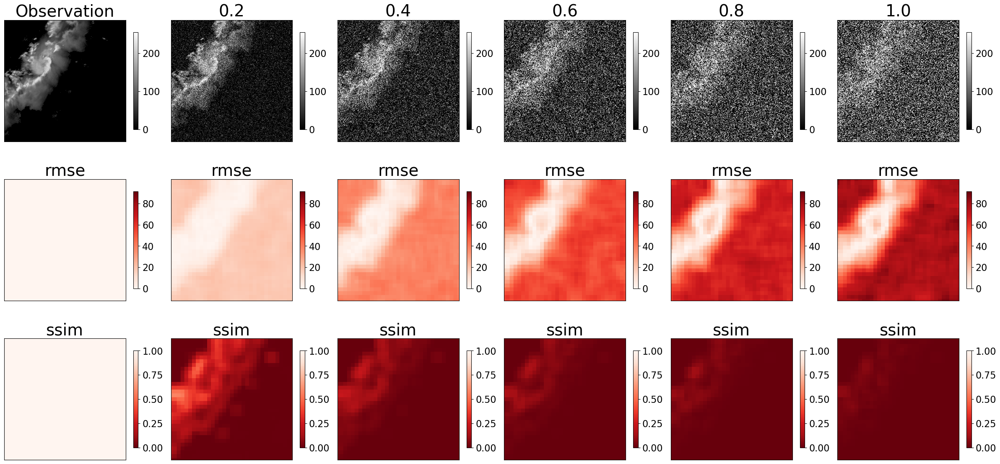


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_Observation_group_1_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_Observation_group_1_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_Observation_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	Observation : 28.44
	0.2         : 41.93
	0.4         : 57.30
	0.6         : 70.59
	0.8         : 80.45
	1.0         : 88.61

intensity - max:
	Observation : 237.00
	0.2         : 255.00
	0.4         : 255.00
	0.6         : 255.00
	0.8         : 255.00
	1.0         : 255.00

##### rmse #####

rmse - min:
	Observation : 0.00
	0.2         : 0.01
	0.4         : 0.01
	0.6         : 0.08
	0.8         : 0.32
	1.0         : 0.02

rmse - mean:
	Observation : 0.00
	0.2         : 13.60
	0.4         

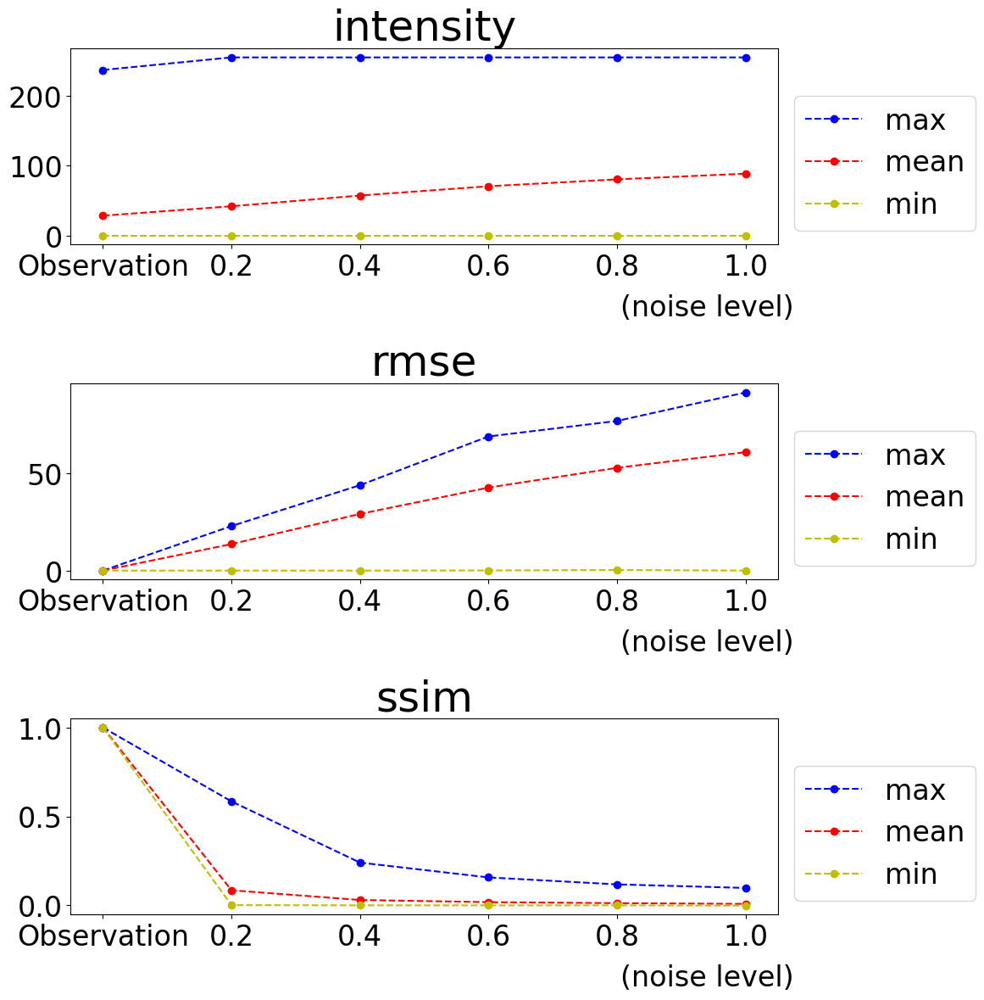

Saving results to EXP_adding_noise_gradually_starting_with_Observation_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on Observation, 0.2, 0.4, 0.6, 0.8, 1.0

##############################

Computing tv
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.22506559267640114 seconds

Computing grad-mag
Done! 6 inputs took 0.3931052442640066 seconds

Computing grad-tv
Done! 6 inputs took 0.38256111554801464 seconds

Computing grad-rmse
Done! 6 inputs took 0.36011536978185177 se

<Figure size 640x480 with 0 Axes>

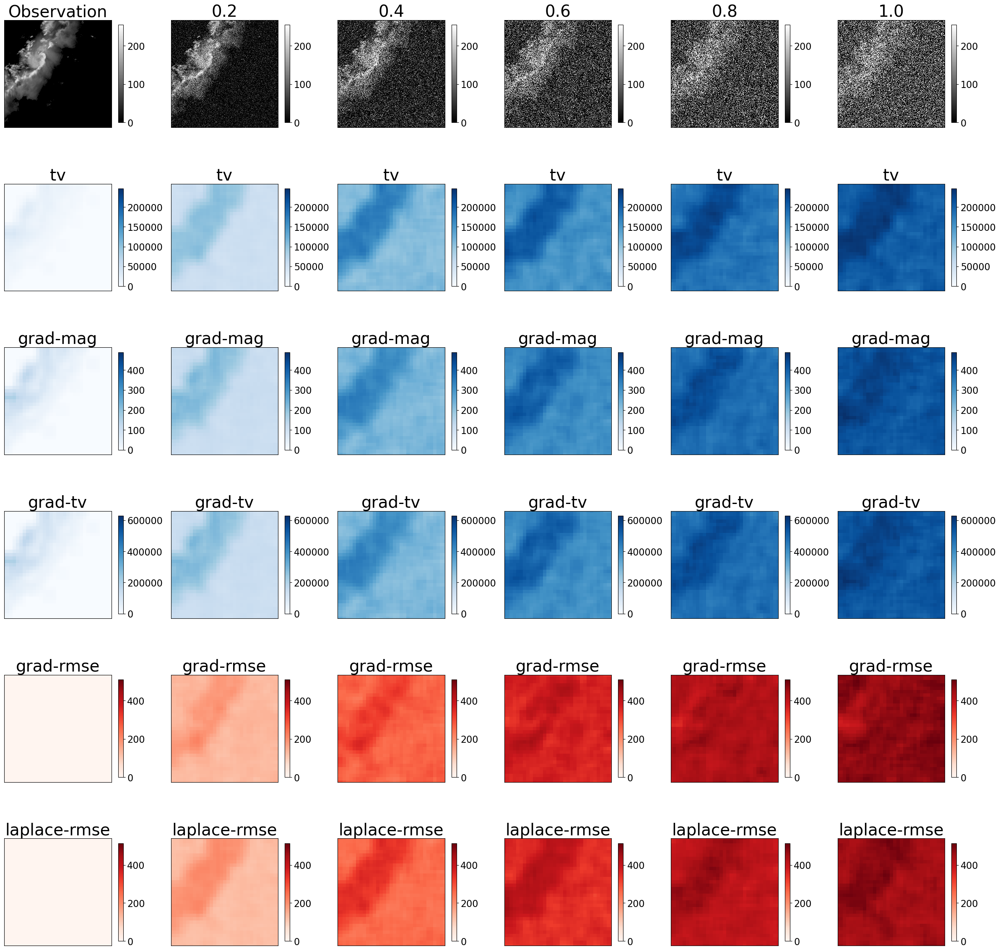


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_Observation_group_2_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_Observation_group_2_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_Observation_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	Observation : 28.44
	0.2         : 41.93
	0.4         : 57.30
	0.6         : 70.59
	0.8         : 80.45
	1.0         : 88.61

intensity - max:
	Observation : 237.00
	0.2         : 255.00
	0.4         : 255.00
	0.6         : 255.00
	0.8         : 255.00
	1.0         : 255.00

##### tv #####

tv - min:
	Observation : 0.00
	0.2         : 46193.54
	0.4         : 90295.54
	0.6         : 132277.41
	0.8         : 157538.41
	1.0         : 180985.63

tv - mean:
	Observation : 5566.31
	0.2         :

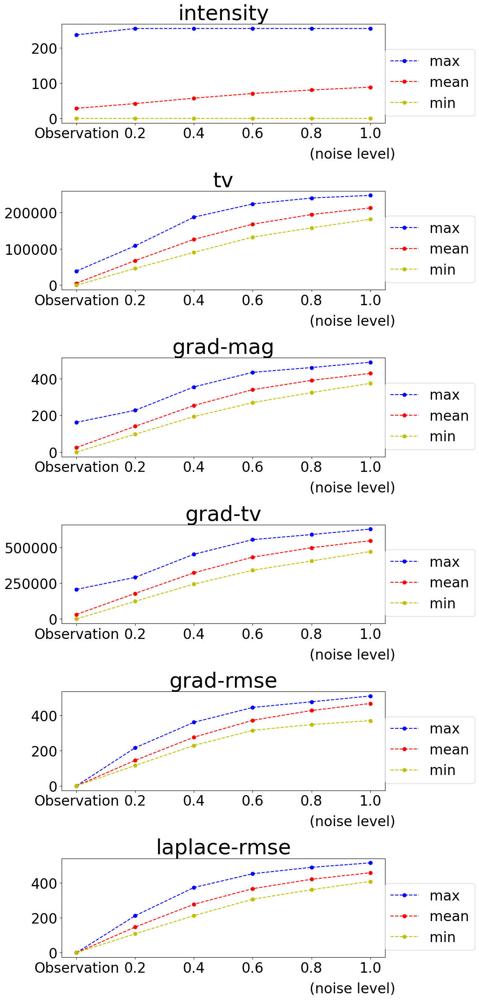

Saving results to EXP_adding_noise_gradually_starting_with_Observation_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on Observation, 0.2, 0.4, 0.6, 0.8, 1.0

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.7857930324971676 seconds

Computing fourier-tv
Done! 6 inputs took 0.7412694115191698 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
28464 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
28464 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
Done! 6 inputs took 10.079842803999782 seconds

Computing s1
NaNs encountered in s1:
28464 NaNs out of 65536 total blocks in image 0
28464 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
28464 NaNs out of 65536 total blocks in image 0

<Figure size 640x480 with 0 Axes>

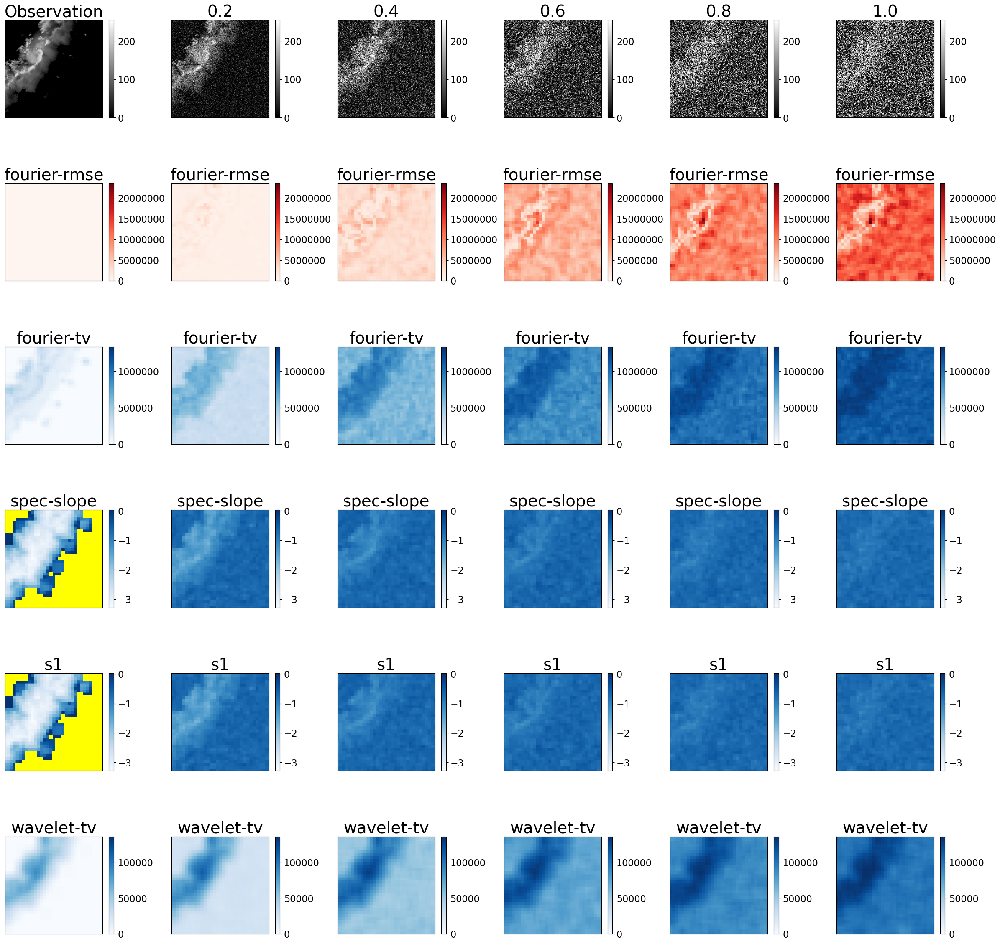


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_Observation_group_3_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_Observation_group_3_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_Observation_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	Observation : 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	Observation : 28.44
	0.2         : 41.93
	0.4         : 57.30
	0.6         : 70.59
	0.8         : 80.45
	1.0         : 88.61

intensity - max:
	Observation : 237.00
	0.2         : 255.00
	0.4         : 255.00
	0.6         : 255.00
	0.8         : 255.00
	1.0         : 255.00

##### fourier-rmse #####

fourier-rmse - min:
	Observation : 0.00
	0.2         : 411526.42
	0.4         : 1152930.42
	0.6         : 1616326.05
	0.8         : 2206946.53
	1.0         : 2270361.89

fourier-rmse - mean:
	

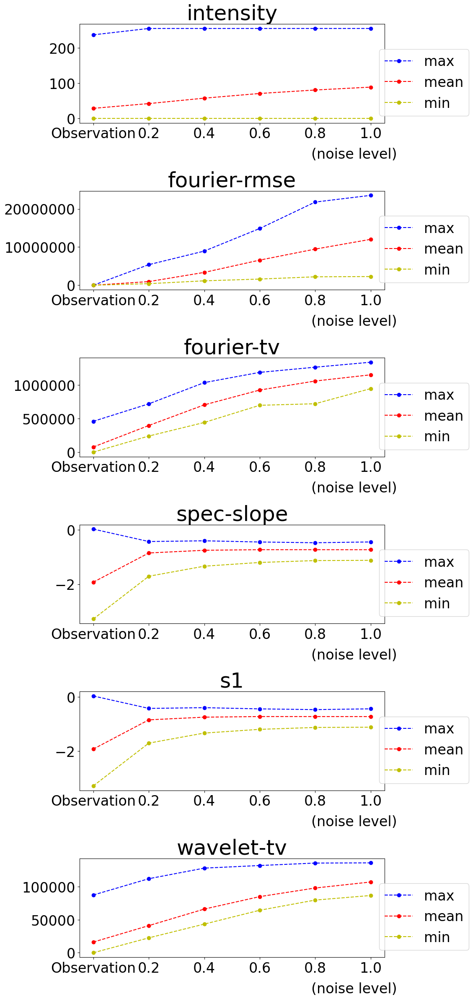

Saving results to EXP_adding_noise_gradually_starting_with_Observation_group_3_stats_plots.pdf


<Figure size 640x480 with 0 Axes>

In [33]:
# Experiment: GREMLIN experiments - Figures 4, 5, 6, 10 of paper
# Takes Radar image and blurs it, also compares it to GREMLIN estimate.

if EXP_GREMLIN_with_CALIBRATION:

    experiment_name = "Exp_GREMLIN_with_CALIBRATION"

    # Corresponding radar image
    file_name_radar_OBS = "../data/kh_MRMS_REFC.nc"
    # Corresponding GREMLIN estimate
    file_name_radar_NN = "../data/kh_GREMLIN_REFC.nc"

    for i_sample in [0]:  # , 40, 80, 120]:
        # Load original and estimate
        img_RADAR_OBS = load_data(file_name_radar_OBS, i_sample)
        # img_RADAR_OBS_string = f'Radar OBS (S{i_sample})'
        img_RADAR_OBS_string = f"Observation"  # short title

        # Corresponding CNN estimate of radar (using satellite image as input)
        file_name_radar_NN = "../data/kh_GREMLIN_REFC.nc"
        img_RADAR_NN = load_data(file_name_radar_NN, i_sample)
        # img_RADAR_NN_string = f'GREMLIN estimate'
        img_RADAR_NN_string = f"Estimate"  # short title

        compare_two_images_with_blur_and_noise_experiment(
            img_RADAR_OBS,
            img_RADAR_OBS_string,
            img_RADAR_NN,
            img_RADAR_NN_string,
            experiment_name=experiment_name,
        )

atmosriver
(256, 256)
(256, 256)
Computing heatmaps for rmse, ssim
on GFS atmosriver, GC  atmosriver

##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.030452052131295204 seconds

Computing ssim


Done! 2 inputs took 0.4094062652438879 seconds

##############################

Plotting figure...



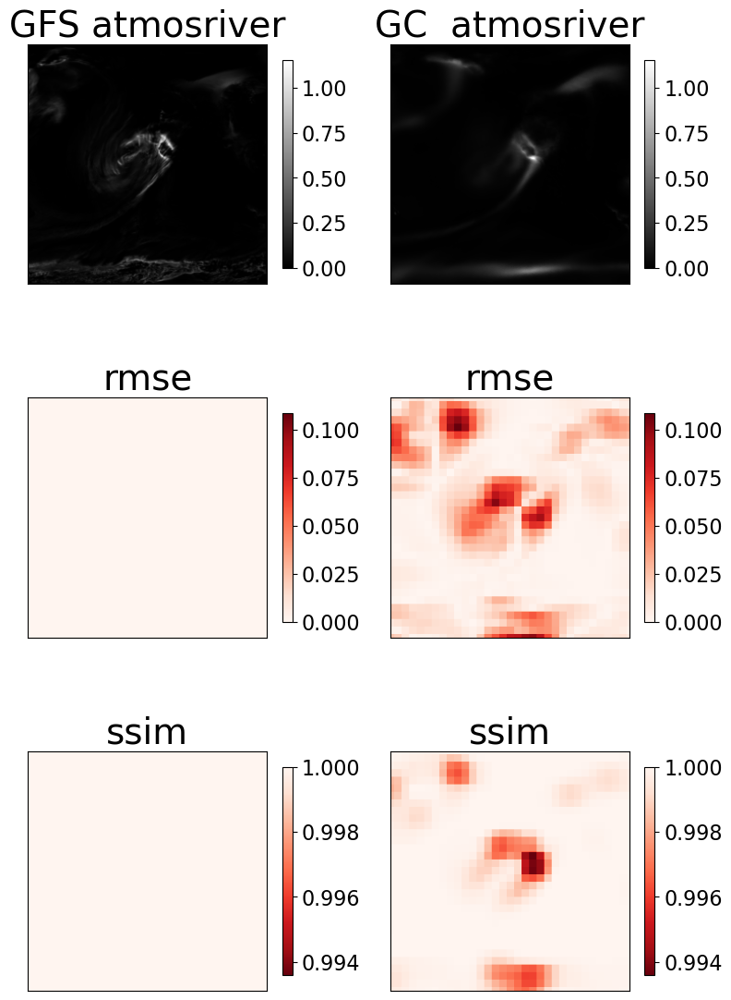


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_1_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_1_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	GC  atmosriver: -0.00

intensity - mean:
	GFS atmosriver: 0.02
	GC  atmosriver: 0.02

intensity - max:
	GFS atmosriver: 1.03
	GC  atmosriver: 1.15

##### rmse #####

rmse - min:
	GFS atmosriver: 0.00
	GC  atmosriver: 0.00

rmse - mean:
	GFS atmosriver: 0.00
	GC  atmosriver: 0.01

rmse - max:
	GFS atmosriver: 0.00
	GC  atmosriver: 0.11

##### ssim #####

ssim - min:
	GFS atmosriver: 1.00
	GC  atmosriver: 0.99

ssim - mean:
	GFS atmosriver: 1.00
	GC  atmosriver: 1.00

ssim - max:
	GFS atmosriver: 1.00
	GC  atmosriver: 1.00



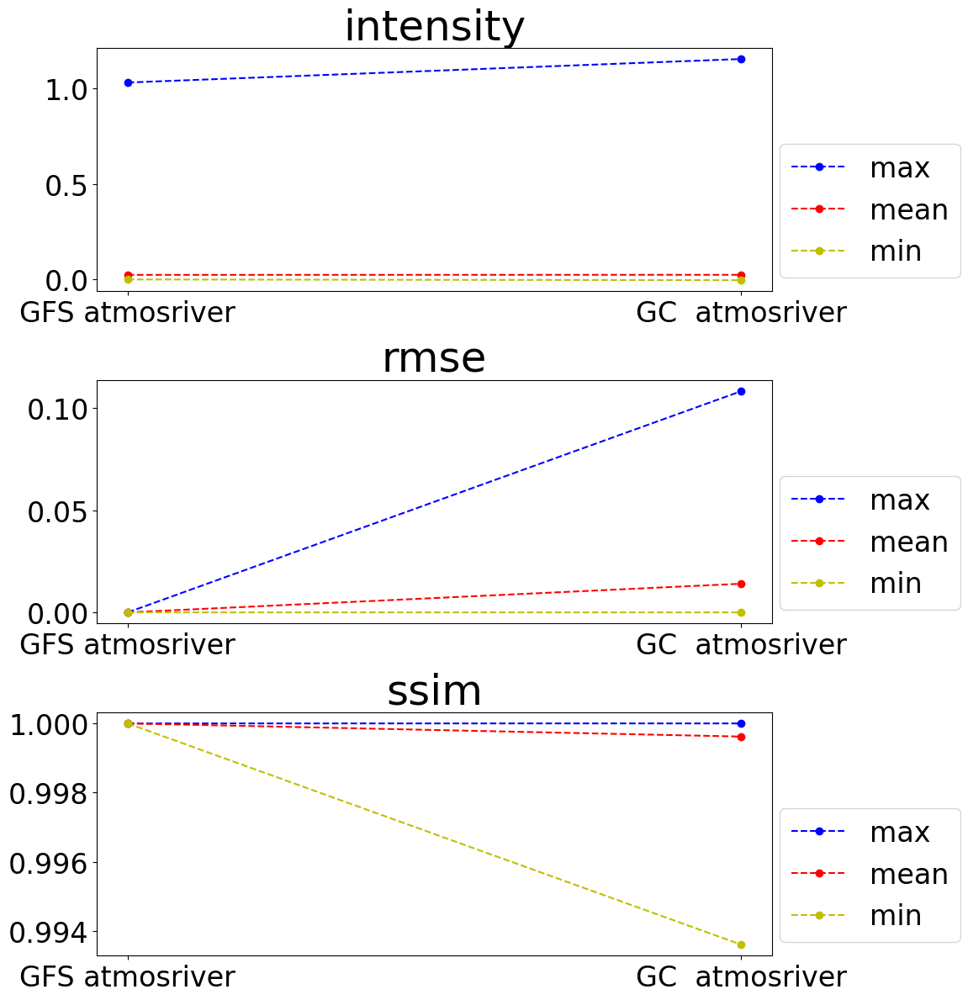

Saving results to EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS atmosriver, GC  atmosriver

##############################

Computing tv
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.07266117446124554 seconds

Computing grad-mag
Done! 2 inputs took 0.13009112887084484 seconds

Computing grad-tv
Done! 2 inputs took 0.11735514923930168 seconds

Computing grad-rmse
Done! 2 inputs took 0.11667481064796448 seconds

Computing laplace-rmse
Done! 2 inputs took 0.05936341546475887 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

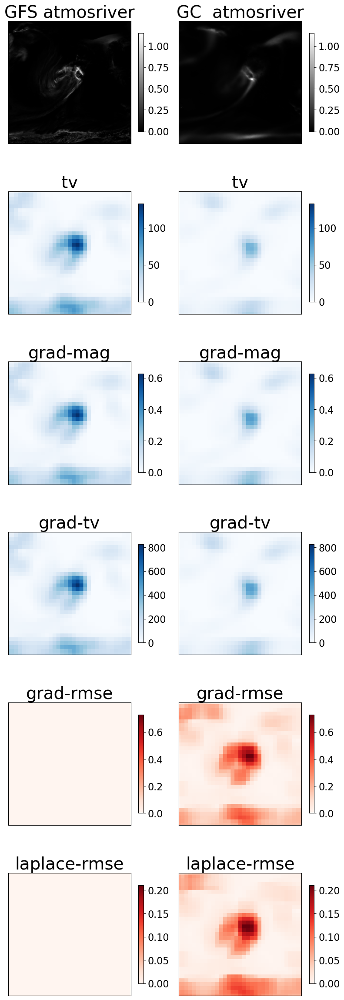


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_2_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_2_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	GC  atmosriver: -0.00

intensity - mean:
	GFS atmosriver: 0.02
	GC  atmosriver: 0.02

intensity - max:
	GFS atmosriver: 1.03
	GC  atmosriver: 1.15

##### tv #####

tv - min:
	GFS atmosriver: 0.00
	GC  atmosriver: 0.16

tv - mean:
	GFS atmosriver: 14.17
	GC  atmosriver: 5.68

tv - max:
	GFS atmosriver: 133.07
	GC  atmosriver: 63.80

##### grad-mag #####

grad-mag - min:
	GFS atmosriver: 0.00
	GC  atmosriver: 0.00

grad-mag - mean:
	GFS atmosriver: 0.06
	GC  atmosriver: 0.03

grad-mag - max:
	GFS atmosriver: 0.63
	GC  atmosriver: 0.36

##### grad-tv #####

grad-tv - min:
	GFS atmosriver: 0.0

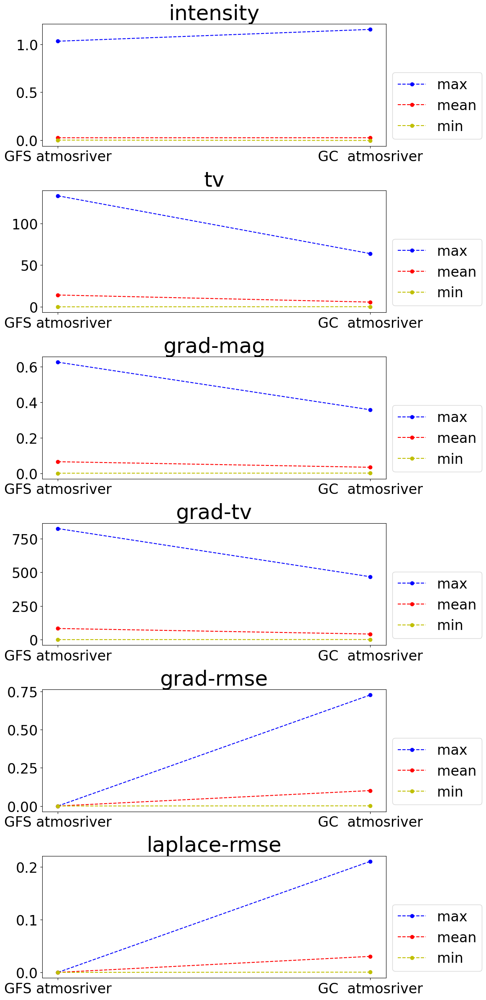

Saving results to EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS atmosriver, GC  atmosriver

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.2567796465009451 seconds

Computing fourier-tv
Done! 2 inputs took 0.2480513546615839 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
2912 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 3.3558098450303078 seconds

Computing s1
NaNs encountered in s1:
65536 NaNs out of 65536 total blocks in image 0
65536 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
65536 NaNs out of 65536 total blocks in image 0
65536 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 0.06468715891242027 seconds

Computing wavelet-tv


/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:207: RuntimeWarning: All-NaN axis encountered
  row_cmin = np.nanmin(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:208: RuntimeWarning: All-NaN axis encountered
  row_cmax = np.nanmax(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]


Done! 2 inputs took 0.41338098980486393 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

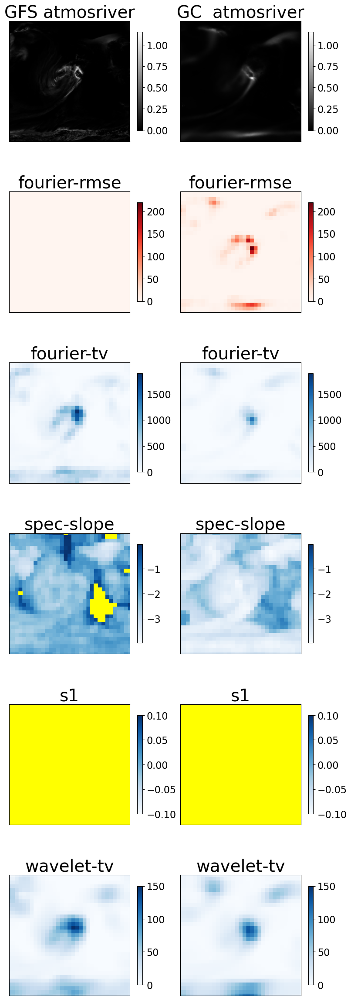


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_3_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_3_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	GC  atmosriver: -0.00

intensity - mean:
	GFS atmosriver: 0.02
	GC  atmosriver: 0.02

intensity - max:
	GFS atmosriver: 1.03
	GC  atmosriver: 1.15

##### fourier-rmse #####

fourier-rmse - min:
	GFS atmosriver: 0.00
	GC  atmosriver: 0.00

fourier-rmse - mean:
	GFS atmosriver: 0.00
	GC  atmosriver: 5.76

fourier-rmse - max:
	GFS atmosriver: 0.00
	GC  atmosriver: 218.80

##### fourier-tv #####

fourier-tv - min:
	GFS atmosriver: 0.00
	GC  atmosriver: 1.07

fourier-tv - mean:
	GFS atmosriver: 132.87
	GC  atmosriver: 58.57

fourier-tv - max:
	GFS atmosriver: 1888.73
	GC  atmosriver: 1384.52

#

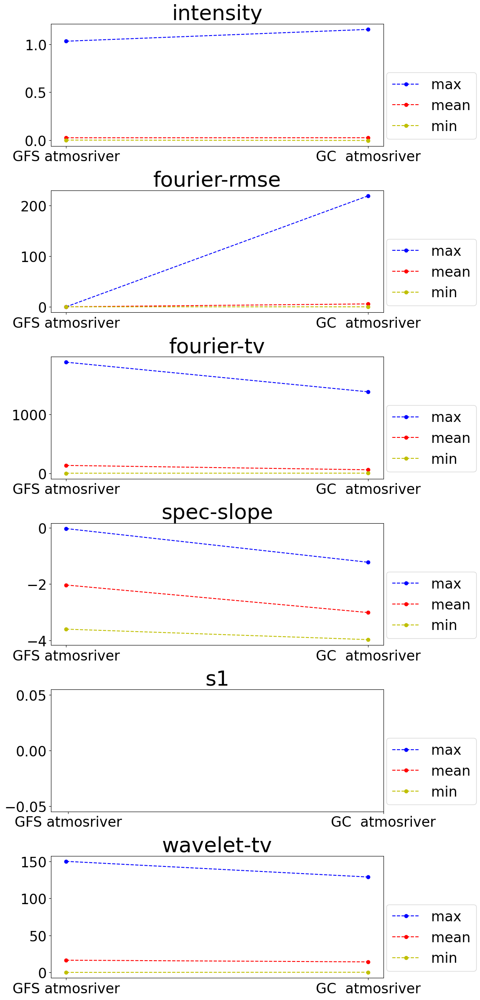

Saving results to EXP_GraphCast_GFS_with_C_GFS atmosriver_vs_GC  atmosriver_group_3_stats_plots.pdf
Computing transforms...


100%|██████████| 5/5 [00:00<00:00, 276.19it/s]

Computing heatmaps for rmse, ssim
on GFS atmosriver, 2.0, 4.0, 6.0, 8.0, 10.0



##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.08113960735499859 seconds

Computing ssim
Done! 6 inputs took 1.2021967582404613 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

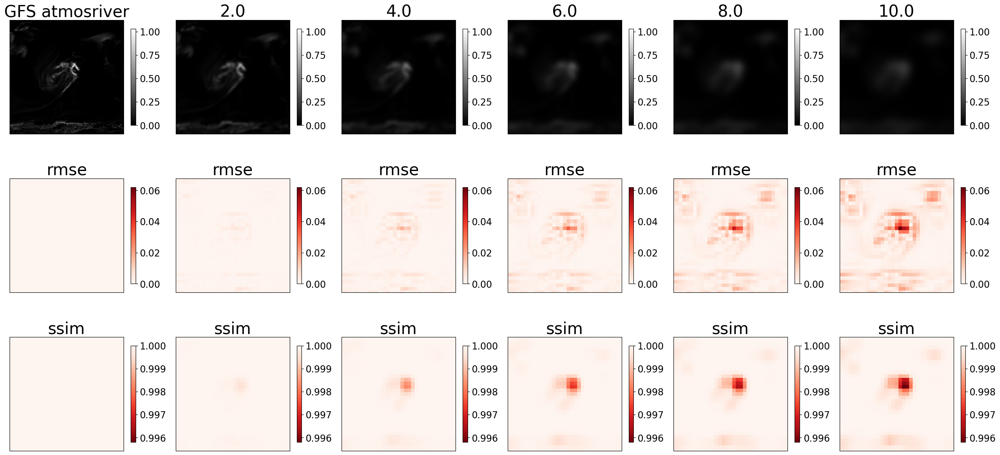


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS atmosriver_group_1_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS atmosriver_group_1_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS atmosriver_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS atmosriver: 0.02
	2.0         : 0.02
	4.0         : 0.02
	6.0         : 0.02
	8.0         : 0.02
	10.0        : 0.02

intensity - max:
	GFS atmosriver: 1.03
	2.0         : 0.65
	4.0         : 0.43
	6.0         : 0.32
	8.0         : 0.25
	10.0        : 0.21

##### rmse #####

rmse - min:
	GFS atmosriver: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

rmse - mean:
	GFS atmosriver: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0 

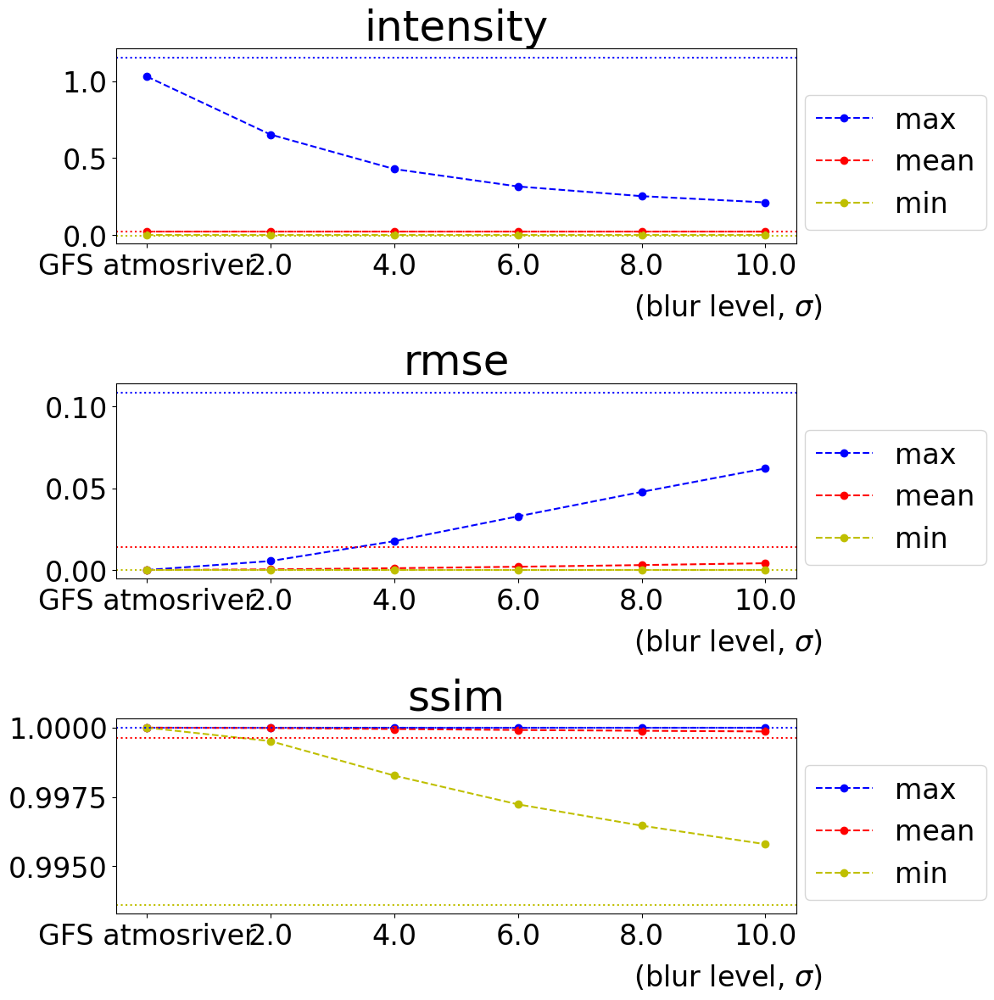

Saving results to EXP_blurring_gradually_starting_with_GFS atmosriver_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS atmosriver, 2.0, 4.0, 6.0, 8.0, 10.0

##############################

Computing tv
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.22305874899029732 seconds

Computing grad-mag
Done! 6 inputs took 0.39704968966543674 seconds

Computing grad-tv
Done! 6 inputs took 0.3872726075351238 seconds

Computing grad-rmse
Done! 6 inputs took 0.3666519969701767 

<Figure size 640x480 with 0 Axes>

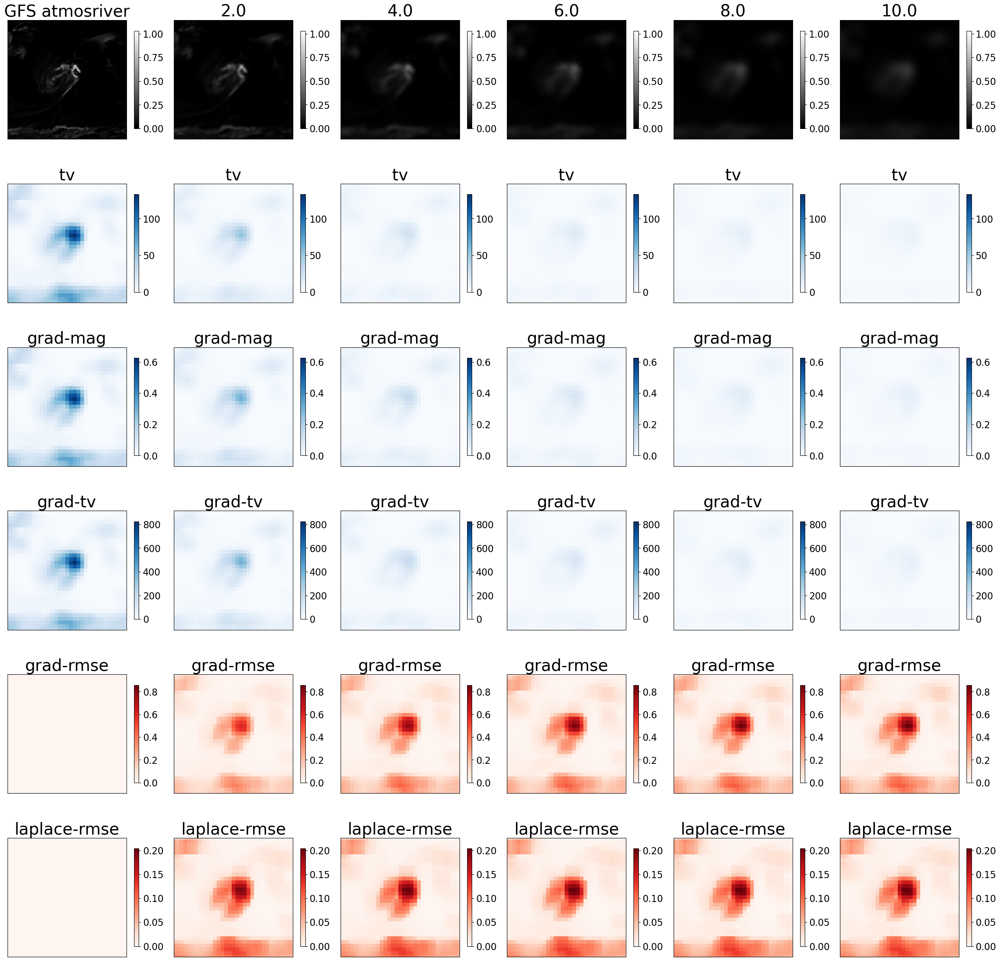


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS atmosriver_group_2_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS atmosriver_group_2_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS atmosriver_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS atmosriver: 0.02
	2.0         : 0.02
	4.0         : 0.02
	6.0         : 0.02
	8.0         : 0.02
	10.0        : 0.02

intensity - max:
	GFS atmosriver: 1.03
	2.0         : 0.65
	4.0         : 0.43
	6.0         : 0.32
	8.0         : 0.25
	10.0        : 0.21

##### tv #####

tv - min:
	GFS atmosriver: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

tv - mean:
	GFS atmosriver: 14.17
	2.0         : 5.35
	4.0         : 3.09
	6.0      

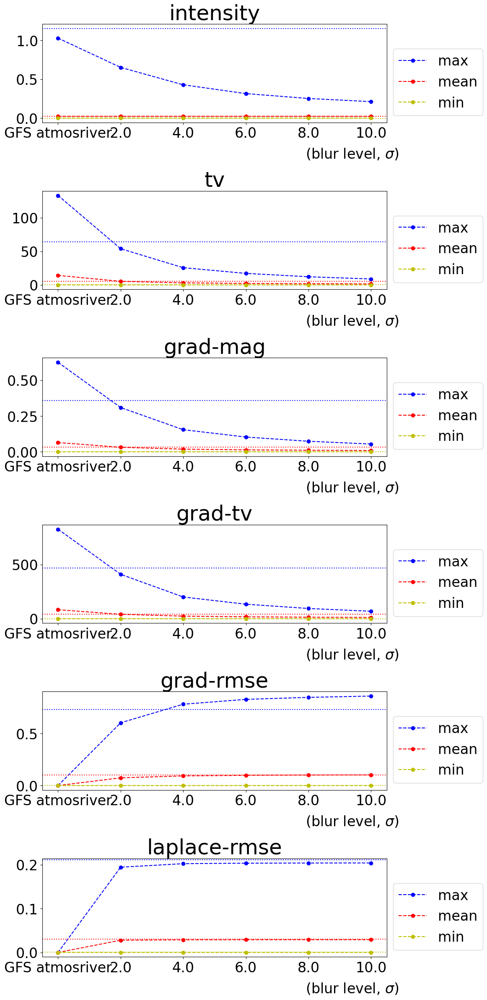

Saving results to EXP_blurring_gradually_starting_with_GFS atmosriver_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS atmosriver, 2.0, 4.0, 6.0, 8.0, 10.0

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.7724944334477186 seconds

Computing fourier-tv
Done! 6 inputs took 0.7442754898220301 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
2912 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
672 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
Done! 6 inputs took 10.072758387774229 seconds

Computing s1
NaNs encountered in s1:
65536 NaNs out of 65536 total blocks in image 0
65536 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
65536 NaNs out of 65536 total blocks in image 0
6553

/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:207: RuntimeWarning: All-NaN axis encountered
  row_cmin = np.nanmin(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:208: RuntimeWarning: All-NaN axis encountered
  row_cmax = np.nanmax(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]



Computing wavelet-tv
Done! 6 inputs took 1.246242392808199 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

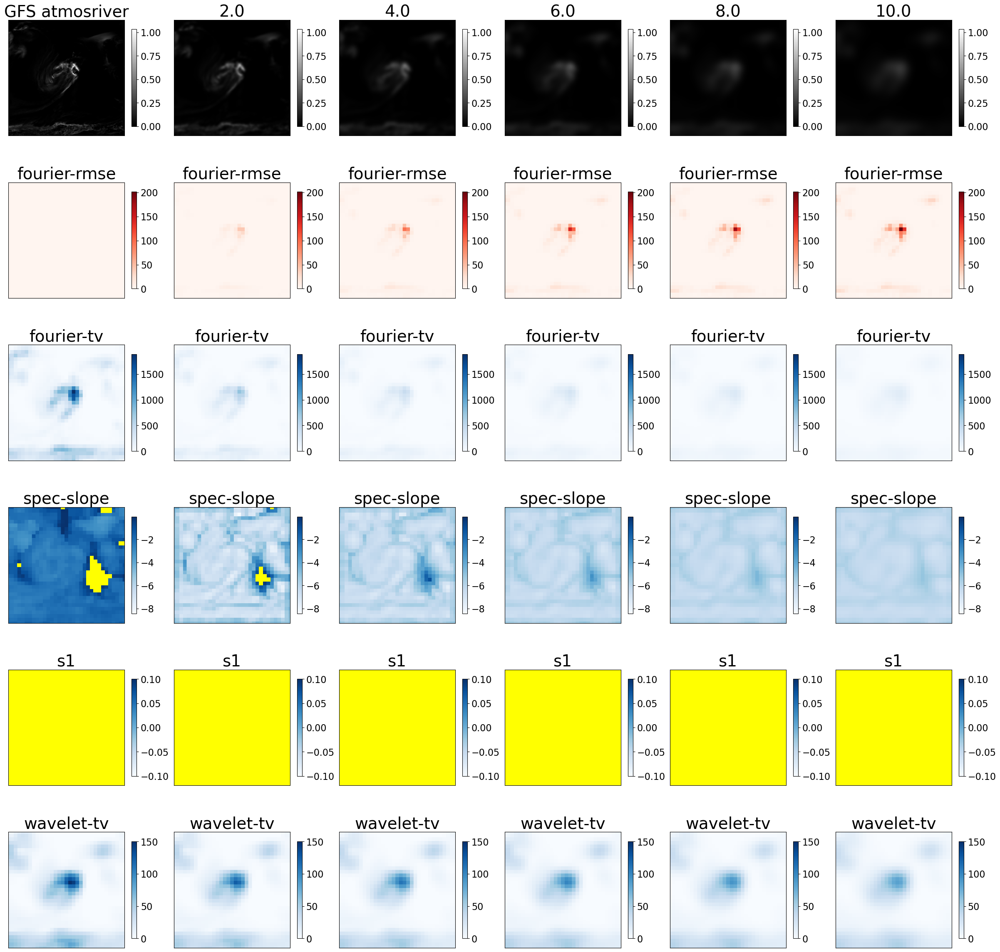


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS atmosriver_group_3_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS atmosriver_group_3_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS atmosriver_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS atmosriver: 0.02
	2.0         : 0.02
	4.0         : 0.02
	6.0         : 0.02
	8.0         : 0.02
	10.0        : 0.02

intensity - max:
	GFS atmosriver: 1.03
	2.0         : 0.65
	4.0         : 0.43
	6.0         : 0.32
	8.0         : 0.25
	10.0        : 0.21

##### fourier-rmse #####

fourier-rmse - min:
	GFS atmosriver: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

fourier-rmse - mean:
	GFS atmosriver: 0.00
	2.0         : 0.68
	

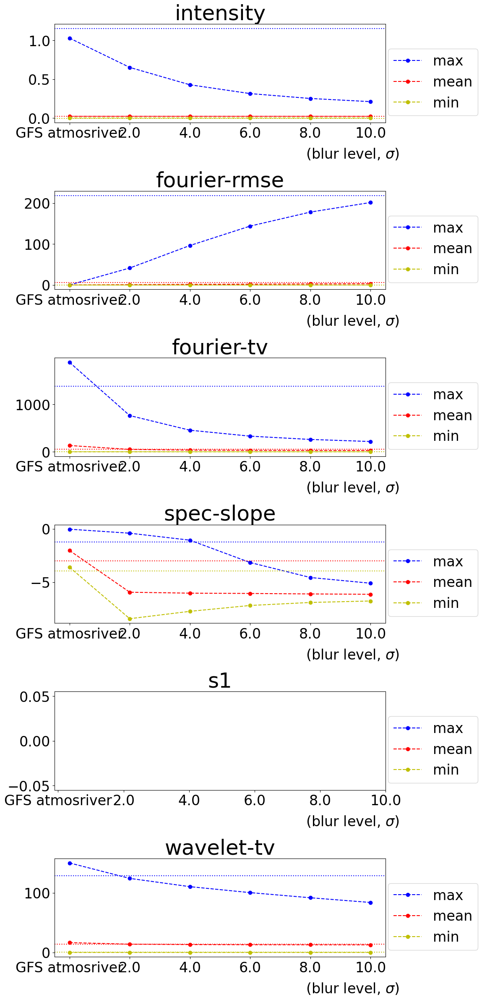

Saving results to EXP_blurring_gradually_starting_with_GFS atmosriver_group_3_stats_plots.pdf
Computing transforms...


100%|██████████| 5/5 [00:00<00:00, 386.06it/s]

Computing heatmaps for rmse, ssim
on GFS atmosriver, 0.2, 0.4, 0.6, 0.8, 1.0



##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.0814337208867073 seconds

Computing ssim
Done! 6 inputs took 1.220458634197712 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

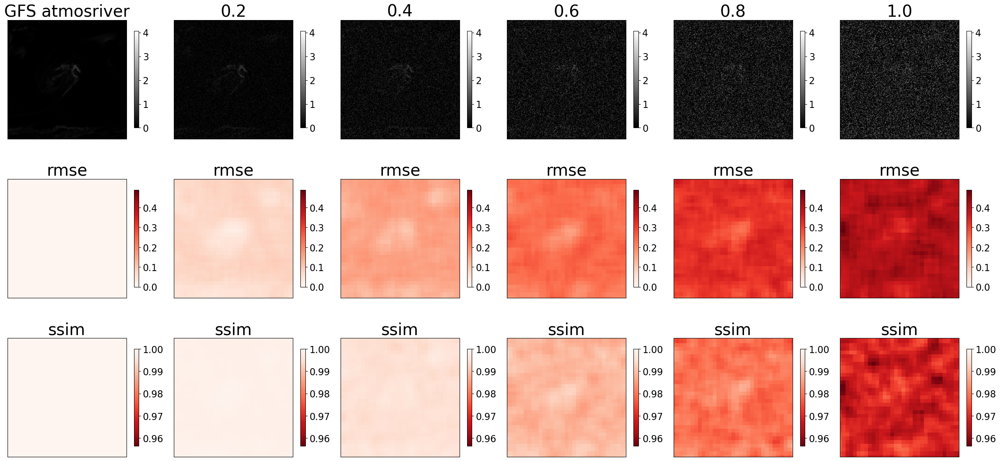


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_1_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_1_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS atmosriver: 0.02
	0.2         : 0.10
	0.4         : 0.18
	0.6         : 0.26
	0.8         : 0.34
	1.0         : 0.43

intensity - max:
	GFS atmosriver: 1.03
	0.2         : 1.41
	0.4         : 1.83
	0.6         : 2.70
	0.8         : 3.68
	1.0         : 4.07

##### rmse #####

rmse - min:
	GFS atmosriver: 0.00
	0.2         : 0.02
	0.4         : 0.10
	0.6         : 0.16
	0.8         : 0.23
	1.0         : 0.31

rmse - mean:
	GFS atmosriver: 0.00
	0.2         : 0.07
	0.4         

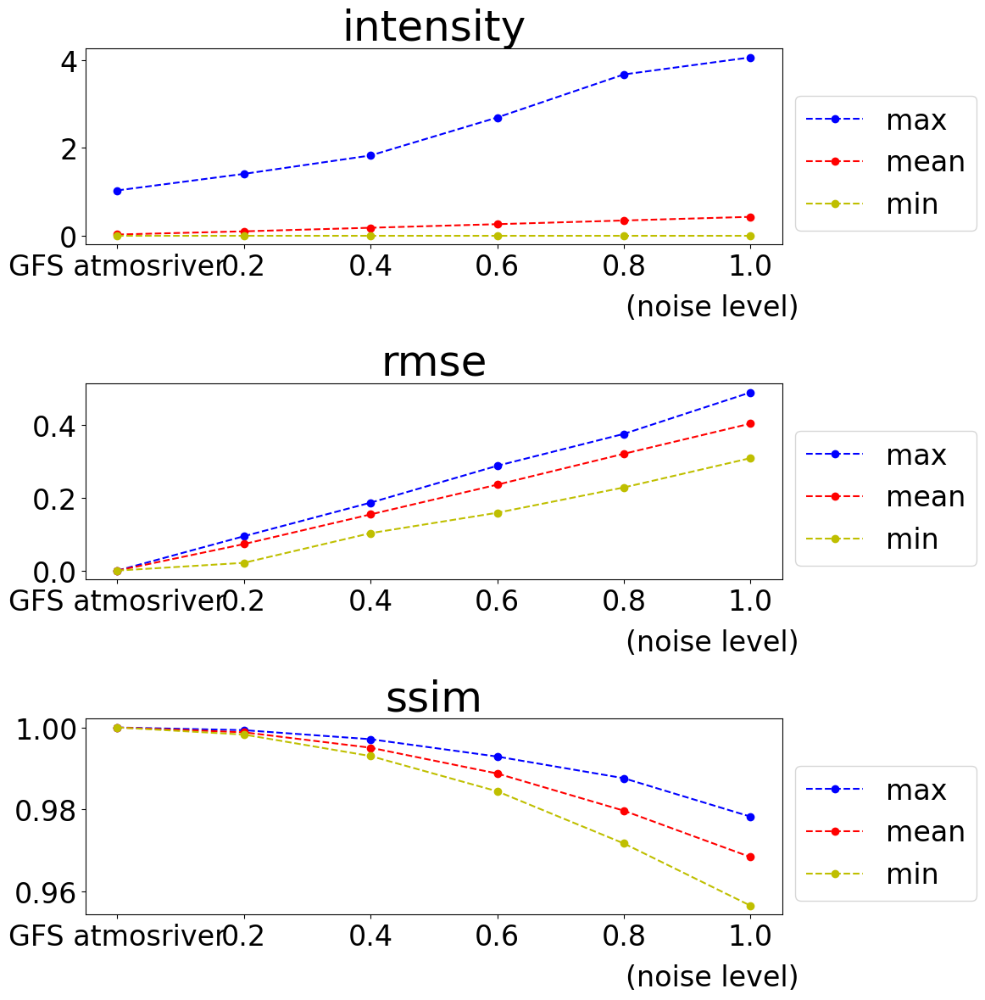

Saving results to EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS atmosriver, 0.2, 0.4, 0.6, 0.8, 1.0

##############################

Computing tv
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.22979457676410675 seconds

Computing grad-mag
Done! 6 inputs took 0.39221595972776413 seconds

Computing grad-tv
Done! 6 inputs took 0.36039676517248154 seconds

Computing grad-rmse
Done! 6 inputs took 0.3955516479909

<Figure size 640x480 with 0 Axes>

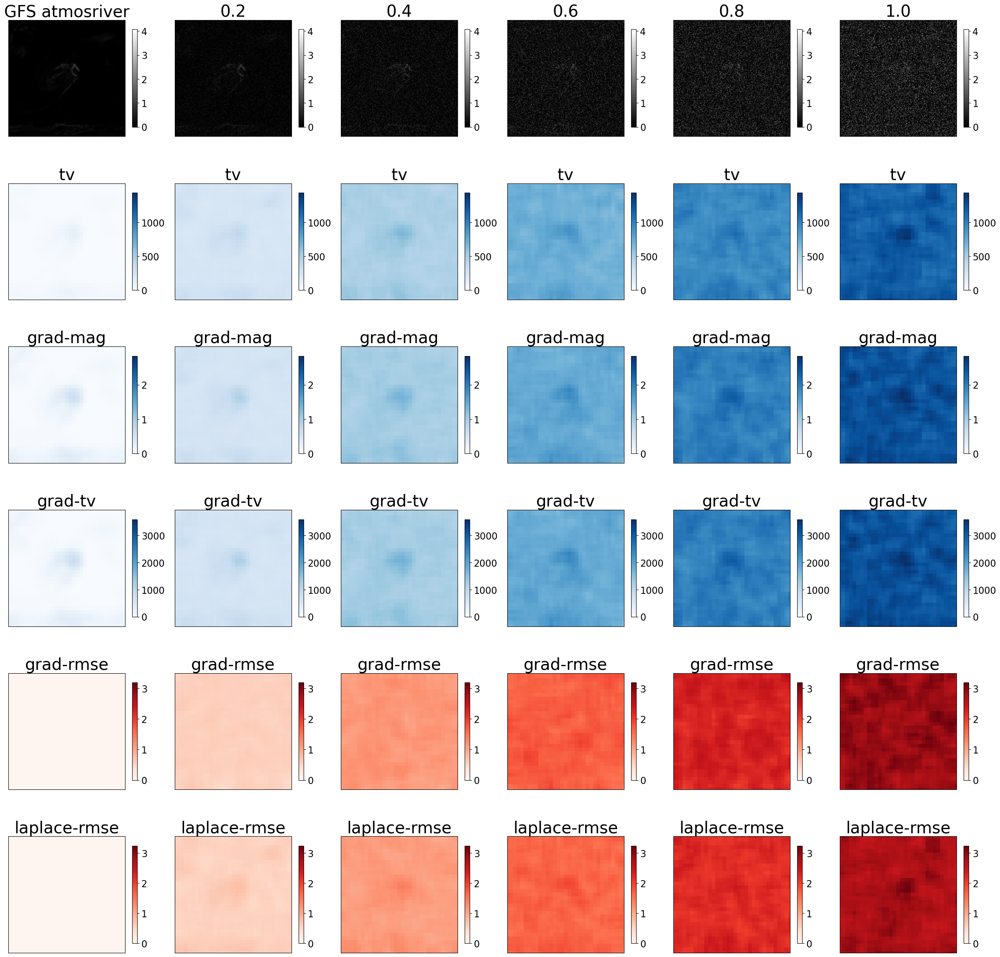


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_2_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_2_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS atmosriver: 0.02
	0.2         : 0.10
	0.4         : 0.18
	0.6         : 0.26
	0.8         : 0.34
	1.0         : 0.43

intensity - max:
	GFS atmosriver: 1.03
	0.2         : 1.41
	0.4         : 1.83
	0.6         : 2.70
	0.8         : 3.68
	1.0         : 4.07

##### tv #####

tv - min:
	GFS atmosriver: 0.00
	0.2         : 207.31
	0.4         : 414.13
	0.6         : 623.82
	0.8         : 830.48
	1.0         : 1027.89

tv - mean:
	GFS atmosriver: 14.17
	0.2         : 251.56
	0.4 

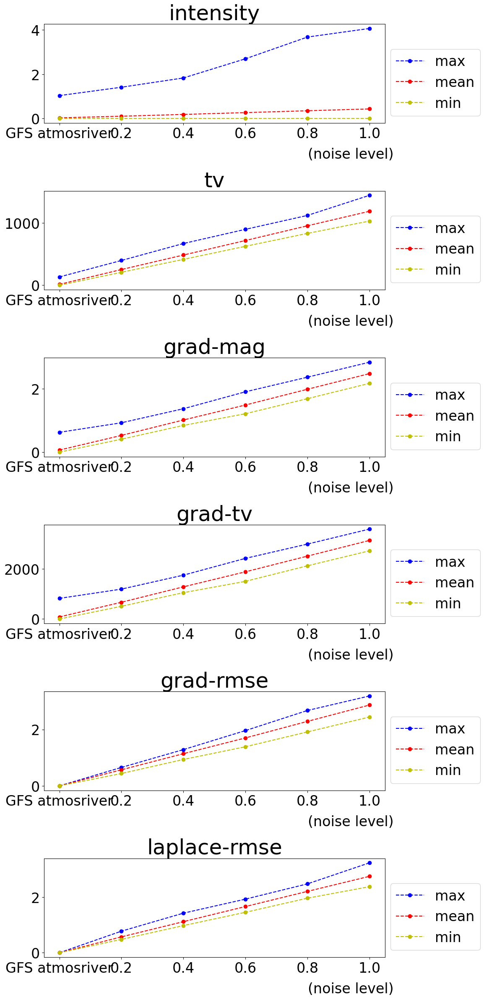

Saving results to EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS atmosriver, 0.2, 0.4, 0.6, 0.8, 1.0

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 6 inputs took 0.7670031581073999 seconds

Computing fourier-tv
Done! 6 inputs took 0.7417486682534218 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
2912 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
2912 NaNs out of 65536 total blocks in image 0
0 NaNs out of 65536 total blocks in image 1
Done! 6 inputs took 9.897137369960546 seconds

Computing s1
NaNs encountered in s1:
65536 NaNs out of 65536 total blocks in image 0
65536 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
65536 NaNs out of 65536 total blocks in image 0
65536 N

/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:207: RuntimeWarning: All-NaN axis encountered
  row_cmin = np.nanmin(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:208: RuntimeWarning: All-NaN axis encountered
  row_cmax = np.nanmax(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]



Computing wavelet-tv
Done! 6 inputs took 1.2330813314765692 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

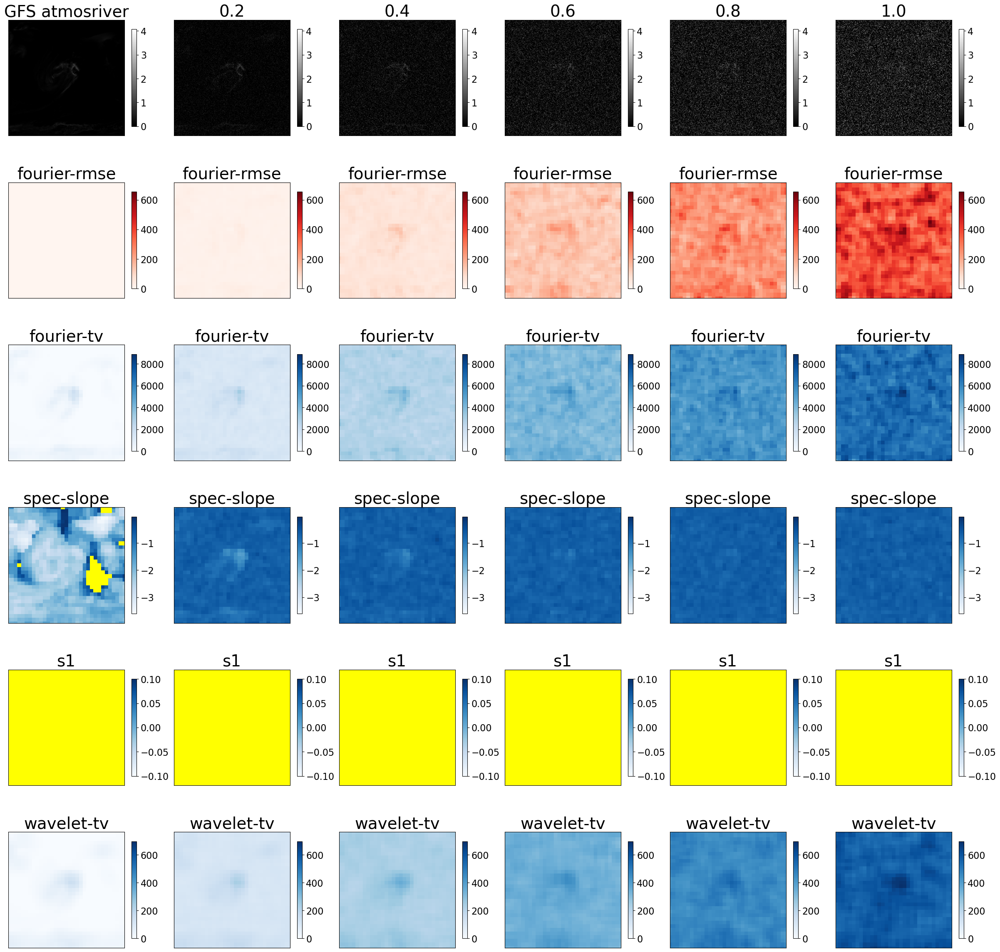


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_3_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_3_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS atmosriver: 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS atmosriver: 0.02
	0.2         : 0.10
	0.4         : 0.18
	0.6         : 0.26
	0.8         : 0.34
	1.0         : 0.43

intensity - max:
	GFS atmosriver: 1.03
	0.2         : 1.41
	0.4         : 1.83
	0.6         : 2.70
	0.8         : 3.68
	1.0         : 4.07

##### fourier-rmse #####

fourier-rmse - min:
	GFS atmosriver: 0.00
	0.2         : 9.48
	0.4         : 35.20
	0.6         : 75.47
	0.8         : 129.42
	1.0         : 215.46

fourier-rmse - mean:
	GFS atmosriver: 0.00
	0.

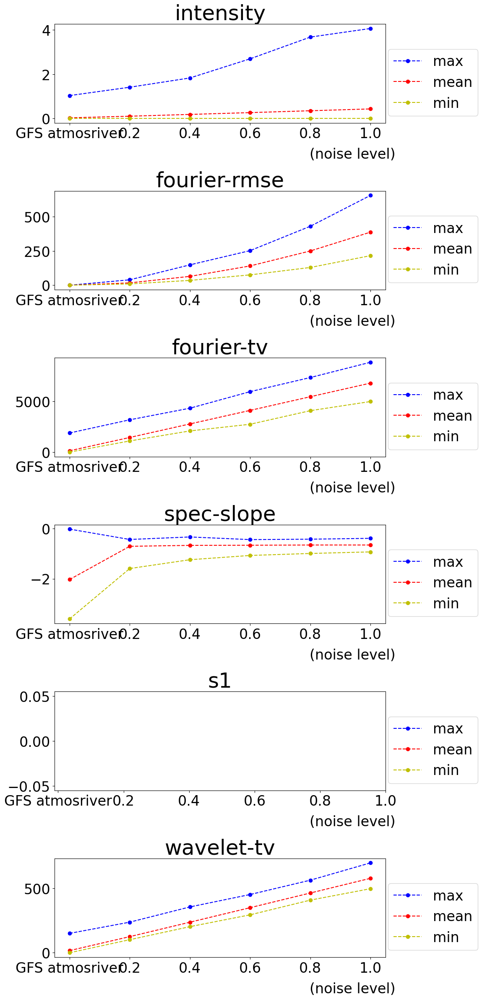

Saving results to EXP_adding_noise_gradually_starting_with_GFS atmosriver_group_3_stats_plots.pdf
idalia
(128, 128)
(128, 128)
Computing heatmaps for rmse, ssim
on GFS idalia, GC  idalia

##############################

Computing rmse
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 2 inputs took 0.024219753220677376 seconds

Computing ssim
Done! 2 inputs took 0.3529683668166399 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

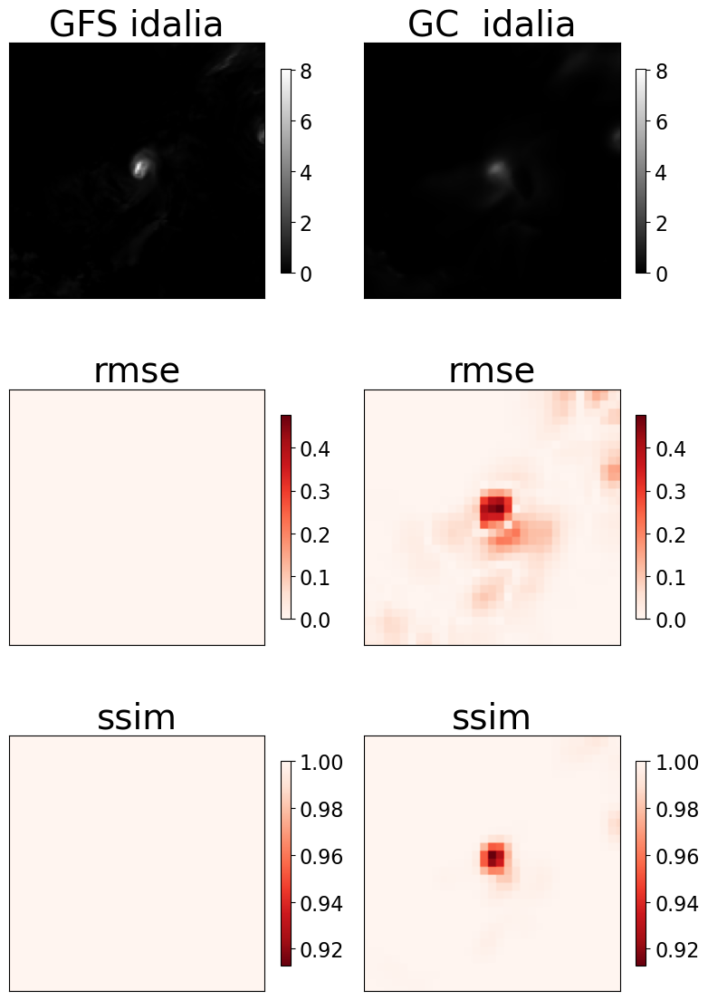


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_1_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_1_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	GC  idalia  : -0.00

intensity - mean:
	GFS idalia  : 0.06
	GC  idalia  : 0.06

intensity - max:
	GFS idalia  : 8.05
	GC  idalia  : 3.03

##### rmse #####

rmse - min:
	GFS idalia  : 0.00
	GC  idalia  : 0.00

rmse - mean:
	GFS idalia  : 0.00
	GC  idalia  : 0.02

rmse - max:
	GFS idalia  : 0.00
	GC  idalia  : 0.48

##### ssim #####

ssim - min:
	GFS idalia  : 1.00
	GC  idalia  : 0.91

ssim - mean:
	GFS idalia  : 1.00
	GC  idalia  : 1.00

ssim - max:
	GFS idalia  : 1.00
	GC  idalia  : 1.00



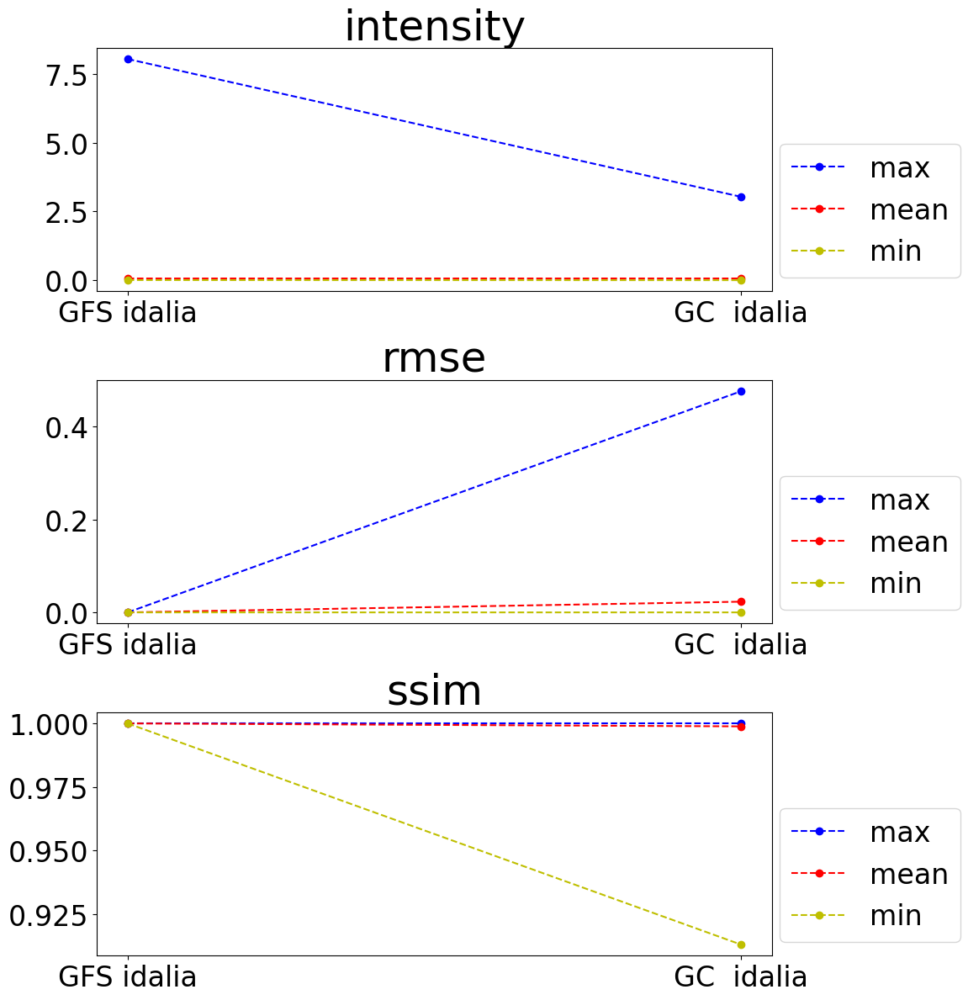

Saving results to EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS idalia, GC  idalia

##############################

Computing tv
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 2 inputs took 0.06227635033428669 seconds

Computing grad-mag
Done! 2 inputs took 0.11037820018827915 seconds

Computing grad-tv
Done! 2 inputs took 0.09588849171996117 seconds

Computing grad-rmse
Done! 2 inputs took 0.09490149654448032 seconds

Computing laplace-rmse
Done! 2 inputs took 0.04749675653874874 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

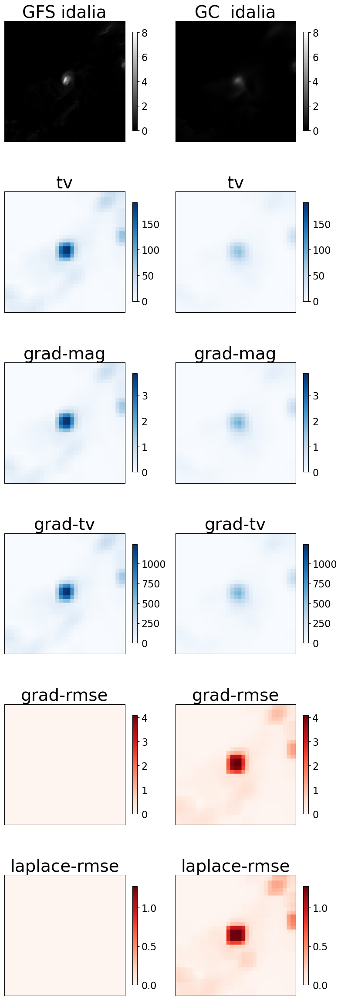


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_2_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_2_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	GC  idalia  : -0.00

intensity - mean:
	GFS idalia  : 0.06
	GC  idalia  : 0.06

intensity - max:
	GFS idalia  : 8.05
	GC  idalia  : 3.03

##### tv #####

tv - min:
	GFS idalia  : 0.00
	GC  idalia  : 0.05

tv - mean:
	GFS idalia  : 9.80
	GC  idalia  : 4.38

tv - max:
	GFS idalia  : 190.98
	GC  idalia  : 80.04

##### grad-mag #####

grad-mag - min:
	GFS idalia  : 0.00
	GC  idalia  : 0.00

grad-mag - mean:
	GFS idalia  : 0.18
	GC  idalia  : 0.10

grad-mag - max:
	GFS idalia  : 3.86
	GC  idalia  : 1.86

##### grad-tv #####

grad-tv - min:
	GFS idalia  : 0.00
	GC  idalia  : 0.24

grad-tv - mean:
	GFS idalia  : 57.00
	GC

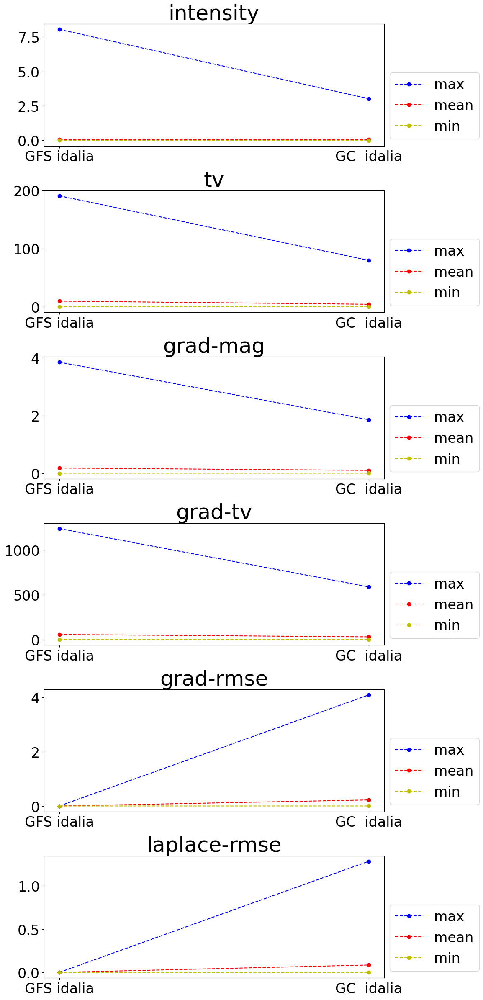

Saving results to EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS idalia, GC  idalia

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 2 inputs took 0.20205599442124367 seconds

Computing fourier-tv
Done! 2 inputs took 0.18992589972913265 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
2468 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
0 NaNs out of 16384 total blocks in image 1
Done! 2 inputs took 2.357730206102133 seconds

Computing s1
NaNs encountered in s1:
16384 NaNs out of 16384 total blocks in image 0
16384 NaNs out of 16384 total blocks in image 1
NaNs encountered in s1:
16384 NaNs out of 16384 total blocks in image 0
16384 NaNs out of 16384 total blocks in image 1
Done! 2 inputs took 0.0608314611017704 seconds

Computing wavelet-tv


/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:207: RuntimeWarning: All-NaN axis encountered
  row_cmin = np.nanmin(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:208: RuntimeWarning: All-NaN axis encountered
  row_cmax = np.nanmax(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]


Done! 2 inputs took 0.3753849156200886 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

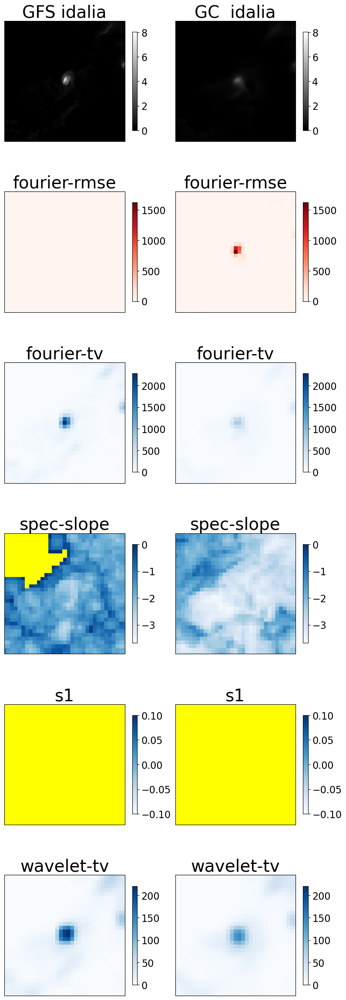


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_3_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_3_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	GC  idalia  : -0.00

intensity - mean:
	GFS idalia  : 0.06
	GC  idalia  : 0.06

intensity - max:
	GFS idalia  : 8.05
	GC  idalia  : 3.03

##### fourier-rmse #####

fourier-rmse - min:
	GFS idalia  : 0.00
	GC  idalia  : 0.00

fourier-rmse - mean:
	GFS idalia  : 0.00
	GC  idalia  : 8.02

fourier-rmse - max:
	GFS idalia  : 0.00
	GC  idalia  : 1616.82

##### fourier-tv #####

fourier-tv - min:
	GFS idalia  : 0.00
	GC  idalia  : 0.20

fourier-tv - mean:
	GFS idalia  : 48.11
	GC  idalia  : 25.70

fourier-tv - max:
	GFS idalia  : 2278.07
	GC  idalia  : 772.13

##### spec-slope #####

spec-slope - min:
	GFS idalia  : -2.72

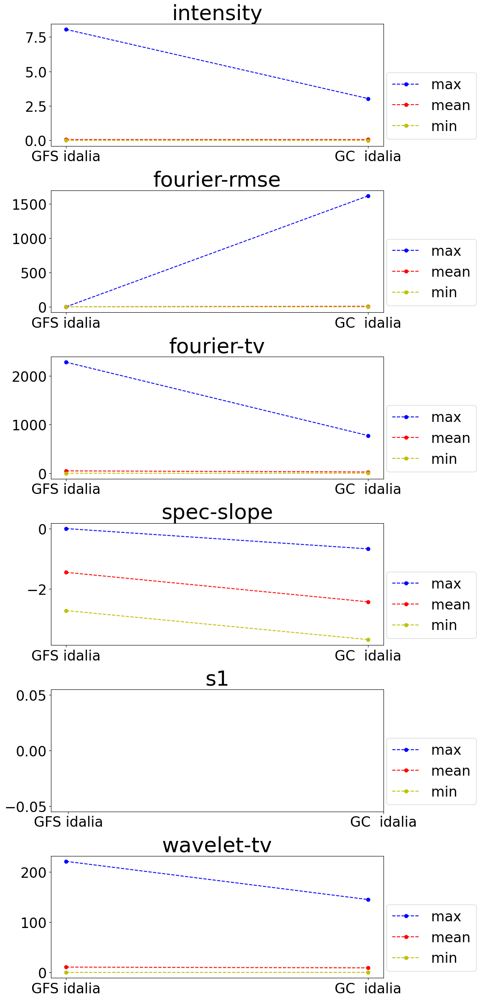

Saving results to EXP_GraphCast_GFS_with_C_GFS idalia_vs_GC  idalia_group_3_stats_plots.pdf
Computing transforms...


100%|██████████| 5/5 [00:00<00:00, 917.67it/s]

Computing heatmaps for rmse, ssim
on GFS idalia, 2.0, 4.0, 6.0, 8.0, 10.0



##############################

Computing rmse
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 6 inputs took 0.0722198560833931 seconds

Computing ssim
Done! 6 inputs took 0.996627701446414 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

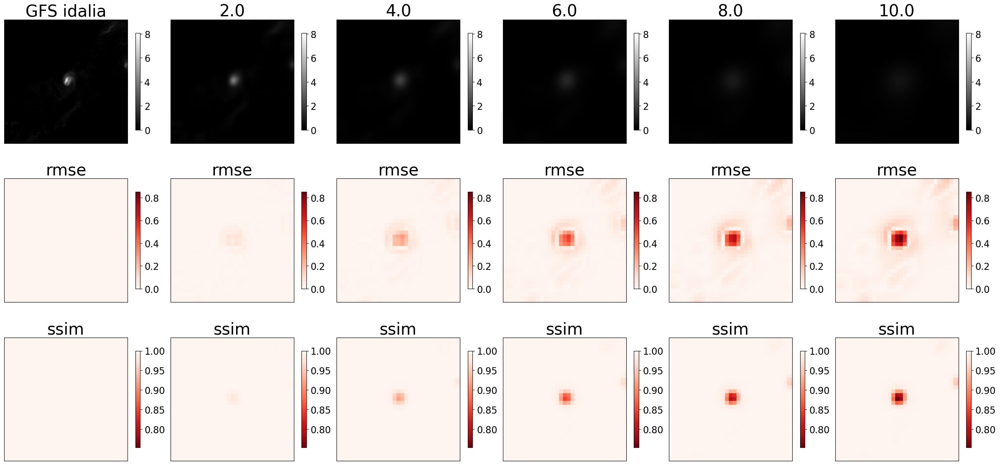


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS idalia_group_1_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS idalia_group_1_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS idalia_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS idalia  : 0.06
	2.0         : 0.06
	4.0         : 0.06
	6.0         : 0.06
	8.0         : 0.06
	10.0        : 0.06

intensity - max:
	GFS idalia  : 8.05
	2.0         : 3.88
	4.0         : 2.04
	6.0         : 1.20
	8.0         : 0.79
	10.0        : 0.56

##### rmse #####

rmse - min:
	GFS idalia  : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

rmse - mean:
	GFS idalia  : 0.00
	2.0         : 0.00
	4.0         : 0.01
	6.0         : 0.02
	8.0   

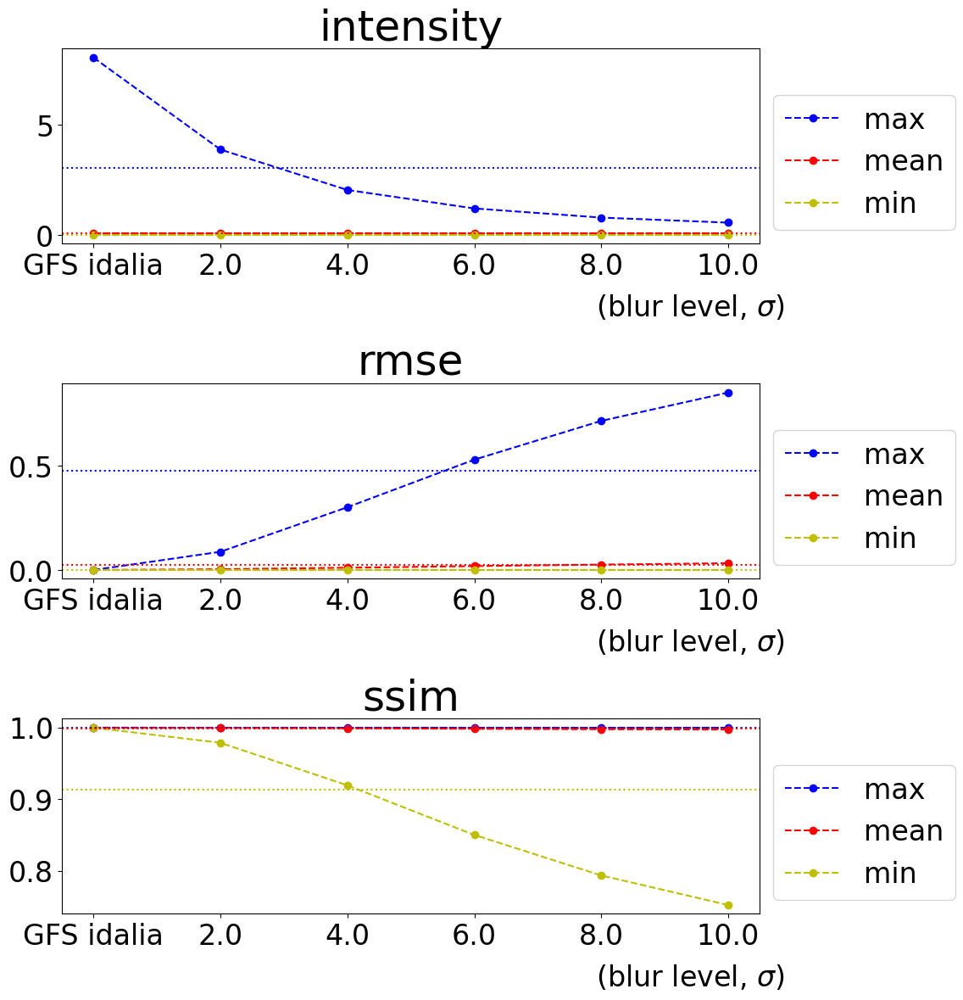

Saving results to EXP_blurring_gradually_starting_with_GFS idalia_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS idalia, 2.0, 4.0, 6.0, 8.0, 10.0

##############################

Computing tv
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 6 inputs took 0.18377734906971455 seconds

Computing grad-mag
Done! 6 inputs took 0.30482761189341545 seconds

Computing grad-tv
Done! 6 inputs took 0.28315693885087967 seconds

Computing grad-rmse
Done! 6 inputs took 0.26652873307466507 seconds

Com

<Figure size 640x480 with 0 Axes>

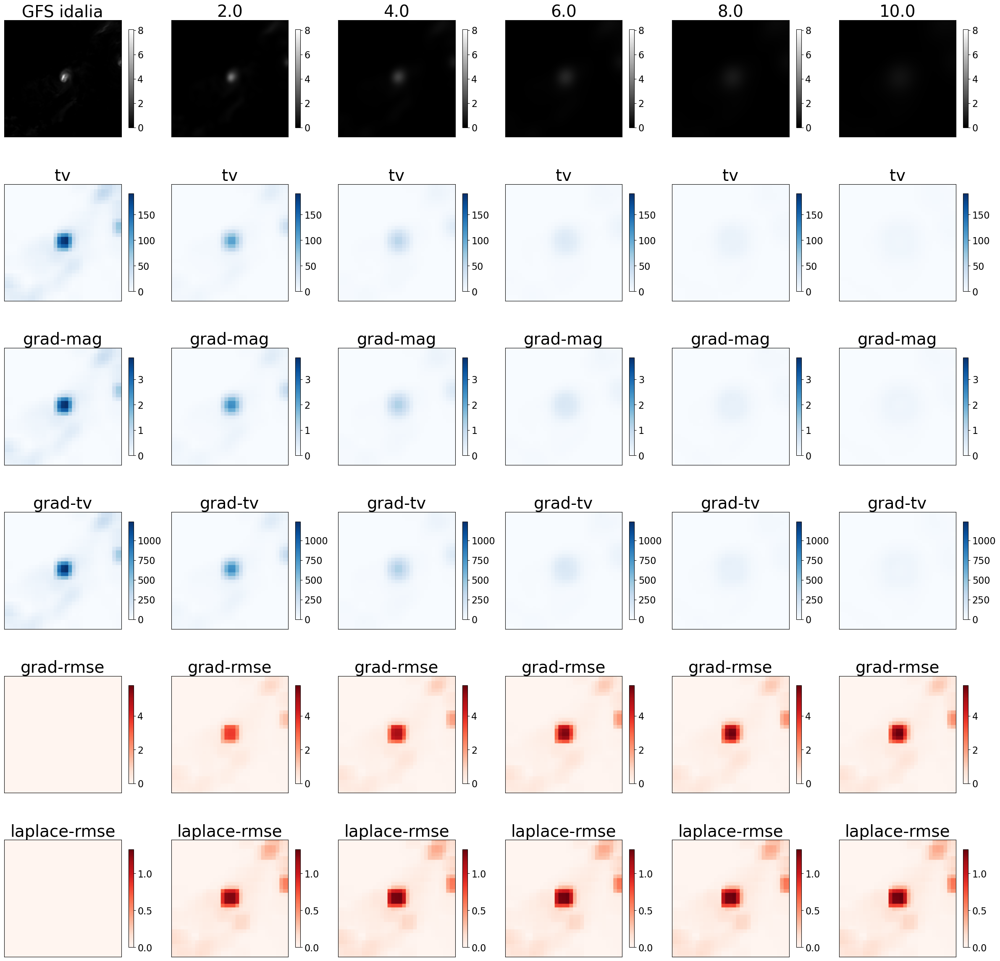


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS idalia_group_2_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS idalia_group_2_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS idalia_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS idalia  : 0.06
	2.0         : 0.06
	4.0         : 0.06
	6.0         : 0.06
	8.0         : 0.06
	10.0        : 0.06

intensity - max:
	GFS idalia  : 8.05
	2.0         : 3.88
	4.0         : 2.04
	6.0         : 1.20
	8.0         : 0.79
	10.0        : 0.56

##### tv #####

tv - min:
	GFS idalia  : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

tv - mean:
	GFS idalia  : 9.80
	2.0         : 4.58
	4.0         : 2.93
	6.0         : 2.12
	8.0         

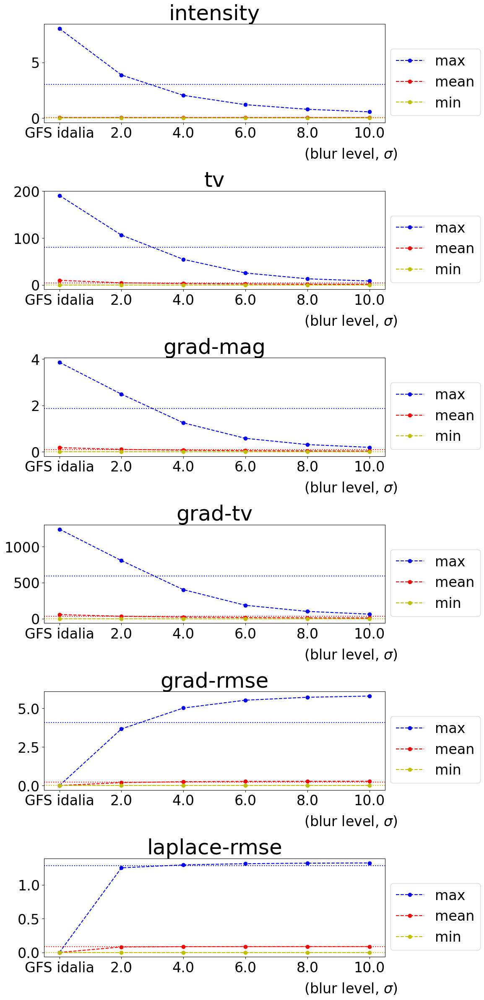

Saving results to EXP_blurring_gradually_starting_with_GFS idalia_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS idalia, 2.0, 4.0, 6.0, 8.0, 10.0

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 6 inputs took 0.5926921907812357 seconds

Computing fourier-tv
Done! 6 inputs took 0.5685275737196207 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
2468 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
1444 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
884 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
468 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
180 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
20 NaNs out of 16384 total blocks in image 1
Done! 6 inputs took 7.008109021931887 seconds

Computing s1
NaNs encountered in s1:
16384 NaNs out of 16384 total blocks in image 0
16384 NaNs out of 16384 total blocks in image 1
NaNs encountered in s1:
16384 NaNs out of 16384 total blocks in image

/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:207: RuntimeWarning: All-NaN axis encountered
  row_cmin = np.nanmin(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:208: RuntimeWarning: All-NaN axis encountered
  row_cmax = np.nanmax(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]


Done! 6 inputs took 1.1207558028399944 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

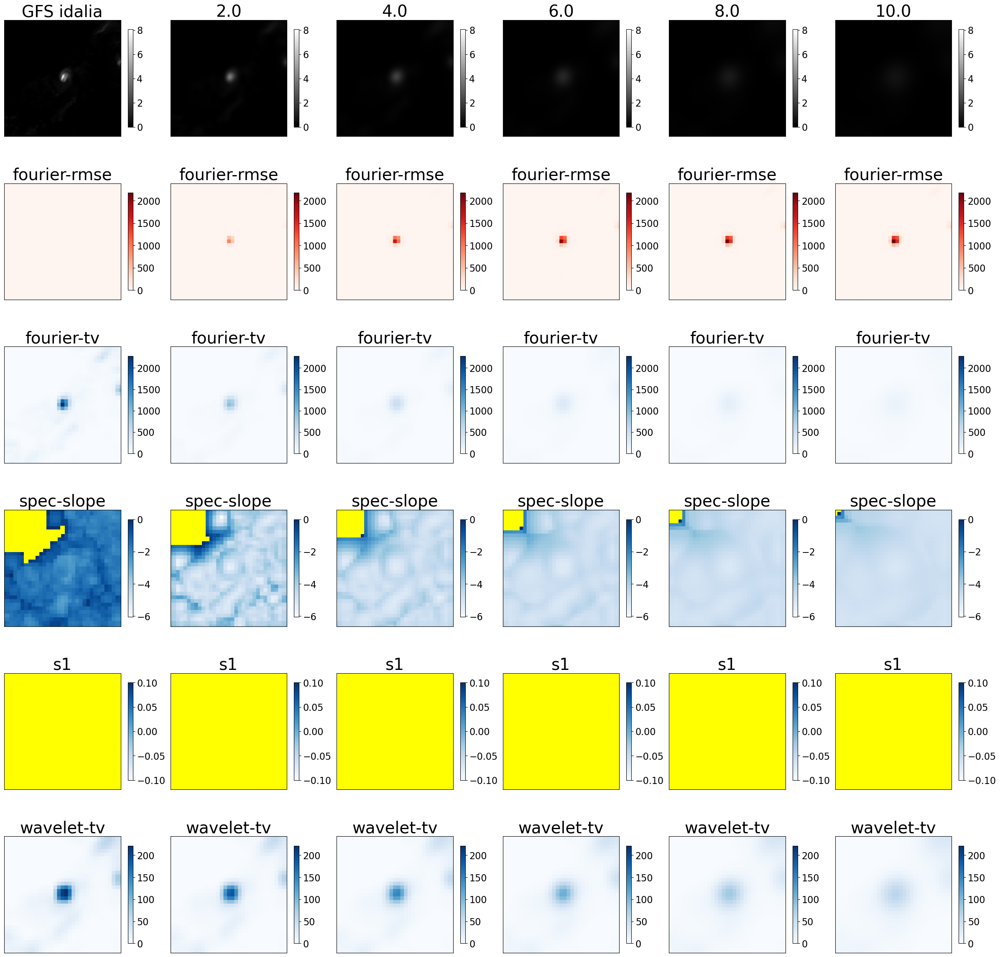


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS idalia_group_3_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS idalia_group_3_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS idalia_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS idalia  : 0.06
	2.0         : 0.06
	4.0         : 0.06
	6.0         : 0.06
	8.0         : 0.06
	10.0        : 0.06

intensity - max:
	GFS idalia  : 8.05
	2.0         : 3.88
	4.0         : 2.04
	6.0         : 1.20
	8.0         : 0.79
	10.0        : 0.56

##### fourier-rmse #####

fourier-rmse - min:
	GFS idalia  : 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

fourier-rmse - mean:
	GFS idalia  : 0.00
	2.0         : 3.21
	4.0         : 6.99
	6.

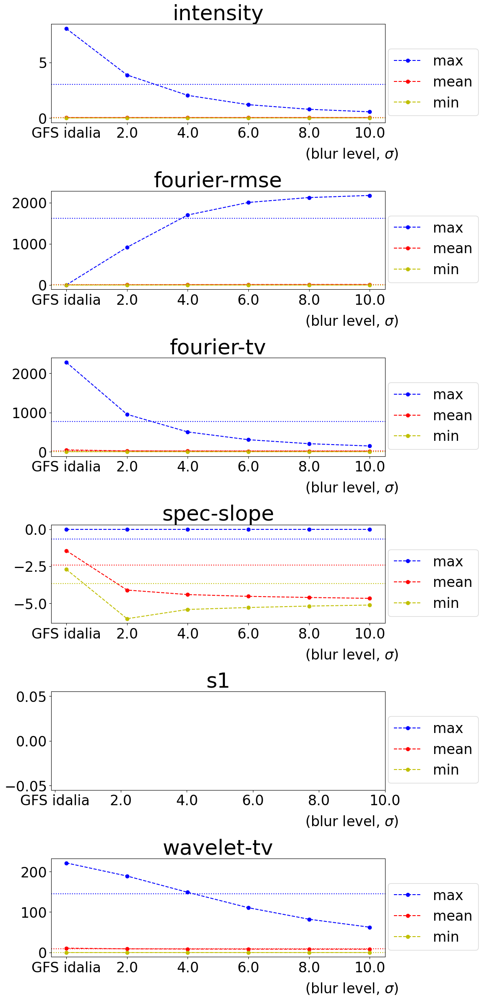

Saving results to EXP_blurring_gradually_starting_with_GFS idalia_group_3_stats_plots.pdf
Computing transforms...


100%|██████████| 5/5 [00:00<00:00, 1322.29it/s]

Computing heatmaps for rmse, ssim
on GFS idalia, 0.2, 0.4, 0.6, 0.8, 1.0



##############################

Computing rmse
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 6 inputs took 0.08265730738639832 seconds

Computing ssim
Done! 6 inputs took 0.9722020104527473 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

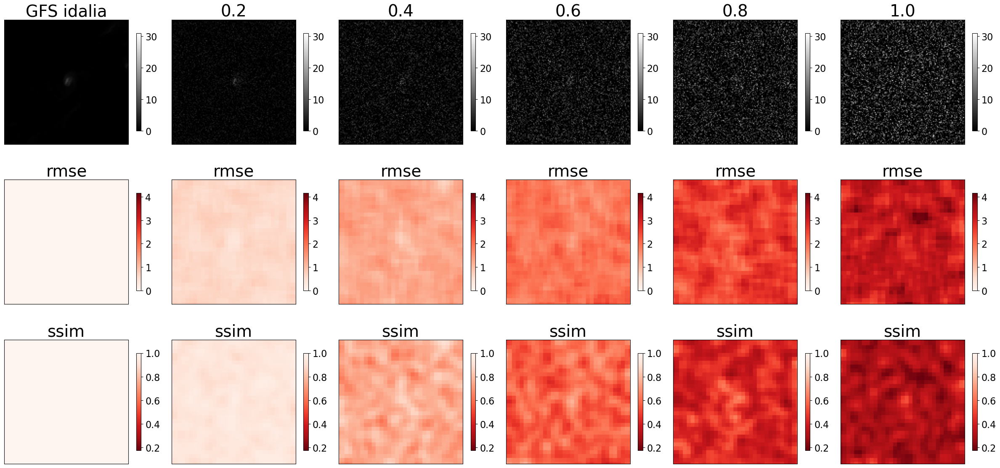


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS idalia_group_1_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS idalia_group_1_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS idalia_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS idalia  : 0.06
	0.2         : 0.69
	0.4         : 1.34
	0.6         : 1.97
	0.8         : 2.62
	1.0         : 3.26

intensity - max:
	GFS idalia  : 8.05
	0.2         : 9.87
	0.4         : 14.85
	0.6         : 19.13
	0.8         : 27.62
	1.0         : 30.87

##### rmse #####

rmse - min:
	GFS idalia  : 0.00
	0.2         : 0.36
	0.4         : 0.61
	0.6         : 1.32
	0.8         : 1.76
	1.0         : 2.15

rmse - mean:
	GFS idalia  : 0.00
	0.2         : 0.63
	0.4         : 1.28
	0.6       

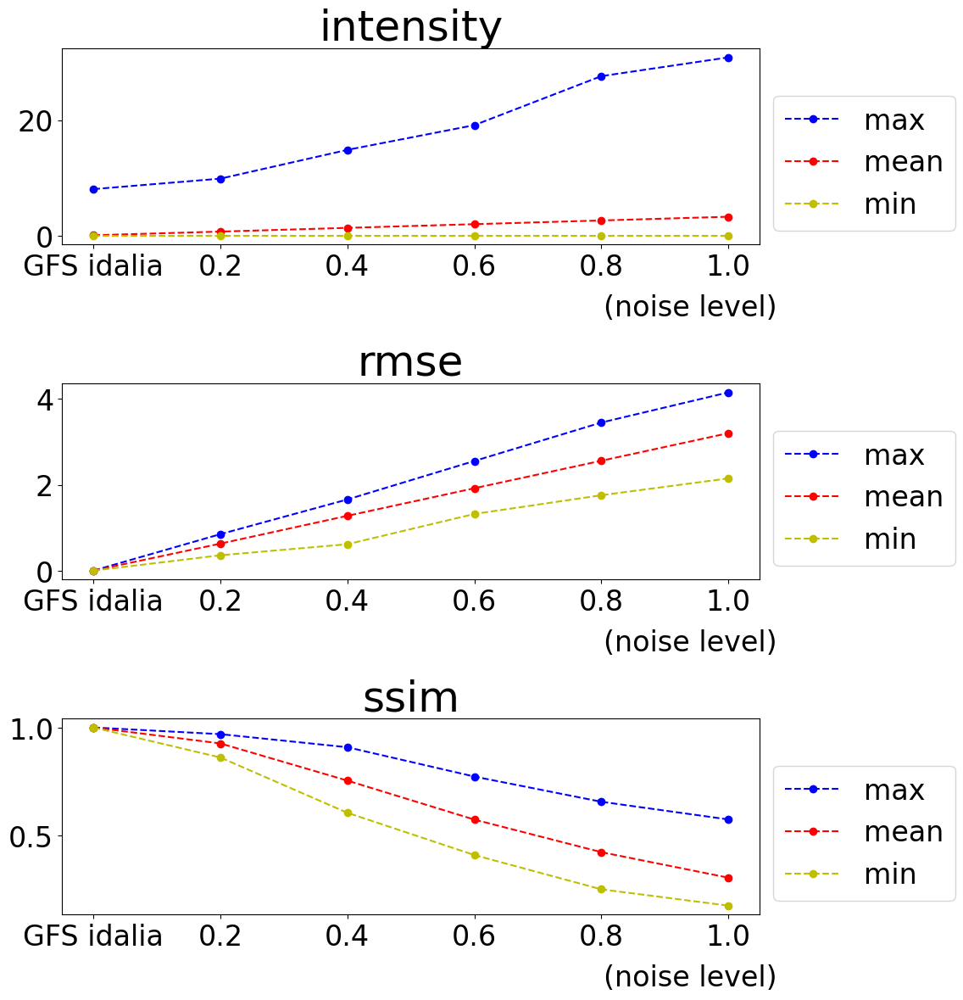

Saving results to EXP_adding_noise_gradually_starting_with_GFS idalia_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS idalia, 0.2, 0.4, 0.6, 0.8, 1.0

##############################

Computing tv
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 6 inputs took 0.1812438778579235 seconds

Computing grad-mag
Done! 6 inputs took 0.3099051620811224 seconds

Computing grad-tv
Done! 6 inputs took 0.28171607479453087 seconds

Computing grad-rmse
Done! 6 inputs took 0.26354673877358437 seconds

Co

<Figure size 640x480 with 0 Axes>

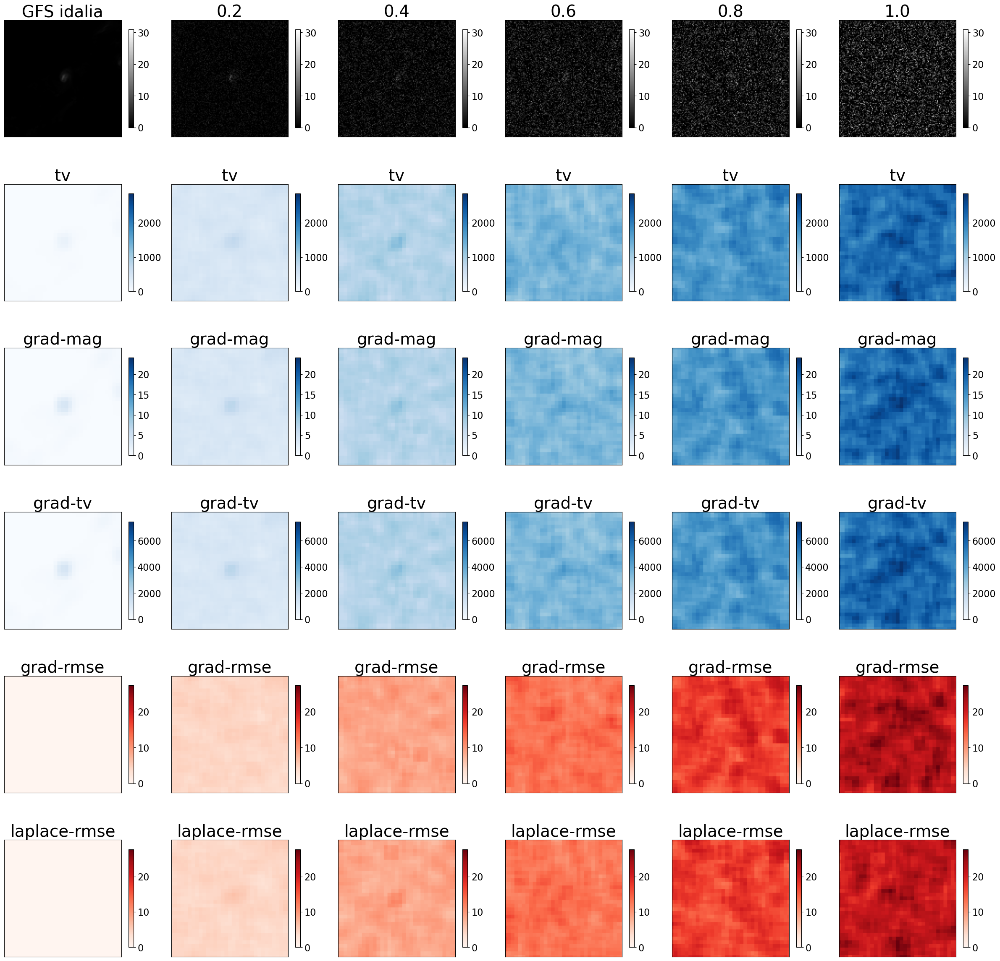


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS idalia_group_2_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS idalia_group_2_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS idalia_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS idalia  : 0.06
	0.2         : 0.69
	0.4         : 1.34
	0.6         : 1.97
	0.8         : 2.62
	1.0         : 3.26

intensity - max:
	GFS idalia  : 8.05
	0.2         : 9.87
	0.4         : 14.85
	0.6         : 19.13
	0.8         : 27.62
	1.0         : 30.87

##### tv #####

tv - min:
	GFS idalia  : 0.00
	0.2         : 313.85
	0.4         : 615.53
	0.6         : 936.83
	0.8         : 1297.58
	1.0         : 1593.69

tv - mean:
	GFS idalia  : 9.80
	0.2         : 455.52
	0.4         : 897.30
	

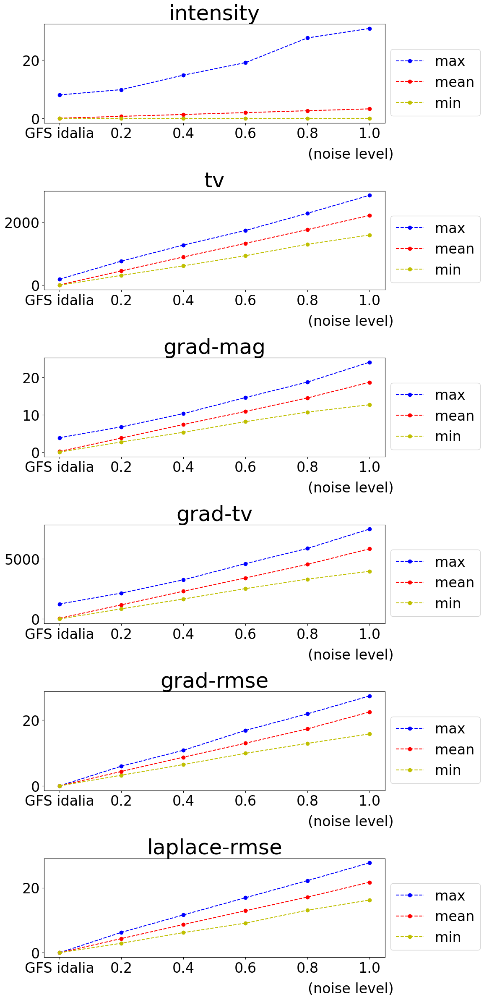

Saving results to EXP_adding_noise_gradually_starting_with_GFS idalia_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS idalia, 0.2, 0.4, 0.6, 0.8, 1.0

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Heatmap will be computed with blocks of size 16, and has image padding of length 8
Done! 6 inputs took 0.593319047242403 seconds

Computing fourier-tv
Done! 6 inputs took 0.5676113720983267 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
2468 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
0 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
0 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
0 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
0 NaNs out of 16384 total blocks in image 1
NaNs encountered in spec_slope:
2468 NaNs out of 16384 total blocks in image 0
0 NaNs out of 16384 total blocks in image 1
Done! 6 inputs took 7.005899954587221 seconds

Computing s1
NaNs encountered in s1:
16384 NaNs out of 16384 total blocks in image 0
16384 NaNs out of 16384 total blocks in image 1
NaNs encountered in s1:
16384 NaNs out of 16384 total blocks in image 0
16384 N

/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]


Done! 6 inputs took 1.1128012407571077 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

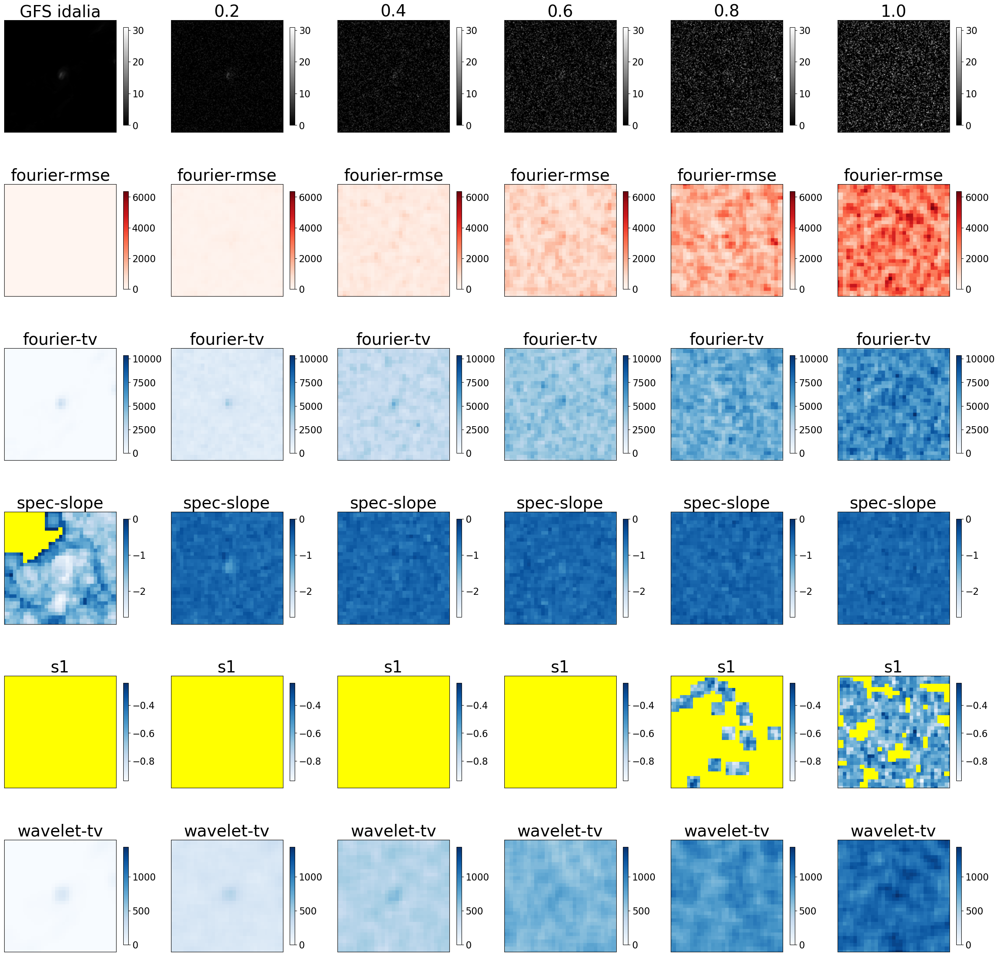


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS idalia_group_3_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS idalia_group_3_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS idalia_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS idalia  : 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS idalia  : 0.06
	0.2         : 0.69
	0.4         : 1.34
	0.6         : 1.97
	0.8         : 2.62
	1.0         : 3.26

intensity - max:
	GFS idalia  : 8.05
	0.2         : 9.87
	0.4         : 14.85
	0.6         : 19.13
	0.8         : 27.62
	1.0         : 30.87

##### fourier-rmse #####

fourier-rmse - min:
	GFS idalia  : 0.00
	0.2         : 33.62
	0.4         : 114.33
	0.6         : 252.35
	0.8         : 385.08
	1.0         : 645.88

fourier-rmse - mean:
	GFS idalia  : 0.00
	0.2         : 118

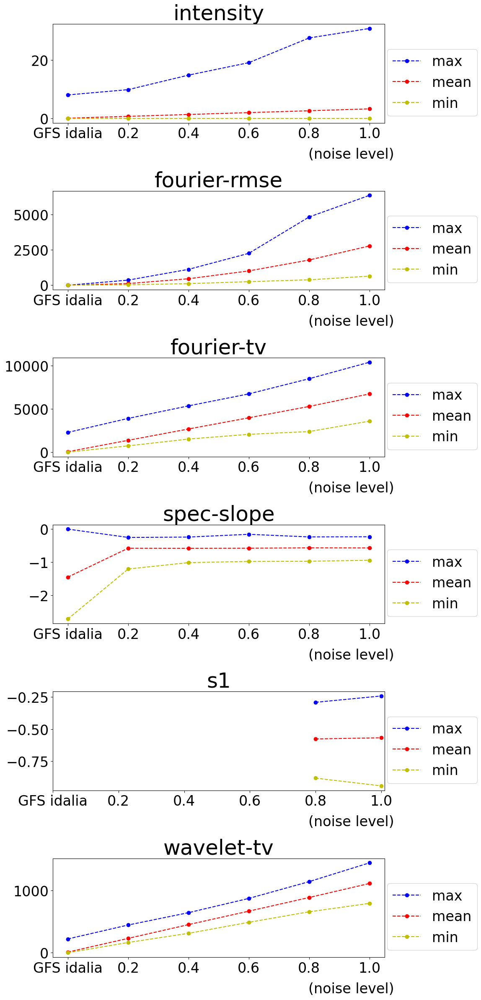

Saving results to EXP_adding_noise_gradually_starting_with_GFS idalia_group_3_stats_plots.pdf
flashflood
(64, 64)
(64, 64)
Computing heatmaps for rmse, ssim
on GFS flashflood, GC  flashflood

##############################

Computing rmse
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 2 inputs took 0.02246689423918724 seconds

Computing ssim
Done! 2 inputs took 0.2910111080855131 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

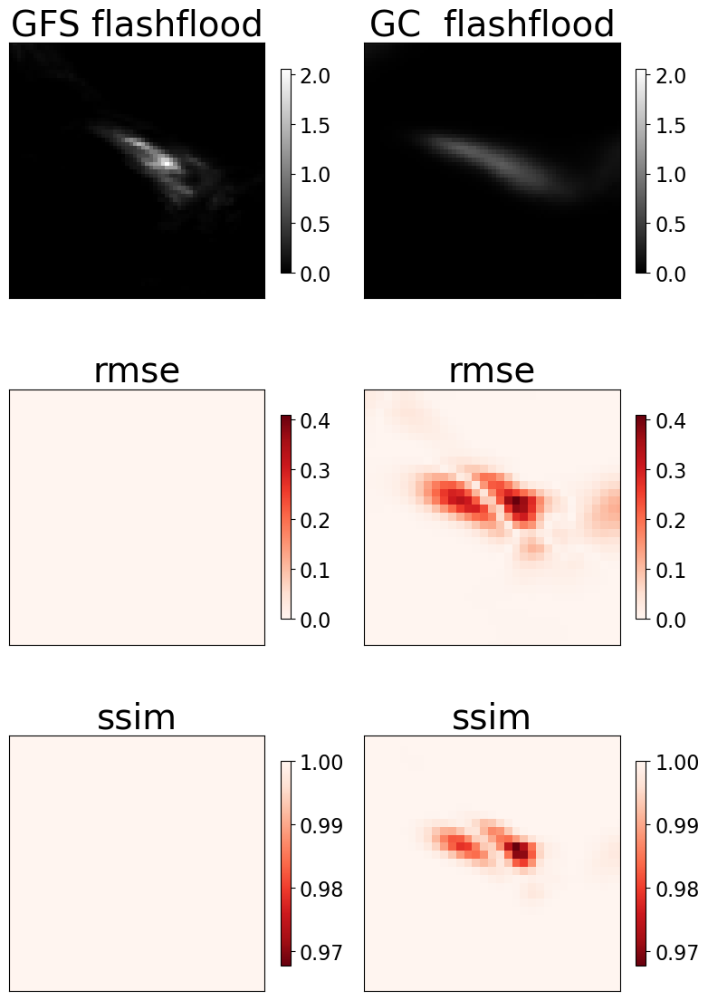


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_1_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_1_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	GC  flashflood: -0.00

intensity - mean:
	GFS flashflood: 0.03
	GC  flashflood: 0.04

intensity - max:
	GFS flashflood: 2.06
	GC  flashflood: 0.74

##### rmse #####

rmse - min:
	GFS flashflood: 0.00
	GC  flashflood: 0.00

rmse - mean:
	GFS flashflood: 0.00
	GC  flashflood: 0.02

rmse - max:
	GFS flashflood: 0.00
	GC  flashflood: 0.41

##### ssim #####

ssim - min:
	GFS flashflood: 1.00
	GC  flashflood: 0.97

ssim - mean:
	GFS flashflood: 1.00
	GC  flashflood: 1.00

ssim - max:
	GFS flashflood: 1.00
	GC  flashflood: 1.00



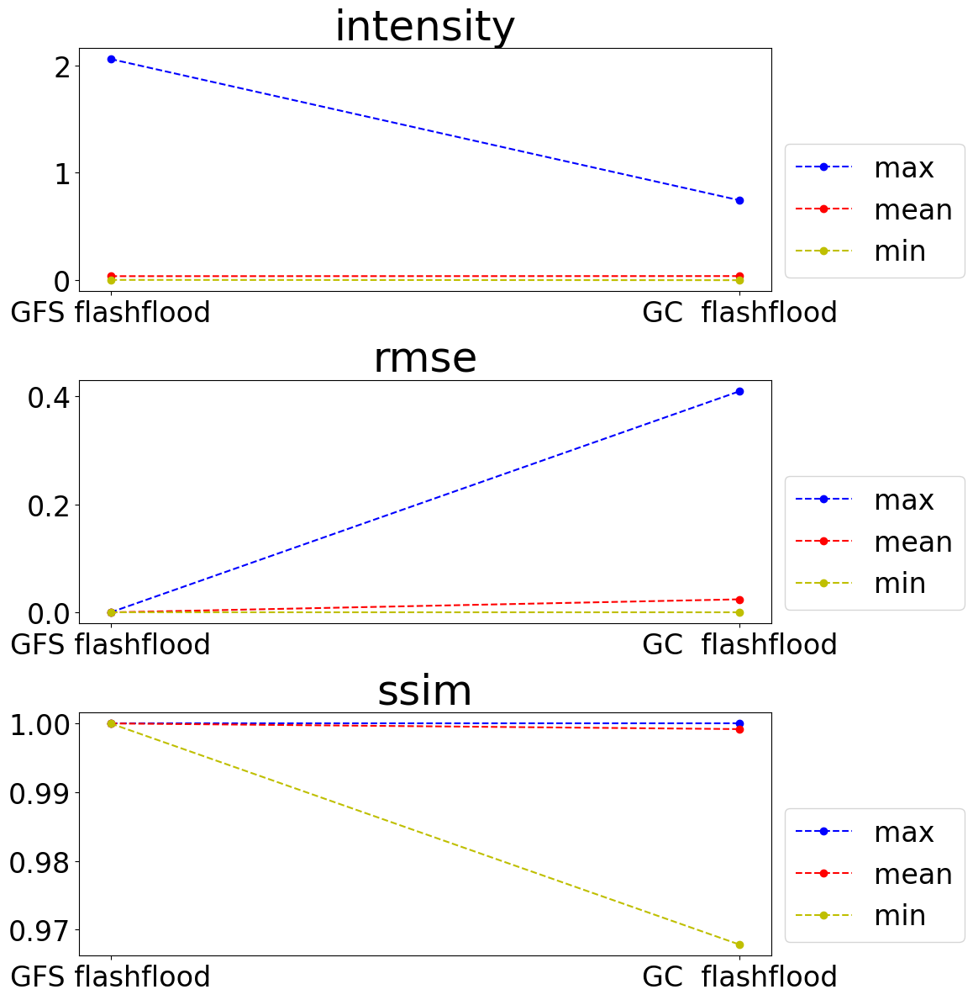

Saving results to EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS flashflood, GC  flashflood

##############################

Computing tv
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 2 inputs took 0.05592467449605465 seconds

Computing grad-mag
Done! 2 inputs took 0.0925766471773386 seconds

Computing grad-tv
Done! 2 inputs took 0.08752187713980675 seconds

Computing grad-rmse
Done! 2 inputs took 0.07775655575096607 seconds

Computing laplace-rmse
Done! 2 inputs took 0.04247288033366203 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

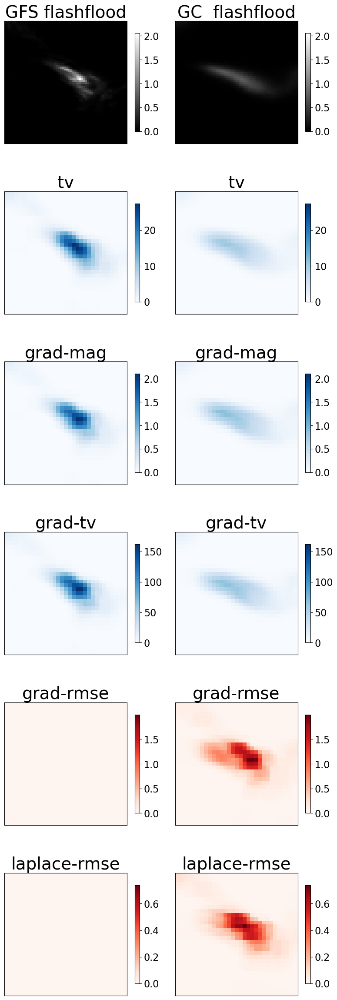


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_2_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_2_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	GC  flashflood: -0.00

intensity - mean:
	GFS flashflood: 0.03
	GC  flashflood: 0.04

intensity - max:
	GFS flashflood: 2.06
	GC  flashflood: 0.74

##### tv #####

tv - min:
	GFS flashflood: 0.00
	GC  flashflood: 0.01

tv - mean:
	GFS flashflood: 1.49
	GC  flashflood: 0.89

tv - max:
	GFS flashflood: 27.43
	GC  flashflood: 10.39

##### grad-mag #####

grad-mag - min:
	GFS flashflood: 0.00
	GC  flashflood: 0.00

grad-mag - mean:
	GFS flashflood: 0.11
	GC  flashflood: 0.08

grad-mag - max:
	GFS flashflood: 2.10
	GC  flashflood: 0.89

##### grad-tv #####

grad-tv - min:
	GFS flashflood: 0.00


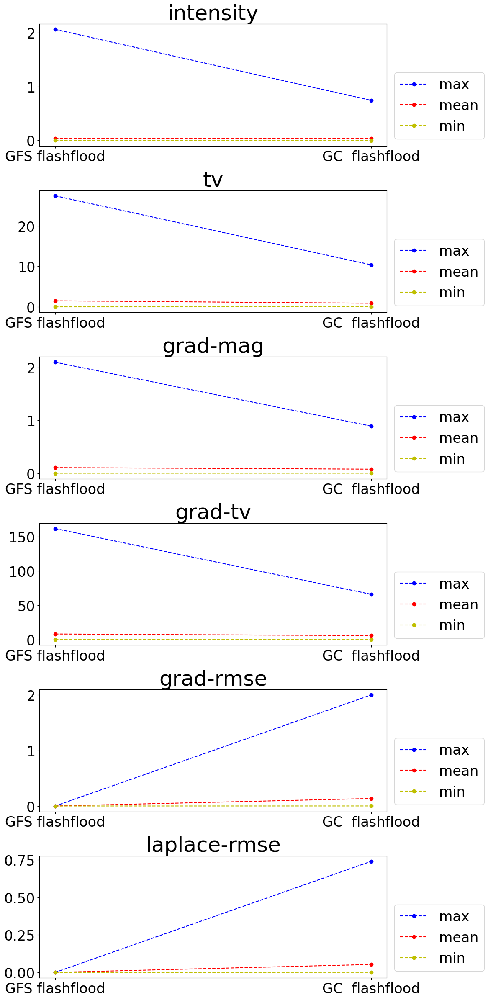

Saving results to EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS flashflood, GC  flashflood

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 2 inputs took 0.19061455130577087 seconds

Computing fourier-tv
Done! 2 inputs took 0.17481247521936893 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
2012 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
Done! 2 inputs took 1.886428451165557 seconds

Computing s1
NaNs encountered in s1:
4096 NaNs out of 4096 total blocks in image 0
4096 NaNs out of 4096 total blocks in image 1
NaNs encountered in s1:
4096 NaNs out of 4096 total blocks in image 0
4096 NaNs out of 4096 total blocks in image 1
Done! 2 inputs took 0.0585443414747715 seconds

Computing wavelet-tv


/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:207: RuntimeWarning: All-NaN axis encountered
  row_cmin = np.nanmin(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:208: RuntimeWarning: All-NaN axis encountered
  row_cmax = np.nanmax(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]


Done! 2 inputs took 0.36647588945925236 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

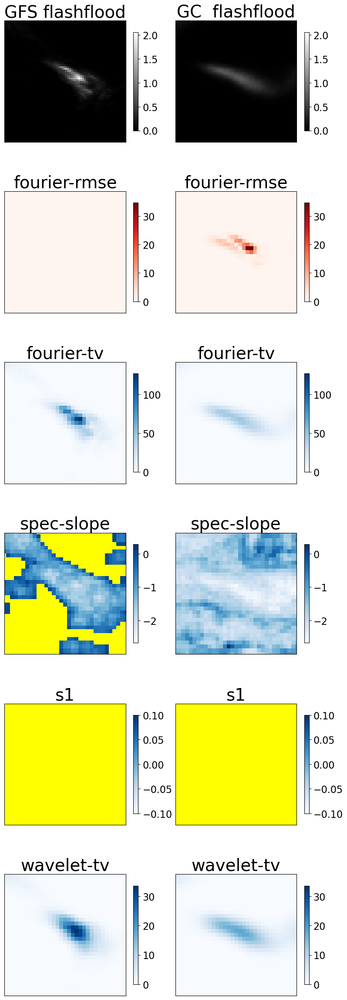


Saving results to ../media/paper_figures/EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_3_heatmaps.pdf
Writing summary statistics to file EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_3_stats_summary.txt
This file is:  EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	GC  flashflood: -0.00

intensity - mean:
	GFS flashflood: 0.03
	GC  flashflood: 0.04

intensity - max:
	GFS flashflood: 2.06
	GC  flashflood: 0.74

##### fourier-rmse #####

fourier-rmse - min:
	GFS flashflood: 0.00
	GC  flashflood: 0.00

fourier-rmse - mean:
	GFS flashflood: 0.00
	GC  flashflood: 0.40

fourier-rmse - max:
	GFS flashflood: 0.00
	GC  flashflood: 34.63

##### fourier-tv #####

fourier-tv - min:
	GFS flashflood: 0.00
	GC  flashflood: 0.01

fourier-tv - mean:
	GFS flashflood: 3.70
	GC  flashflood: 2.97

fourier-tv - max:
	GFS flashflood: 127.08
	GC  flashflood: 47.72

##### sp

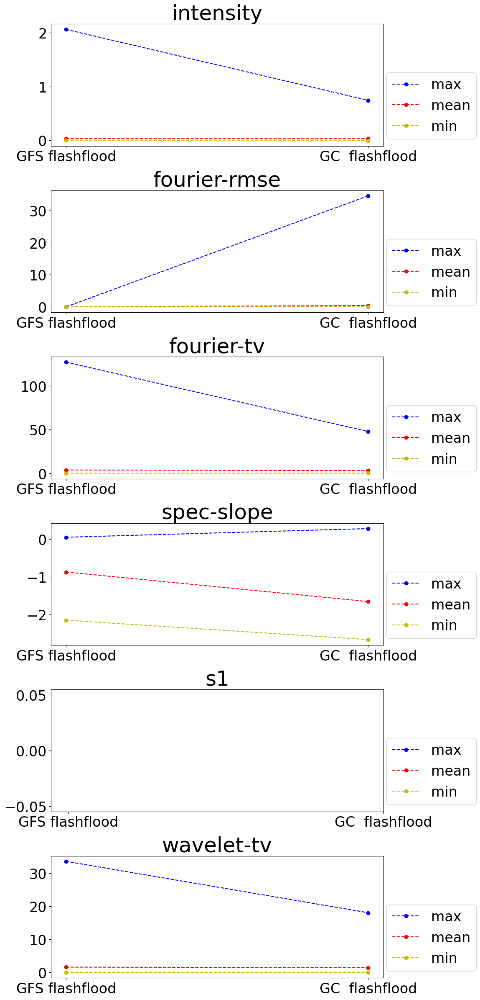

Saving results to EXP_GraphCast_GFS_with_C_GFS flashflood_vs_GC  flashflood_group_3_stats_plots.pdf
Computing transforms...


100%|██████████| 5/5 [00:00<00:00, 2551.28it/s]

Computing heatmaps for rmse, ssim
on GFS flashflood, 2.0, 4.0, 6.0, 8.0, 10.0



##############################

Computing rmse
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 6 inputs took 0.06826956011354923 seconds

Computing ssim
Done! 6 inputs took 0.873184971511364 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

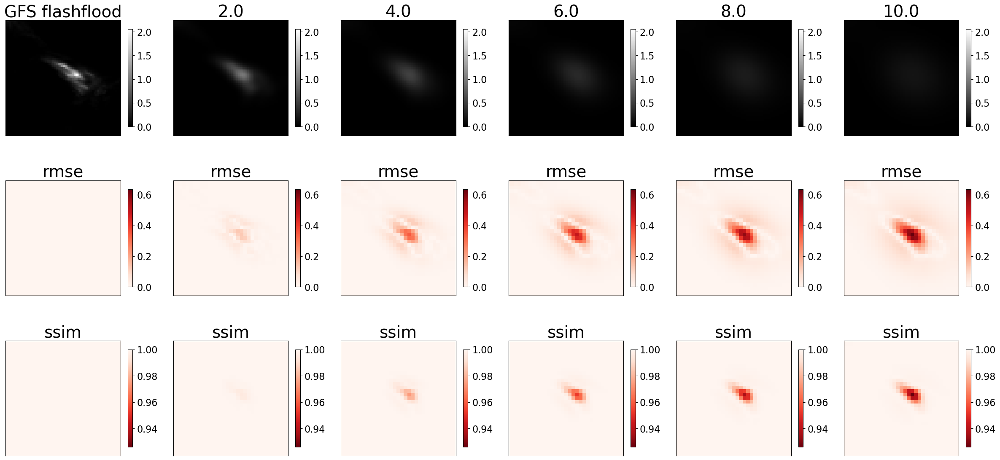


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS flashflood_group_1_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS flashflood_group_1_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS flashflood_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS flashflood: 0.03
	2.0         : 0.03
	4.0         : 0.03
	6.0         : 0.03
	8.0         : 0.03
	10.0        : 0.03

intensity - max:
	GFS flashflood: 2.06
	2.0         : 0.97
	4.0         : 0.53
	6.0         : 0.33
	8.0         : 0.22
	10.0        : 0.16

##### rmse #####

rmse - min:
	GFS flashflood: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

rmse - mean:
	GFS flashflood: 0.00
	2.0         : 0.01
	4.0         : 0.01
	6.0 

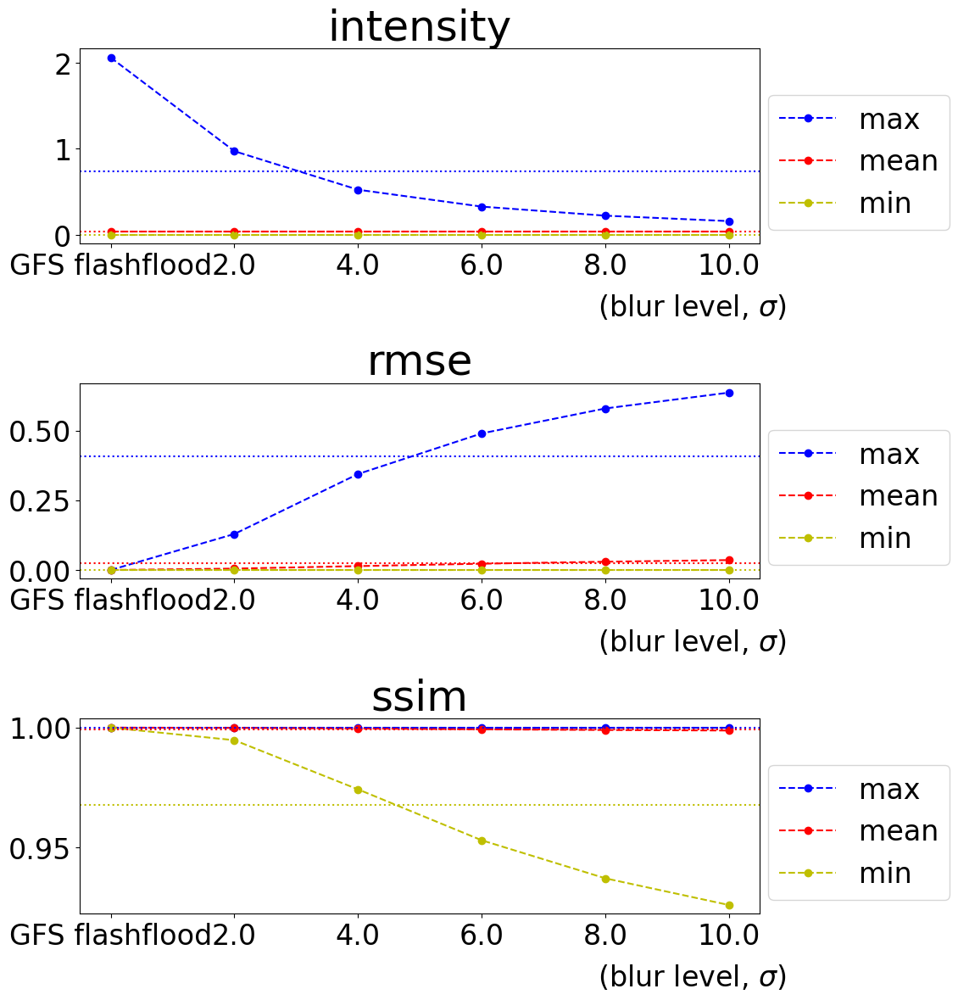

Saving results to EXP_blurring_gradually_starting_with_GFS flashflood_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS flashflood, 2.0, 4.0, 6.0, 8.0, 10.0

##############################

Computing tv
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 6 inputs took 0.16979850083589554 seconds

Computing grad-mag
Done! 6 inputs took 0.2678345497697592 seconds

Computing grad-tv
Done! 6 inputs took 0.25103204511106014 seconds

Computing grad-rmse
Done! 6 inputs took 0.22385738790035248 seconds

Co

<Figure size 640x480 with 0 Axes>

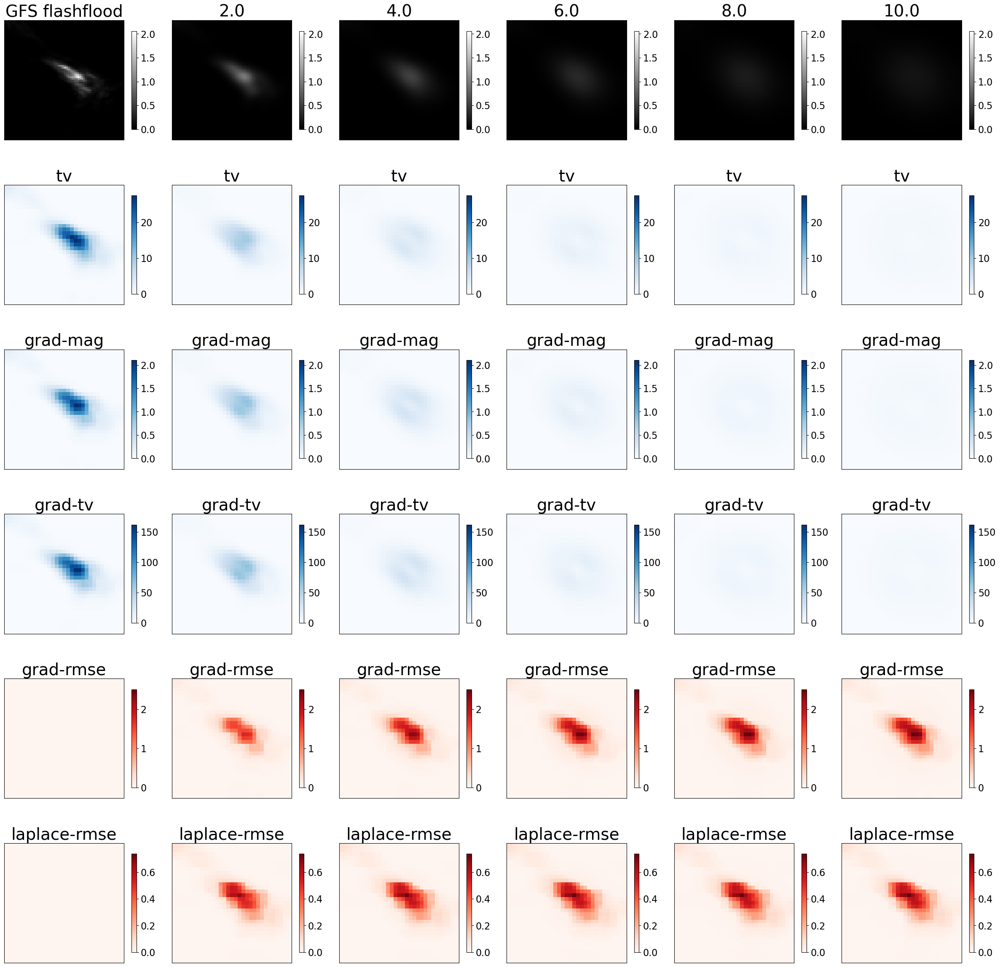


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS flashflood_group_2_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS flashflood_group_2_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS flashflood_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS flashflood: 0.03
	2.0         : 0.03
	4.0         : 0.03
	6.0         : 0.03
	8.0         : 0.03
	10.0        : 0.03

intensity - max:
	GFS flashflood: 2.06
	2.0         : 0.97
	4.0         : 0.53
	6.0         : 0.33
	8.0         : 0.22
	10.0        : 0.16

##### tv #####

tv - min:
	GFS flashflood: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

tv - mean:
	GFS flashflood: 1.49
	2.0         : 0.74
	4.0         : 0.50
	6.0       

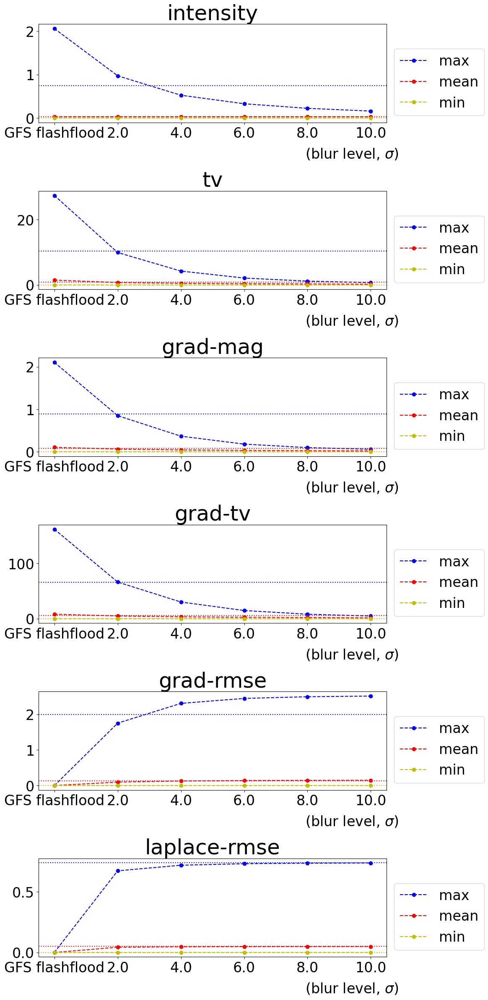

Saving results to EXP_blurring_gradually_starting_with_GFS flashflood_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS flashflood, 2.0, 4.0, 6.0, 8.0, 10.0

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 6 inputs took 0.5430314783006907 seconds

Computing fourier-tv
Done! 6 inputs took 0.5175147820264101 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
2012 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
452 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
65 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
Done! 6 inputs took 5.613931262865663 seconds

Computing s1
NaNs encountered in s1:
4096 NaNs out of 4096 total blocks in image 0
4096 NaNs out of 4096 total blocks in image 1
NaNs encountered in s1:
4096 NaNs out of 4096 total blocks in image 0
4096 NaNs out of 4096 

/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:207: RuntimeWarning: All-NaN axis encountered
  row_cmin = np.nanmin(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:208: RuntimeWarning: All-NaN axis encountered
  row_cmax = np.nanmax(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]


Done! 6 inputs took 1.0911604519933462 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

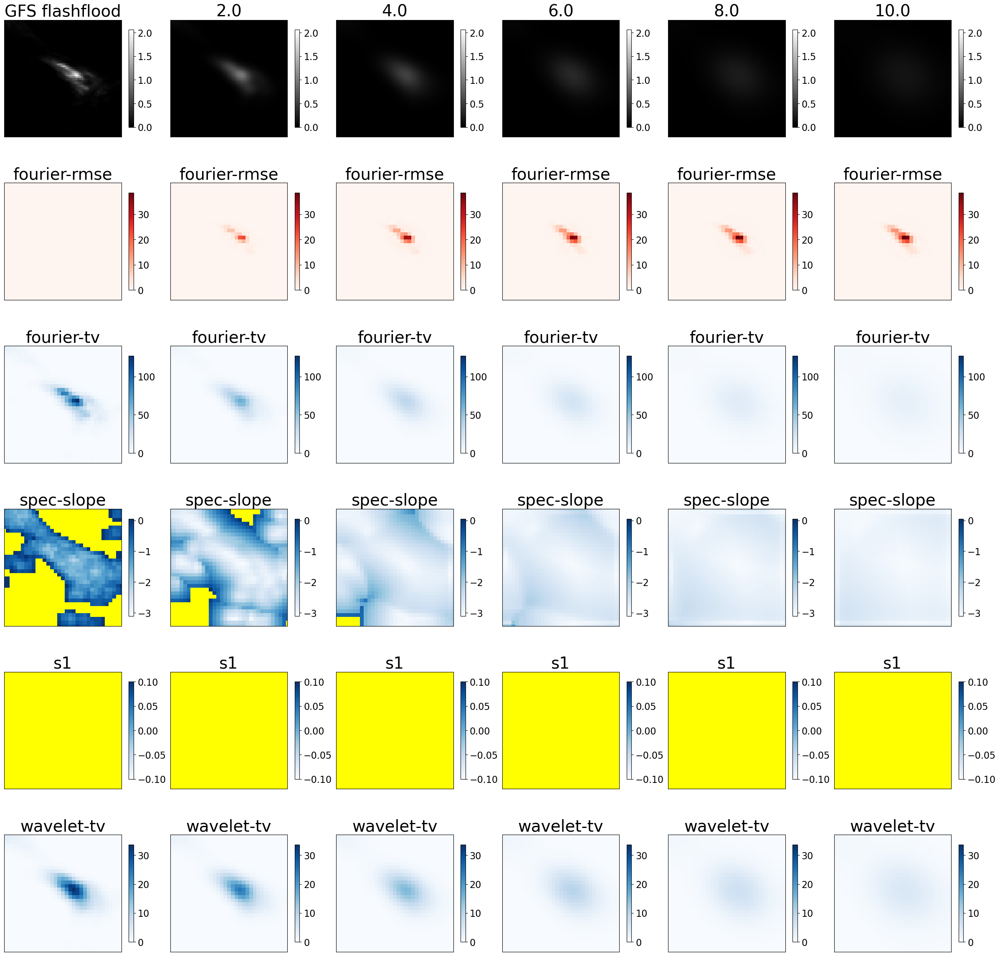


Saving results to ../media/paper_figures/EXP_blurring_gradually_starting_with_GFS flashflood_group_3_heatmaps.pdf
Writing summary statistics to file EXP_blurring_gradually_starting_with_GFS flashflood_group_3_stats_summary.txt
This file is:  EXP_blurring_gradually_starting_with_GFS flashflood_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

intensity - mean:
	GFS flashflood: 0.03
	2.0         : 0.03
	4.0         : 0.03
	6.0         : 0.03
	8.0         : 0.03
	10.0        : 0.03

intensity - max:
	GFS flashflood: 2.06
	2.0         : 0.97
	4.0         : 0.53
	6.0         : 0.33
	8.0         : 0.22
	10.0        : 0.16

##### fourier-rmse #####

fourier-rmse - min:
	GFS flashflood: 0.00
	2.0         : 0.00
	4.0         : 0.00
	6.0         : 0.00
	8.0         : 0.00
	10.0        : 0.00

fourier-rmse - mean:
	GFS flashflood: 0.00
	2.0         : 0.18
	

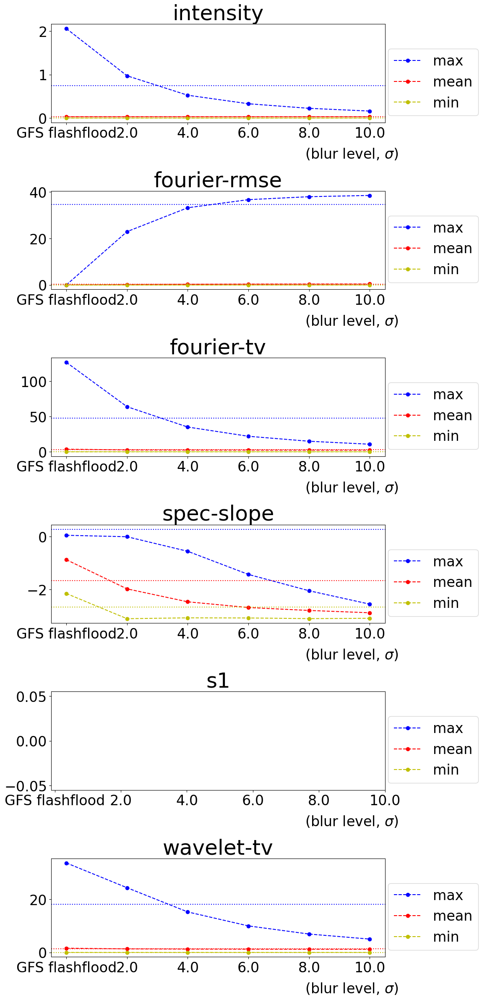

Saving results to EXP_blurring_gradually_starting_with_GFS flashflood_group_3_stats_plots.pdf
Computing transforms...


100%|██████████| 5/5 [00:00<00:00, 3826.22it/s]

Computing heatmaps for rmse, ssim
on GFS flashflood, 0.2, 0.4, 0.6, 0.8, 1.0



##############################

Computing rmse
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 6 inputs took 0.06736808083951473 seconds

Computing ssim
Done! 6 inputs took 0.8737517334520817 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

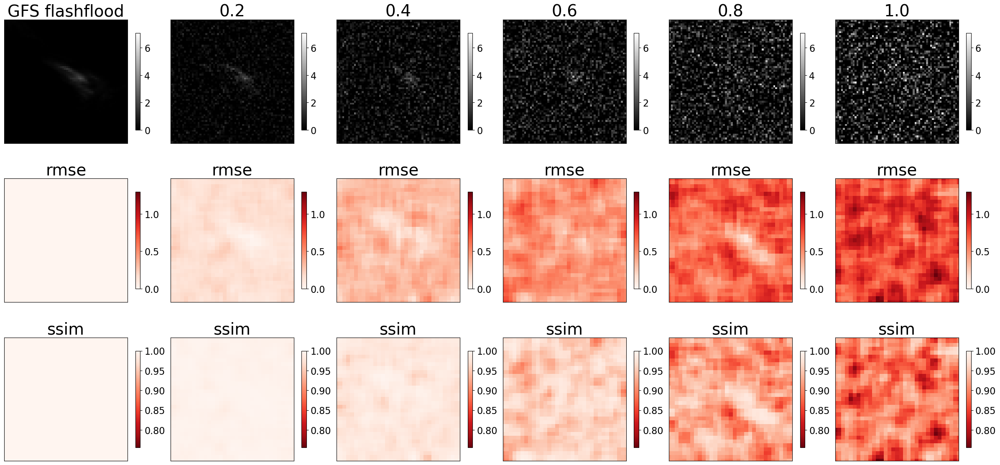


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS flashflood_group_1_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS flashflood_group_1_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS flashflood_group_1_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS flashflood: 0.03
	0.2         : 0.18
	0.4         : 0.35
	0.6         : 0.51
	0.8         : 0.69
	1.0         : 0.83

intensity - max:
	GFS flashflood: 2.06
	0.2         : 2.78
	0.4         : 3.02
	0.6         : 4.94
	0.8         : 5.64
	1.0         : 7.06

##### rmse #####

rmse - min:
	GFS flashflood: 0.00
	0.2         : 0.00
	0.4         : 0.08
	0.6         : 0.17
	0.8         : 0.10
	1.0         : 0.38

rmse - mean:
	GFS flashflood: 0.00
	0.2         : 0.15
	0.4         

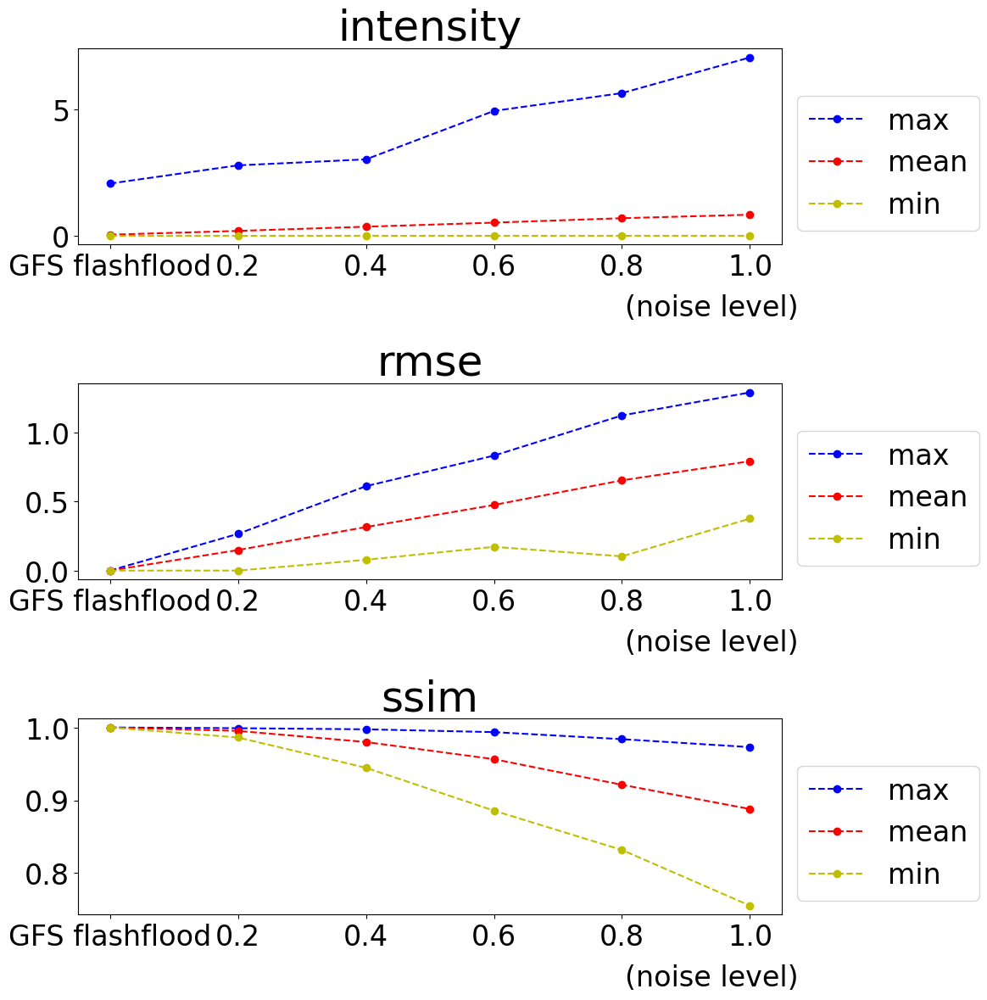

Saving results to EXP_adding_noise_gradually_starting_with_GFS flashflood_group_1_stats_plots.pdf
Computing heatmaps for tv, grad-mag, grad-tv, grad-rmse, laplace-rmse
on GFS flashflood, 0.2, 0.4, 0.6, 0.8, 1.0

##############################

Computing tv
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 6 inputs took 0.16591165028512478 seconds

Computing grad-mag
Done! 6 inputs took 0.26797990873456 seconds

Computing grad-tv
Done! 6 inputs took 0.24864518456161022 seconds

Computing grad-rmse
Done! 6 inputs took 0.22448397614061832 seconds

C

<Figure size 640x480 with 0 Axes>

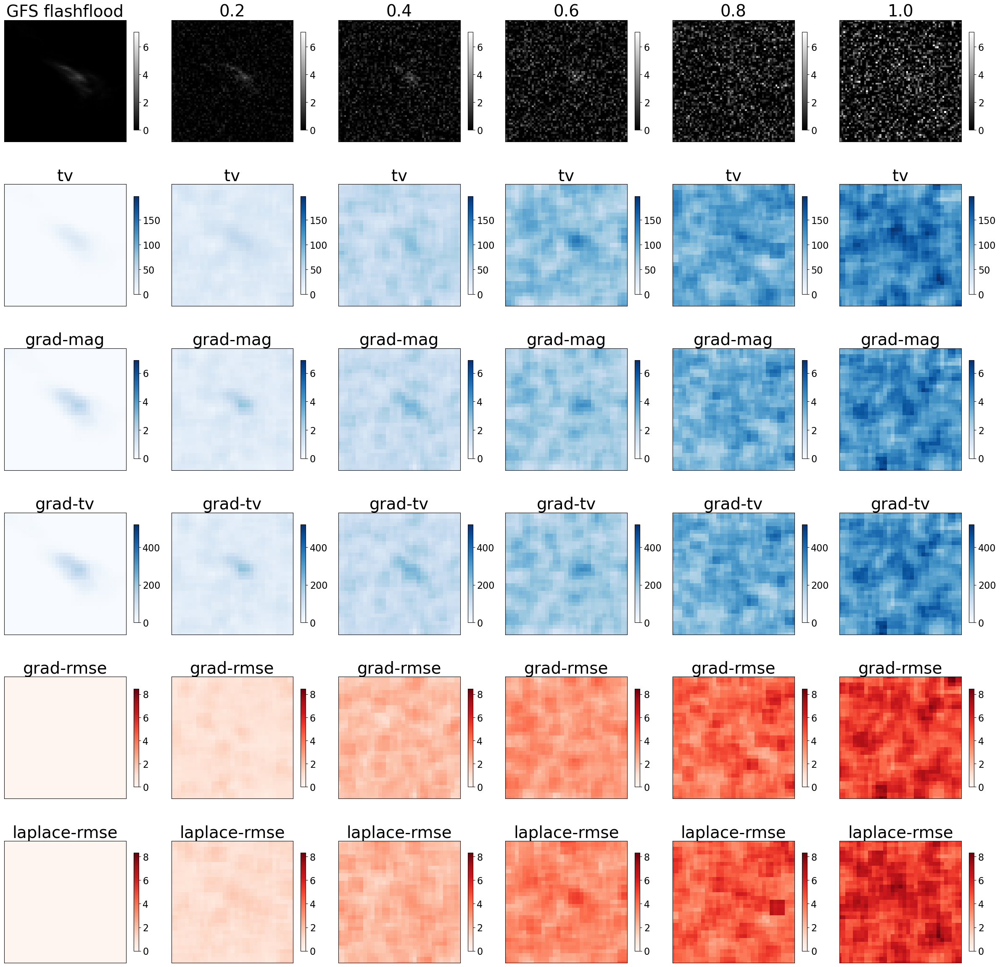


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS flashflood_group_2_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS flashflood_group_2_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS flashflood_group_2_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS flashflood: 0.03
	0.2         : 0.18
	0.4         : 0.35
	0.6         : 0.51
	0.8         : 0.69
	1.0         : 0.83

intensity - max:
	GFS flashflood: 2.06
	0.2         : 2.78
	0.4         : 3.02
	0.6         : 4.94
	0.8         : 5.64
	1.0         : 7.06

##### tv #####

tv - min:
	GFS flashflood: 0.00
	0.2         : 12.99
	0.4         : 24.79
	0.6         : 38.80
	0.8         : 50.21
	1.0         : 65.87

tv - mean:
	GFS flashflood: 1.49
	0.2         : 27.18
	0.4         

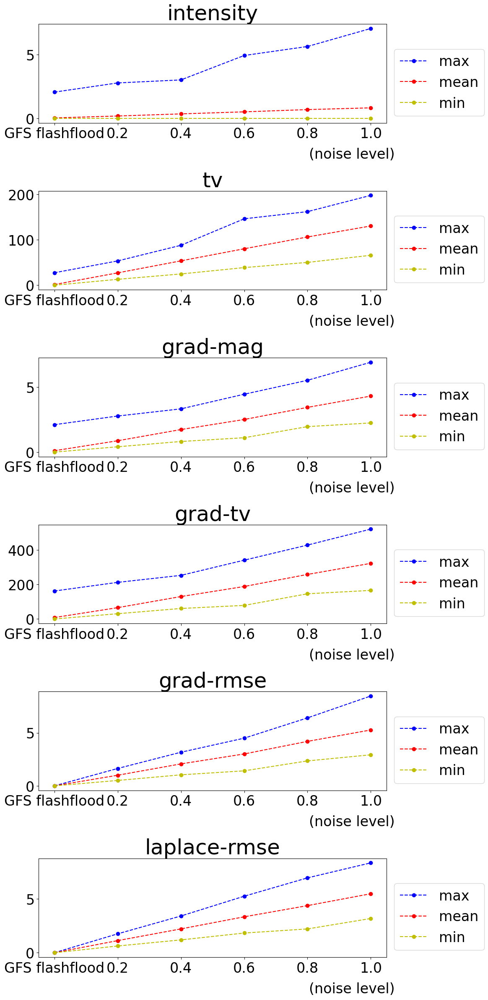

Saving results to EXP_adding_noise_gradually_starting_with_GFS flashflood_group_2_stats_plots.pdf
Computing heatmaps for fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on GFS flashflood, 0.2, 0.4, 0.6, 0.8, 1.0

##############################

Computing fourier-rmse
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Heatmap will be computed with blocks of size 8, and has image padding of length 4
Done! 6 inputs took 0.5416567530483007 seconds

Computing fourier-tv
Done! 6 inputs took 0.5174069385975599 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
2012 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
NaNs encountered in spec_slope:
2012 NaNs out of 4096 total blocks in image 0
0 NaNs out of 4096 total blocks in image 1
Done! 6 inputs took 5.60966007784009 seconds

Computing s1
NaNs encountered in s1:
4096 NaNs out of 4096 total blocks in image 0
4096 NaNs out of 4096 total blocks in image 1
NaNs encountered in s1:
4096 NaNs out of 4096 total blocks in image 0
4096 NaNs out of 4096 tota

/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:207: RuntimeWarning: All-NaN axis encountered
  row_cmin = np.nanmin(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:208: RuntimeWarning: All-NaN axis encountered
  row_cmax = np.nanmax(heatmaps)
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:215: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][0, :] = [np.nanmin(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:216: RuntimeWarning: Mean of empty slice
  summary_stats[metric][1, :] = [np.nanmean(heatmap) for heatmap in heatmaps]
/home/lverhoef/sharpness/src/sharpness/exp_utilities.py:217: RuntimeWarning: All-NaN slice encountered
  summary_stats[metric][2, :] = [np.nanmax(heatmap) for heatmap in heatmaps]



Computing wavelet-tv
Done! 6 inputs took 1.0914411265403032 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

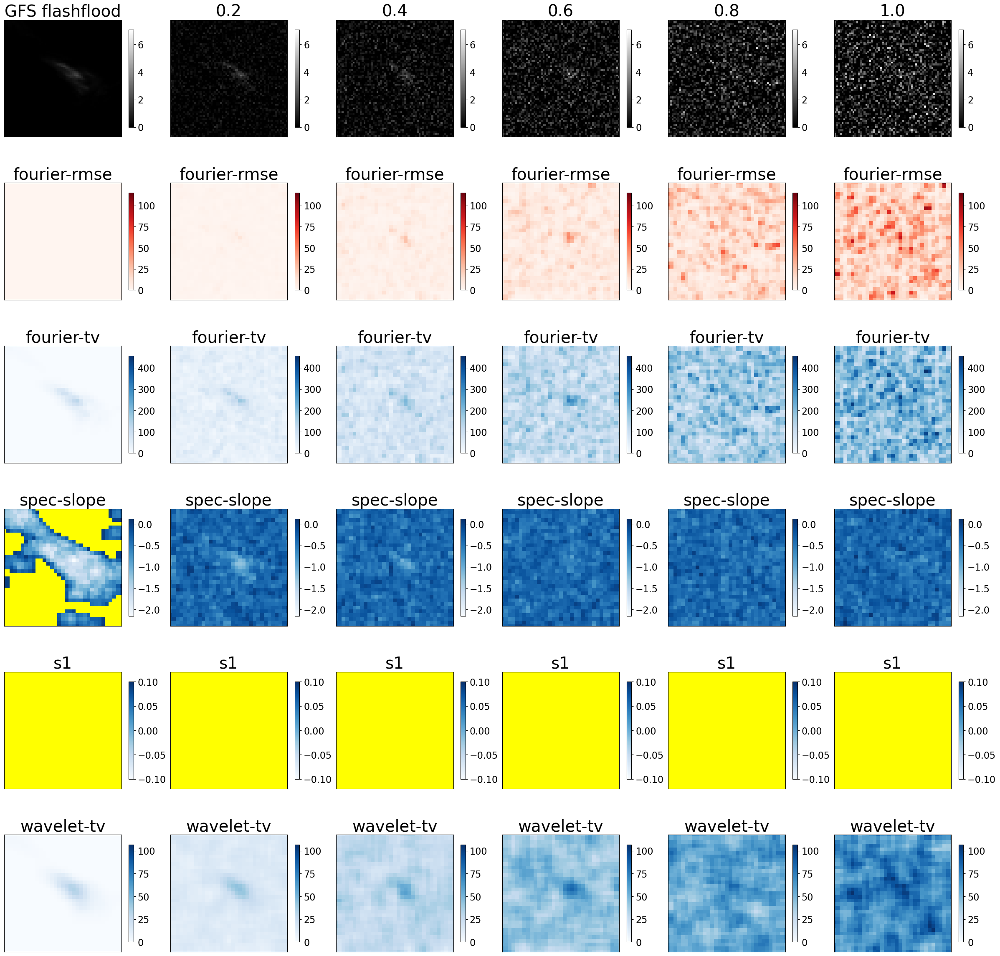


Saving results to ../media/paper_figures/EXP_adding_noise_gradually_starting_with_GFS flashflood_group_3_heatmaps.pdf
Writing summary statistics to file EXP_adding_noise_gradually_starting_with_GFS flashflood_group_3_stats_summary.txt
This file is:  EXP_adding_noise_gradually_starting_with_GFS flashflood_group_3_stats_summary.txt


##### intensity #####

intensity - min:
	GFS flashflood: 0.00
	0.2         : 0.00
	0.4         : 0.00
	0.6         : 0.00
	0.8         : 0.00
	1.0         : 0.00

intensity - mean:
	GFS flashflood: 0.03
	0.2         : 0.18
	0.4         : 0.35
	0.6         : 0.51
	0.8         : 0.69
	1.0         : 0.83

intensity - max:
	GFS flashflood: 2.06
	0.2         : 2.78
	0.4         : 3.02
	0.6         : 4.94
	0.8         : 5.64
	1.0         : 7.06

##### fourier-rmse #####

fourier-rmse - min:
	GFS flashflood: 0.00
	0.2         : 0.03
	0.4         : 0.20
	0.6         : 0.61
	0.8         : 0.94
	1.0         : 0.78

fourier-rmse - mean:
	GFS flashflood: 0.00
	0.2     

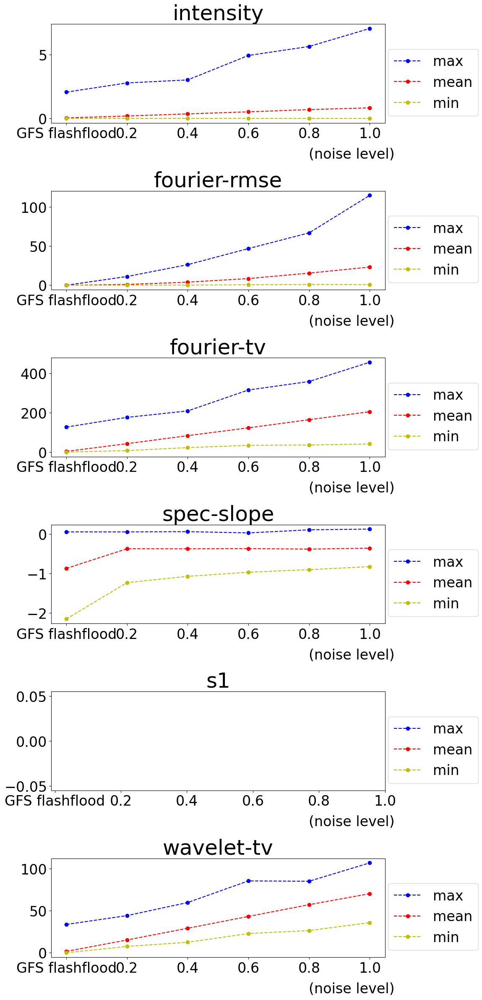

Saving results to EXP_adding_noise_gradually_starting_with_GFS flashflood_group_3_stats_plots.pdf


<Figure size 640x480 with 0 Axes>

In [34]:
# Experiment: GFS experiment - Figures 7-9 of paper

if EXP_GraphCast_GFS_with_CALIBRATION:
    experiment_name = "EXP_GraphCast_GFS_with_C"
    # Acronym below:  GC = GraphCast

    my_dir = "../data/GraphCast_GFS/Large_images/"

    partial_filename_list = [
        "2024012912_f168_atmosriver",
        "2023082912_f024_idalia",
        "2023071712_f048_flashflood",
    ]
    nickname_list = ["atmosriver", "idalia", "flashflood"]

    for i_sample in range(3):
        partial_filename = partial_filename_list[i_sample]
        nickname = nickname_list[i_sample]

        filename_GFS = my_dir + "gfs_" + partial_filename + ".nc"
        filename_GC = my_dir + "grap_" + partial_filename + ".nc"

        dataset_GFS = netCDF4.Dataset(
            filename_GFS
        )  # Open the file using the netCDF4 library
        dataset_GC = netCDF4.Dataset(
            filename_GC
        )  # Open the file using the netCDF4 library
        img_GFS = (
            dataset_GFS["apcp"][:].astype("float64").data
        )  # get 6-hr accumulated precipitation
        img_GC = (
            dataset_GC["apcp"][:].astype("float64").data
        )  # get 6-hr accumulated precipitation

        # img_GFS_string = f'GFS precip {nickname}'
        # img_GC_string  = f'GC  precip {nickname}'

        img_GFS_string = f"GFS {nickname}"
        img_GC_string = f"GC  {nickname}"

        # my_metrics = metric_set_large
        print(nickname)
        print(img_GFS.shape)
        print(img_GC.shape)

        compare_two_images_with_blur_and_noise_experiment(
            img_GFS,
            img_GFS_string,
            img_GC,
            img_GC_string,
            experiment_name=experiment_name,
        )

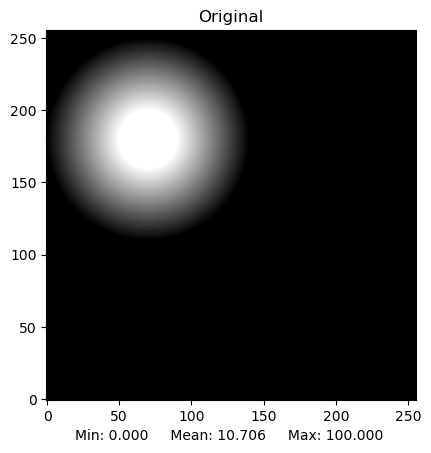

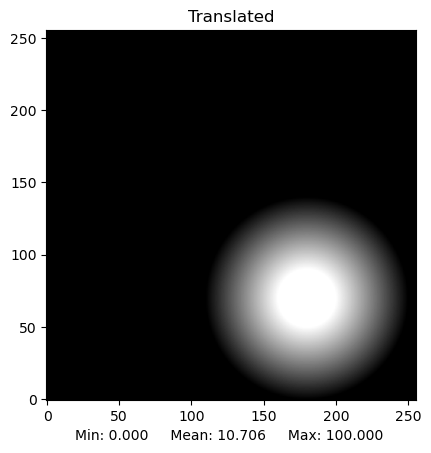

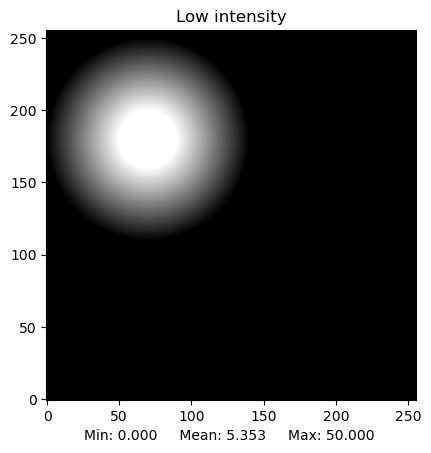

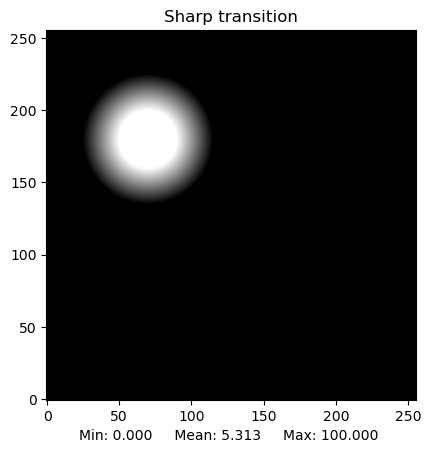

Computing heatmaps for rmse, ssim, tv, grad-mag, grad-tv, grad-rmse, laplace-rmse, fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on Original, Translated

##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.027625055983662605 seconds

Computing ssim
Done! 2 inputs took 0.40169000811874866 seconds

Computing tv
Done! 2 inputs took 0.07569901831448078 seconds

Computing grad-mag
Done! 2 inputs took 0.13017472438514233 seconds

Computing grad-tv
Done! 2 inputs took 0.1193922907114029 seconds

Computing grad-rmse
Done! 2 inputs took 0.11553935706615448 seconds

Computing laplace-rmse
Done! 2 inputs took 0.06004843860864639 seconds

Computing fourier-rmse
Done! 2 inputs took 0.255183519795537 seconds

Computing fourier-tv
Done! 2 inputs took 0.24531319737434387 seconds

Computing spec-slope


/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
43232 NaNs out of 65536 total blocks in image 0
43232 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
43232 NaNs out of 65536 total blocks in image 0
43232 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 3.3199980314821005 seconds

Computing s1
NaNs encountered in s1:
46176 NaNs out of 65536 total blocks in image 0
46176 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
46176 NaNs out of 65536 total blocks in image 0
46176 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 1.0426360983401537 seconds

Computing wavelet-tv
Done! 2 inputs took 0.4131775088608265 seconds

##############################

Plotting figure...



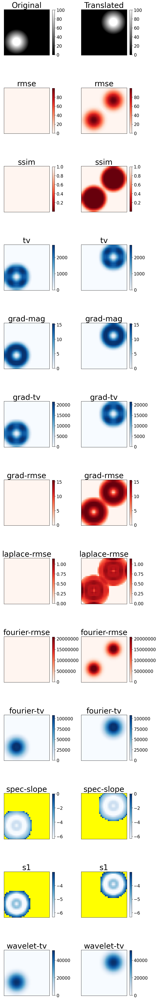


Saving results to ../media/paper_figures/EXP_effect_of_change__Original_Translated_metric_set_large_heatmaps.pdf
Writing summary statistics to file EXP_effect_of_change__Original_Translated_metric_set_large_stats_summary.txt
This file is:  EXP_effect_of_change__Original_Translated_metric_set_large_stats_summary.txt


##### intensity #####

intensity - min:
	Original    : 0.00
	Translated  : 0.00

intensity - mean:
	Original    : 10.71
	Translated  : 10.71

intensity - max:
	Original    : 100.00
	Translated  : 100.00

##### rmse #####

rmse - min:
	Original    : 0.00
	Translated  : 0.00

rmse - mean:
	Original    : 0.00
	Translated  : 21.41

rmse - max:
	Original    : 0.00
	Translated  : 99.77

##### ssim #####

ssim - min:
	Original    : 1.00
	Translated  : 0.00

ssim - mean:
	Original    : 1.00
	Translated  : 0.54

ssim - max:
	Original    : 1.00
	Translated  : 1.00

##### tv #####

tv - min:
	Original    : 0.00
	Translated  : 0.00

tv - mean:
	Original    : 546.57
	Translated  : 546

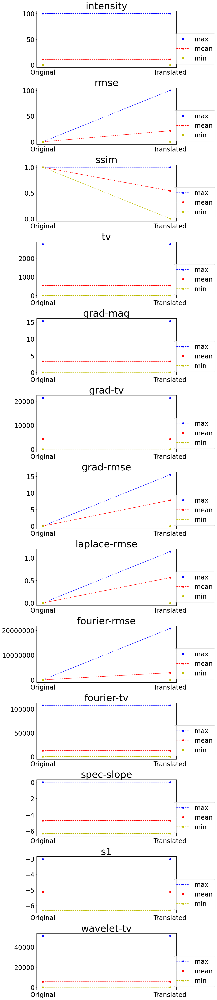

Saving results to EXP_effect_of_change__Original_Translated_metric_set_large_stats_plots.pdf
Computing heatmaps for grad-mag, grad-rmse
on Original, Translated

##############################

Computing grad-mag
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.13096734695136547 seconds

Computing grad-rmse
Done! 2 inputs took 0.11673722229897976 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

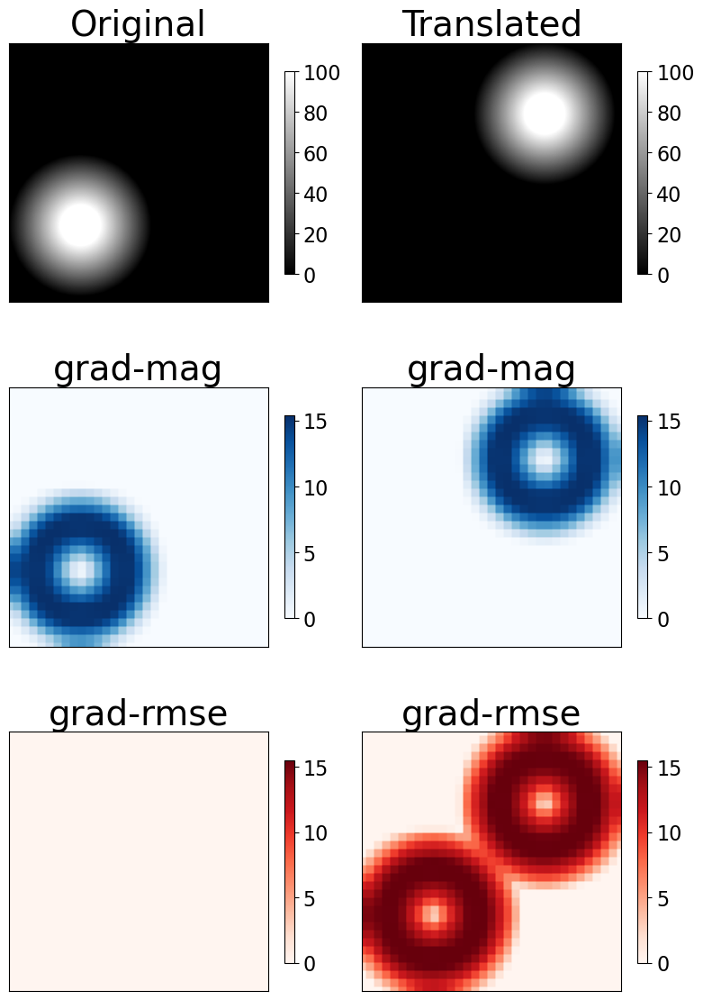


Saving results to ../media/paper_figures/EXP_effect_of_change__Original_Translated_mixed_group_heatmaps.pdf
Writing summary statistics to file EXP_effect_of_change__Original_Translated_mixed_group_stats_summary.txt
This file is:  EXP_effect_of_change__Original_Translated_mixed_group_stats_summary.txt


##### intensity #####

intensity - min:
	Original    : 0.00
	Translated  : 0.00

intensity - mean:
	Original    : 10.71
	Translated  : 10.71

intensity - max:
	Original    : 100.00
	Translated  : 100.00

##### grad-mag #####

grad-mag - min:
	Original    : 0.00
	Translated  : 0.00

grad-mag - mean:
	Original    : 3.30
	Translated  : 3.30

grad-mag - max:
	Original    : 15.38
	Translated  : 15.38

##### grad-rmse #####

grad-rmse - min:
	Original    : 0.00
	Translated  : 0.00

grad-rmse - mean:
	Original    : 0.00
	Translated  : 7.80

grad-rmse - max:
	Original    : 0.00
	Translated  : 15.53



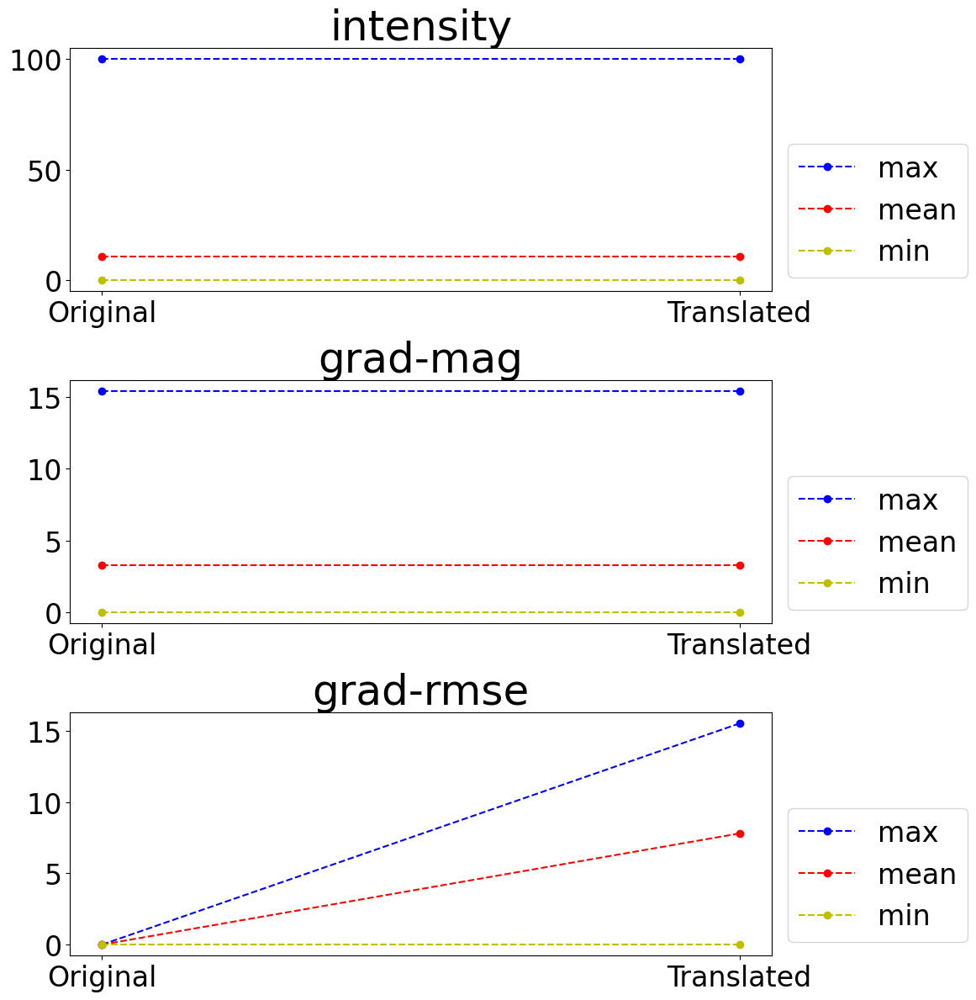

Saving results to EXP_effect_of_change__Original_Translated_mixed_group_stats_plots.pdf
Computing heatmaps for rmse, ssim, tv, grad-mag, grad-tv, grad-rmse, laplace-rmse, fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on Original, Low intensity

##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.029475657269358635 seconds

Computing ssim
Done! 2 inputs took 0.4036515988409519 seconds

Computing tv
Done! 2 inputs took 0.07685820944607258 seconds

Computing grad-mag
Done! 2 inputs took 0.13008589670062065 seconds

Computing grad-tv
Done! 2 inputs took 0.11792824976146221 seconds

Computing grad-rmse
Done! 2 inputs took 0.11635740846395493 seconds

Computing laplace-rmse
Done! 2 inputs took 0.058106498792767525 seconds

Computing fourier-rmse
Done! 2 inputs took 0.25491457246243954 seconds

Computing

/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
43232 NaNs out of 65536 total blocks in image 0
43232 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
43232 NaNs out of 65536 total blocks in image 0
43232 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 3.324042009189725 seconds

Computing s1
NaNs encountered in s1:
46176 NaNs out of 65536 total blocks in image 0
46176 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
46176 NaNs out of 65536 total blocks in image 0
50560 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 0.9805442653596401 seconds

Computing wavelet-tv
Done! 2 inputs took 0.4143426325172186 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

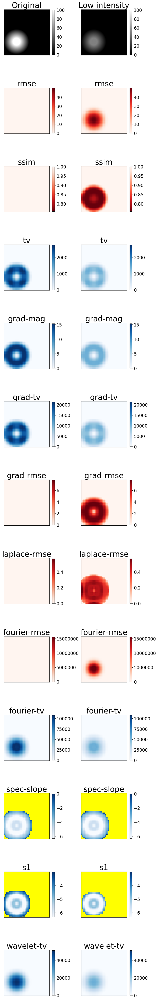


Saving results to ../media/paper_figures/EXP_effect_of_change__Original_Low intensity_metric_set_large_heatmaps.pdf
Writing summary statistics to file EXP_effect_of_change__Original_Low intensity_metric_set_large_stats_summary.txt
This file is:  EXP_effect_of_change__Original_Low intensity_metric_set_large_stats_summary.txt


##### intensity #####

intensity - min:
	Original    : 0.00
	Low intensity: 0.00

intensity - mean:
	Original    : 10.71
	Low intensity: 5.35

intensity - max:
	Original    : 100.00
	Low intensity: 50.00

##### rmse #####

rmse - min:
	Original    : 0.00
	Low intensity: 0.00

rmse - mean:
	Original    : 0.00
	Low intensity: 5.36

rmse - max:
	Original    : 0.00
	Low intensity: 49.88

##### ssim #####

ssim - min:
	Original    : 1.00
	Low intensity: 0.76

ssim - mean:
	Original    : 1.00
	Low intensity: 0.95

ssim - max:
	Original    : 1.00
	Low intensity: 1.00

##### tv #####

tv - min:
	Original    : 0.00
	Low intensity: 0.00

tv - mean:
	Original    : 546.57
	L

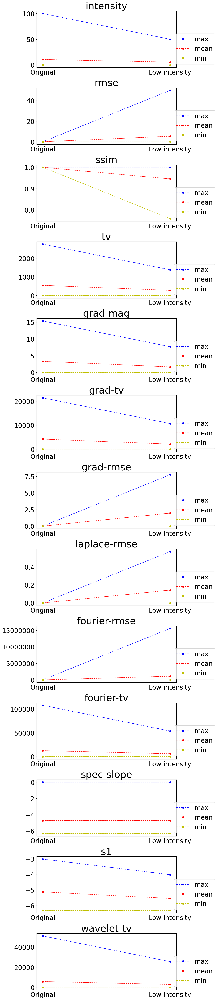

Saving results to EXP_effect_of_change__Original_Low intensity_metric_set_large_stats_plots.pdf
Computing heatmaps for grad-mag, grad-rmse
on Original, Low intensity

##############################

Computing grad-mag
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.13046885840594769 seconds

Computing grad-rmse
Done! 2 inputs took 0.11429968662559986 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

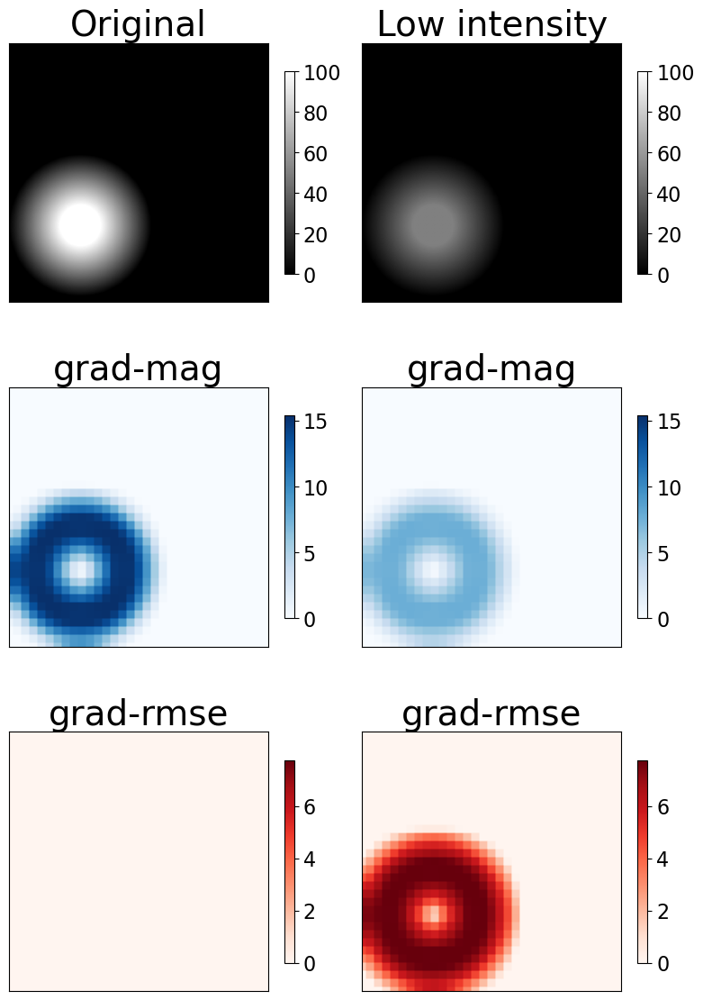


Saving results to ../media/paper_figures/EXP_effect_of_change__Original_Low intensity_mixed_group_heatmaps.pdf
Writing summary statistics to file EXP_effect_of_change__Original_Low intensity_mixed_group_stats_summary.txt
This file is:  EXP_effect_of_change__Original_Low intensity_mixed_group_stats_summary.txt


##### intensity #####

intensity - min:
	Original    : 0.00
	Low intensity: 0.00

intensity - mean:
	Original    : 10.71
	Low intensity: 5.35

intensity - max:
	Original    : 100.00
	Low intensity: 50.00

##### grad-mag #####

grad-mag - min:
	Original    : 0.00
	Low intensity: 0.00

grad-mag - mean:
	Original    : 3.30
	Low intensity: 1.65

grad-mag - max:
	Original    : 15.38
	Low intensity: 7.69

##### grad-rmse #####

grad-rmse - min:
	Original    : 0.00
	Low intensity: 0.00

grad-rmse - mean:
	Original    : 0.00
	Low intensity: 1.96

grad-rmse - max:
	Original    : 0.00
	Low intensity: 7.76



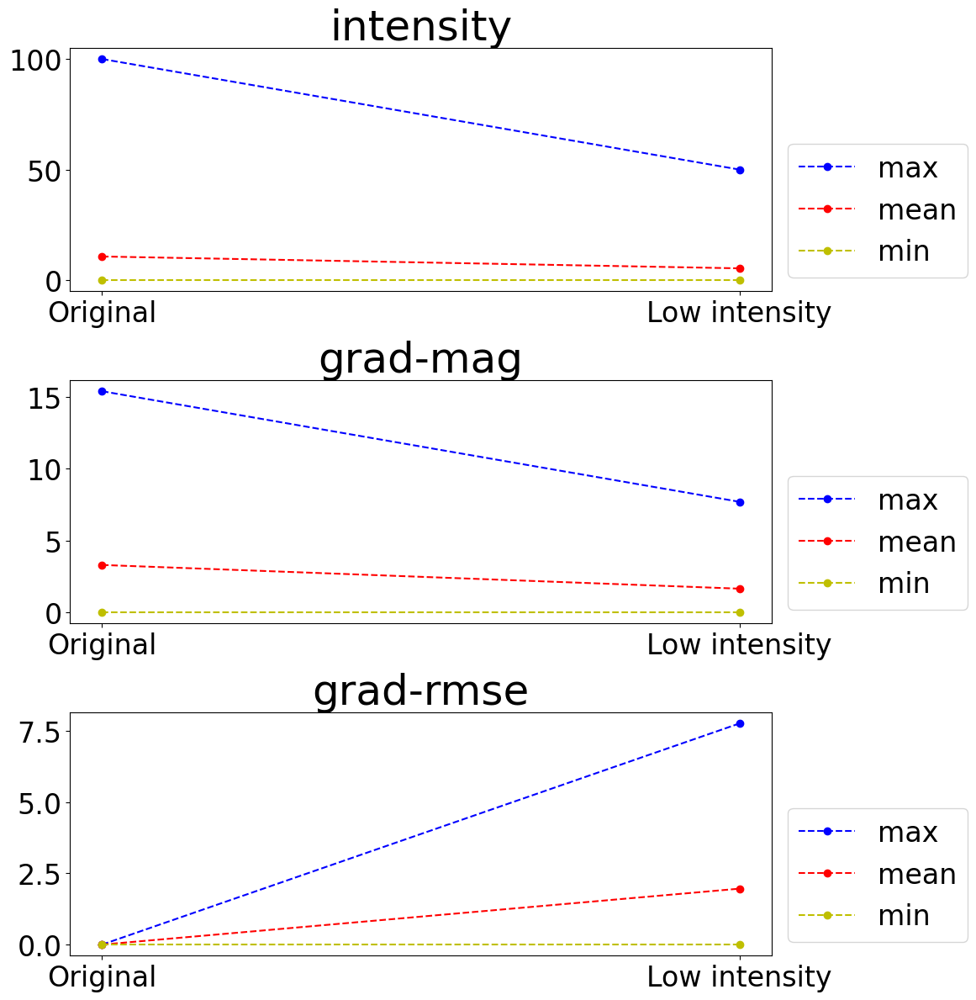

Saving results to EXP_effect_of_change__Original_Low intensity_mixed_group_stats_plots.pdf
Computing heatmaps for rmse, ssim, tv, grad-mag, grad-tv, grad-rmse, laplace-rmse, fourier-rmse, fourier-tv, spec-slope, s1, wavelet-tv
on Original, Sharp transition

##############################

Computing rmse
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.027242090553045273 seconds

Computing ssim
Done! 2 inputs took 0.4029150940477848 seconds

Computing tv
Done! 2 inputs took 0.07450484111905098 seconds

Computing grad-mag
Done! 2 inputs took 0.12899427488446236 seconds

Computing grad-tv
Done! 2 inputs took 0.11784782819449902 seconds

Computing grad-rmse
Done! 2 inputs took 0.11610572040081024 seconds

Computing laplace-rmse
Done! 2 inputs took 0.05984376184642315 seconds

Computing fourier-rmse
Done! 2 inputs took 0.25371014699339867 seconds

Comp

/home/lverhoef/sharpness/src/sharpness/metrics.py:223: RuntimeWarning: divide by zero encountered in log
  line = P.fit(np.log(f), np.log(s), 1)


NaNs encountered in spec_slope:
43232 NaNs out of 65536 total blocks in image 0
43232 NaNs out of 65536 total blocks in image 1
NaNs encountered in spec_slope:
43232 NaNs out of 65536 total blocks in image 0
53440 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 3.334747325628996 seconds

Computing s1
NaNs encountered in s1:
46176 NaNs out of 65536 total blocks in image 0
46176 NaNs out of 65536 total blocks in image 1
NaNs encountered in s1:
46176 NaNs out of 65536 total blocks in image 0
54400 NaNs out of 65536 total blocks in image 1
Done! 2 inputs took 0.9348869472742081 seconds

Computing wavelet-tv
Done! 2 inputs took 0.41277395002543926 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

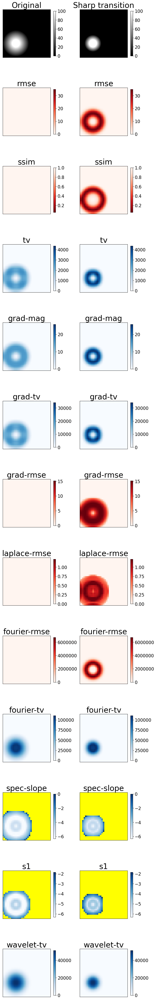


Saving results to ../media/paper_figures/EXP_effect_of_change__Original_Sharp transition_metric_set_large_heatmaps.pdf
Writing summary statistics to file EXP_effect_of_change__Original_Sharp transition_metric_set_large_stats_summary.txt
This file is:  EXP_effect_of_change__Original_Sharp transition_metric_set_large_stats_summary.txt


##### intensity #####

intensity - min:
	Original    : 0.00
	Sharp transition: 0.00

intensity - mean:
	Original    : 10.71
	Sharp transition: 5.31

intensity - max:
	Original    : 100.00
	Sharp transition: 100.00

##### rmse #####

rmse - min:
	Original    : 0.00
	Sharp transition: 0.00

rmse - mean:
	Original    : 0.00
	Sharp transition: 5.40

rmse - max:
	Original    : 0.00
	Sharp transition: 34.90

##### ssim #####

ssim - min:
	Original    : 1.00
	Sharp transition: 0.05

ssim - mean:
	Original    : 1.00
	Sharp transition: 0.84

ssim - max:
	Original    : 1.00
	Sharp transition: 1.00

##### tv #####

tv - min:
	Original    : 0.00
	Sharp transition: 0

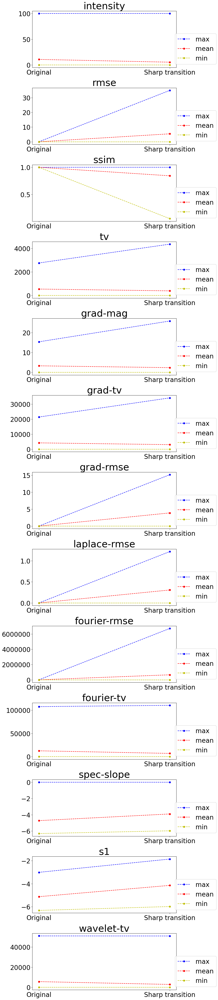

Saving results to EXP_effect_of_change__Original_Sharp transition_metric_set_large_stats_plots.pdf
Computing heatmaps for grad-mag, grad-rmse
on Original, Sharp transition

##############################

Computing grad-mag
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Heatmap will be computed with blocks of size 32, and has image padding of length 16
Done! 2 inputs took 0.1319219134747982 seconds

Computing grad-rmse
Done! 2 inputs took 0.11616053804755211 seconds

##############################

Plotting figure...



<Figure size 640x480 with 0 Axes>

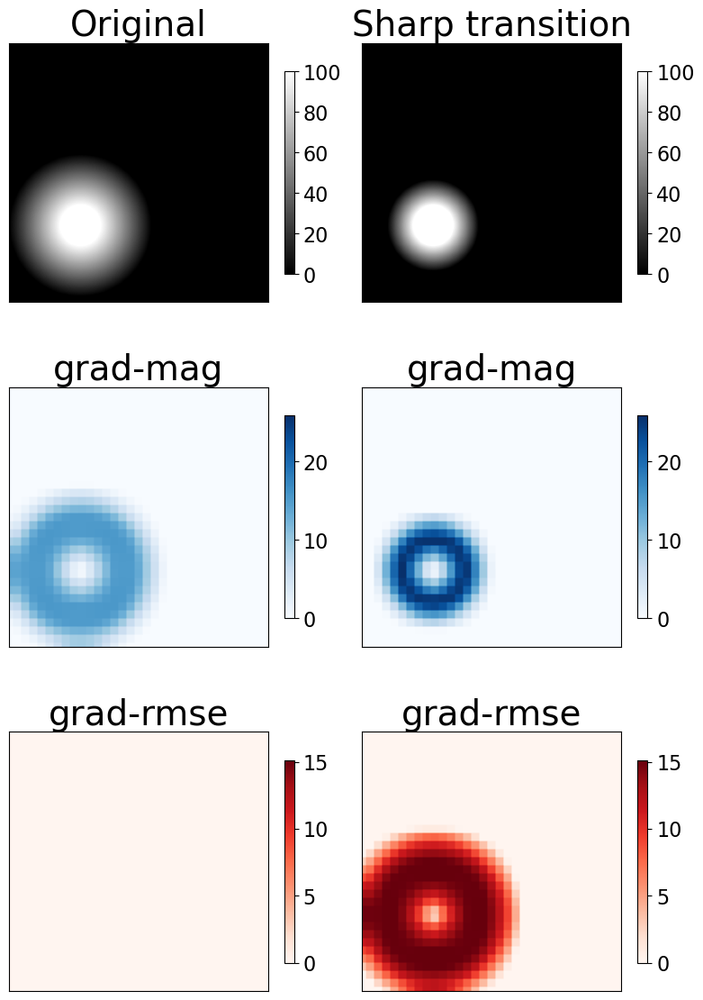


Saving results to ../media/paper_figures/EXP_effect_of_change__Original_Sharp transition_mixed_group_heatmaps.pdf
Writing summary statistics to file EXP_effect_of_change__Original_Sharp transition_mixed_group_stats_summary.txt
This file is:  EXP_effect_of_change__Original_Sharp transition_mixed_group_stats_summary.txt


##### intensity #####

intensity - min:
	Original    : 0.00
	Sharp transition: 0.00

intensity - mean:
	Original    : 10.71
	Sharp transition: 5.31

intensity - max:
	Original    : 100.00
	Sharp transition: 100.00

##### grad-mag #####

grad-mag - min:
	Original    : 0.00
	Sharp transition: 0.00

grad-mag - mean:
	Original    : 3.30
	Sharp transition: 2.38

grad-mag - max:
	Original    : 15.38
	Sharp transition: 25.87

##### grad-rmse #####

grad-rmse - min:
	Original    : 0.00
	Sharp transition: 0.00

grad-rmse - mean:
	Original    : 0.00
	Sharp transition: 3.88

grad-rmse - max:
	Original    : 0.00
	Sharp transition: 15.13



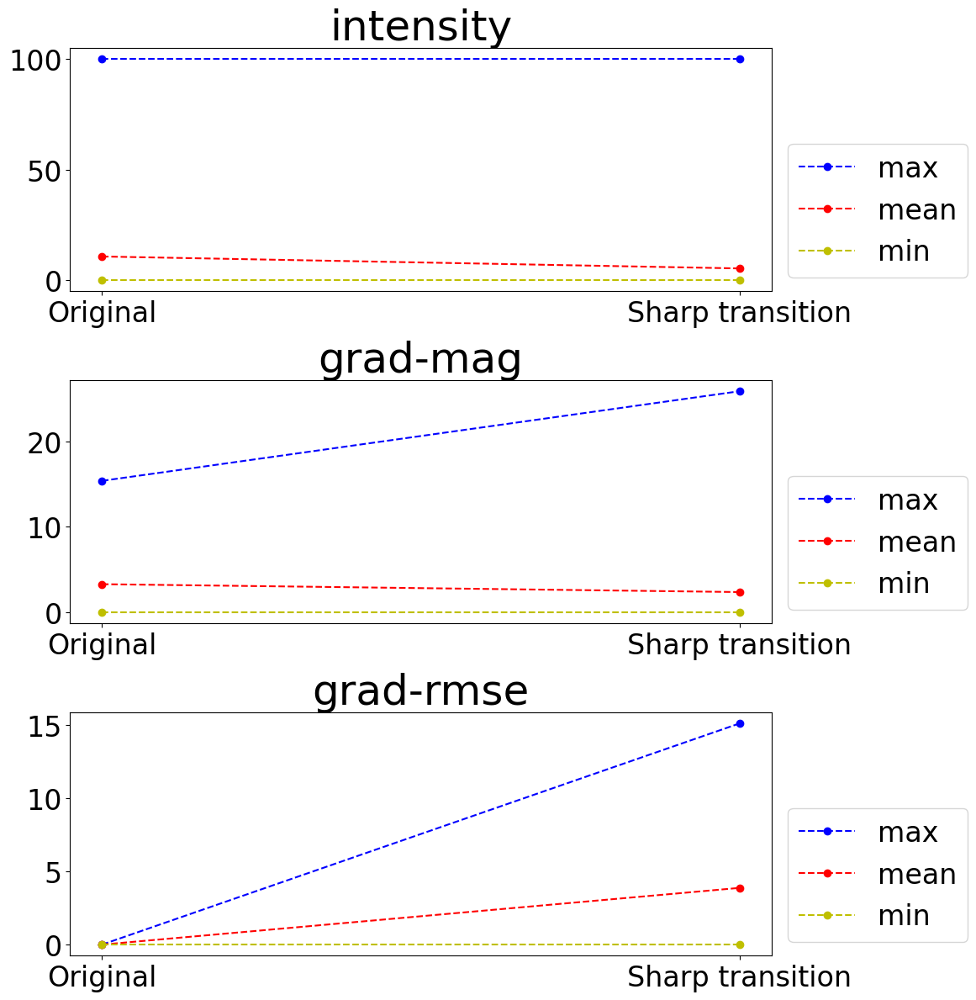

Saving results to EXP_effect_of_change__Original_Sharp transition_mixed_group_stats_plots.pdf


<Figure size 640x480 with 0 Axes>

In [35]:
# Experiments for Fig 12 of paper.
# Create synthetic image:  black background with single Gaussian blob at top left.
# Apply various operations to image:  translate, reduce intensity, sharpen transition
# from white to black.
#

if EXP_change_location_intensity_transition:

    # A few global parameters
    color_map_input_image = "gray"

    ############ CREATE SYNTHETIC IMAGES ###########
    ############ Blank image
    n_pixels = 256
    # img_blank = np.zeros( [n_pixels, n_pixels] )

    # Original blob:  cylinder with linear ramp down
    # blob in top left corner
    center_x = 70
    center_y = 180
    height = 100
    R1 = 20
    alpha = 2
    img_cylinder_with_ramp_original = synthetic_cylinder_with_ramp_down(
        n_pixels, center_x, center_y, height, R1, alpha
    )

    # Location change:  Place blob in different location
    # blob in bottom right corner
    center_x = 180
    center_y = 70
    height = 100
    R1 = 20
    alpha = 2
    img_cylinder_with_ramp_translated = synthetic_cylinder_with_ramp_down(
        n_pixels, center_x, center_y, height, R1, alpha
    )

    # Intensity change:  Take original image and multiply all values by constant
    intensity_factor = 0.5
    img_cylinder_with_ramp_low_intensity = (
        img_cylinder_with_ramp_original * intensity_factor
    )

    # Transition change:  Change slope of down ramp
    # blob with sharper transition
    center_x = 70
    center_y = 180
    height = 100
    R1 = 20
    alpha = 4
    img_cylinder_with_ramp_sharp_transition = synthetic_cylinder_with_ramp_down(
        n_pixels, center_x, center_y, height, R1, alpha
    )

    # store all images and corresponding text in dictionary to be returned
    image_collection_dict = {
        "Cylinder_with_ramp_original": (img_cylinder_with_ramp_original, "Original"),
        "Cylinder_with_ramp_translated": (
            img_cylinder_with_ramp_translated,
            "Translated",
        ),
        "Cylinder_with_ramp_low_intensity": (
            img_cylinder_with_ramp_low_intensity,
            "Low intensity",
        ),
        "Cylinder_with_ramp_sharp_transition": (
            img_cylinder_with_ramp_sharp_transition,
            "Sharp transition",
        ),
    }

    # print all images in collection we created
    for img_counter, (key, (img, img_text)) in enumerate(image_collection_dict.items()):
        plt.figure(img_counter)
        plt.imshow(img, cmap=color_map_input_image, origin="lower")
        plt.title(img_text)
        plt.xlabel(
            f"Min: {img.min():.3f}     Mean: {img.mean():.3f}     Max: {img.max():.3f} "
        )
        plt.show()

    ########## RUN IMAGES THROUGH ANALYSIS ##################

    #  Additional parameters needed for comarison call
    experiment_name = "EXP_effect_of_change_"
    selected_metrics = metric_set_large
    format = "IMAGES_NO_RELATION_SPECIFIED"

    image1_name = "Original"
    image2_name_list = ["Translated", "Low intensity", "Sharp transition"]

    image1_data = img_cylinder_with_ramp_original
    image2_data_list = [
        img_cylinder_with_ramp_translated,
        img_cylinder_with_ramp_low_intensity,
        img_cylinder_with_ramp_sharp_transition,
    ]

    for count in range(3):
        key1 = image1_name
        key2 = image2_name_list[count]
        img_dict = {key1: image1_data, key2: image2_data_list[count]}

        filename_prefix = f"{experiment_name}_{key1}_{key2}"
        filename_prefix_appended = f"{filename_prefix}_metric_set_large"
        compare_images(
            img_dict,
            metric_set_large,
            my_outdir,
            filename_prefix_appended,
            format=format,
            heatmap_metric_cmap_codes=metric_color,
        )

        filename_prefix_appended = f"{filename_prefix}_mixed_group"
        compare_images(
            img_dict,
            metric_set_small,
            my_outdir,
            filename_prefix_appended,
            format=format,
            heatmap_metric_cmap_codes=metric_color,
        )

        # for count, my_selected_metrics in enumerate( [metrics_group_1, metrics_group_2, metrics_group_3] ):
        #
        #    filename_start_appended = f'{filename_start}_group_{count+1}'
        #    compare_images( img_dict, my_selected_metrics, format, filename_start_appended)

In [36]:



####### BELOW THIS LINE: #########

####### Code NOT used for paper #########




In [37]:
if EXP_CALIBRATION:

    experiment_name = "Exp_Calibration"
    key1 = "blank"
    key2 = "noise"

    (img1, img1_string) = image_collection_dict[key1]  # Create blank image
    (img2, img2_string) = image_collection_dict[key2]  # Create image of pure noise

    calibration_img_dict = {
        img1_string: img1,
        img2_string: img2,
    }

    ### Compare images ###
    img_dict = calibration_img_dict
    format = "IMAGES_NO_RELATION_SPECIFIED"
    filename_prefix = f"{experiment_name}_{key1}_{key2}"

    # Uses the three metric groups separately
    results = compare_images_full_protocol(
        img_dict,
        my_outdir,
        filename_prefix,
        format=format,
    )

In [38]:
if EXP_TRANSFORMATIONS:
    # my_image_list = ['ridge']
    # my_image_list = ['ridge', 'blank', 'noise']
    my_image_list = [
        "radar_OBS",
        "radar_NN",
        "satellite",
        "gaussian",
        "sinusoidal",
        "ridge",
        "fractal",
        "blank",
        "noise",
    ]
    # my_image_list = ['radar_OBS']
    my_image_list = ["radar_OBS"]

    for my_image in my_image_list:

        # Use True to use metrics prescribed in call.  Otherwise it goes through all
        # three metric groups and stores results separately.
        TRANSFORMATION_TYPE = "Blur_Image_gradually"  # or "Add_Noise_gradually"
        PARAMETER_MAX = 10.0  # 1.0 for noise
        # selected_metrics = metric_set_large
        selected_metrics = metric_set_small
        results = image_transformation_experiment_w_fetch_base_image(
            image_collection_dict,
            ORIGINAL_IMAGE=my_image,
            i_sample=0,
            TRANSFORMATION_TYPE=TRANSFORMATION_TYPE,
            parameter_max=PARAMETER_MAX,
        )